In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 0) Loding the dataset

In [ ]:
#location of the data 
caption_file = "/content/drive/MyDrive/image_captioning/bangla_dataset/all_annotation.csv"
image_path = '/content/drive/MyDrive/image_captioning/bangla_dataset/final_image_dataset_7468_with_all_RGB/'
# !ls $data_location

In [ ]:
!ls /

bin	 datalab  home	 lib64	opt   run   sys		       tools
boot	 dev	  lib	 media	proc  sbin  tensorflow-1.15.2  usr
content  etc	  lib32  mnt	root  srv   tmp		       var


In [ ]:
#reading the text data 
import pandas as pd
caption_file_ = "/content/drive/MyDrive/image_captioning/bangla_dataset/all_annotation.csv"
df = pd.read_csv(caption_file_)
print("There are {} image to captions".format(len(df)))
df.head(-7)

There are 22404 image to captions


,image,caption
0,10001.jpg,কয়েকজন মহিলা শ্রমিক মাটি কেটে একটি টুকরিতে রা...
1,10001.jpg,পুরুষ এবং মহিলা উভয় শ্রমিক একত্রে কোদাল দিয়ে ম...
2,10001.jpg,মহিলা ও পুরুষ শ্রমিক কোদাল দিয়ে মাটি কাটছে।
3,10002.jpg,অনেকগুলো মহিলা শ্রমিক রাস্তা দিয়ে হেঁটে আসছে।
4,10002.jpg,কয়েকজন মহিলা পোশাক শ্রমিক গল্প করতে করতে একত্র...
...,...,...
22392,17465.jpg,বড় একটি ট্রাক থেকে অনেকগুলো আজ একসাথে ফালানো ...
22393,17465.jpg,একটি কারখানার সামনে কয়েকটি আখ বোঝাই করা ট্রাক...
22394,17465.jpg,চিনি তৈরির জন্য ট্রাকে করে আখ নিয়ে আসা হয়েছে...
22395,17466.jpg,একটি কারখানার ভেতরে কয়েকজন মানুষ চলাচল করছে।


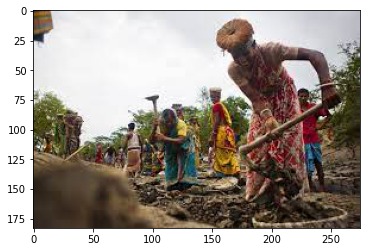

Caption: কয়েকজন মহিলা শ্রমিক মাটি কেটে একটি টুকরিতে রাখছে।
Caption: পুরুষ এবং মহিলা উভয় শ্রমিক একত্রে কোদাল দিয়ে মাটি খনন করে রাস্তা মেরামতের কাজ করছে।
Caption: মহিলা ও পুরুষ শ্রমিক কোদাল দিয়ে মাটি কাটছে।


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#select any index from the whole dataset 
#single image has 5 captions
#so, select indx as: 1,6,11,16...
data_idx = 0

#eg path to be plot: ../input/flickr8k/Images/1000268201_693b08cb0e.jpg
image_path_ = '/content/drive/MyDrive/image_captioning/bangla_dataset/final_image_dataset_7468_with_all_RGB/' +df.iloc[data_idx,0]
img=mpimg.imread(image_path_)
plt.imshow(img)
plt.show()

#image consits of 5 captions,
#showing all 5 captions of the image of the given idx 
for i in range(data_idx,data_idx+3):
    print("Caption:",df.iloc[i,1])


In [ ]:
#imports 
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

from PIL import Image


import string 
import re
from string import punctuation

In [ ]:
# Bangla Tokenizer
class Tokenizers:
	def __init__(self):
		pass

	def bn_word_tokenizer(self, input_):
		tokenize_list = []
		r = re.compile(r'[\s\।{}]+'.format(re.escape(punctuation)))
		list_ = r.split(input_)
		list_ = [i for i in list_ if i] 
		return list_
text = "this is English text"
tokenizer = Tokenizers()
tokenizer.bn_word_tokenizer(text)

['this', 'is', 'English', 'text']

In [ ]:
class Vocabulary:
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        
        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}
        
        self.freq_threshold = freq_threshold
        
    def __len__(self): return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return tokenizer.bn_word_tokenizer(text)
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]

In [ ]:
#testing the vicab class 
v = Vocabulary(freq_threshold=2)

v.build_vocab(["পুরুষ এবং মহিলা উভয় শ্রমিক একত্রে কোদাল দিয়ে মাটি খনন করে রাস্তা মেরামতের কাজ করছে।"])
print(v.stoi)
print(v.numericalize("পুরুষ এবং মহিলা উভয় শ্রমিক একত্রে কোদাল দিয়ে মাটি খনন করে রাস্তা মেরামতের কাজ করছে।!!"))
a = v.numericalize("পুরুষ এবং মহিলা উভয় শ্রমিক একত্রে কোদাল দিয়ে মাটি খনন করে রাস্তা মেরামতের কাজ করছে।!!")

# caption_label = [dataset.vocab.itos[token] for token in a]
# eos_index = caption_label.index('<EOS>')
# caption_label = caption_label[1:eos_index]
# caption_label = ' '.join(caption_label)
# print(caption_label)     


{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3}
[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]


In [ ]:
class FlickrDataset(Dataset):
    """
    FlickrDataset
    """
    def __init__(self,root_dir,captions_file,transform=None,freq_threshold=1):
        self.root_dir = root_dir
        self.df = pd.read_csv(caption_file)
        self.transform = transform
        
        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
        
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [ ]:
#show the tensor image
import matplotlib.pyplot as plt
def show_image(img, title=None):
    """Imshow for Tensor."""
    
    #unnormalize 
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    
    
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
#defining the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),                     
    # T.RandomCrop(224),                 
    T.ToTensor(),                               
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

image shape:  torch.Size([3, 224, 224])
caption shape:  torch.Size([10])


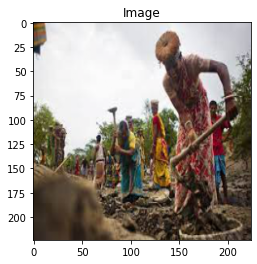

Token: tensor([ 1,  4,  5,  6,  7,  8,  9, 10, 11,  2])
Sentence:
['<SOS>', 'কয়েকজন', 'মহিলা', 'শ্রমিক', 'মাটি', 'কেটে', 'একটি', 'টুকরিতে', 'রাখছে', '<EOS>']


In [ ]:
# this is with frequency 5
 
#testing the dataset class
dataset =  FlickrDataset(
    # root_dir = data_location+"/Images",
    root_dir = image_path,
    captions_file = caption_file,
    transform=transforms
)
 
 
 
img, caps = dataset[0]
print("image shape: ", img.shape)
print("caption shape: ", caps.shape)
show_image(img,"Image")
print("Token:",caps)
print("Sentence:")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [ ]:
# remember: Start
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
    
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)
        
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [ ]:
#writing the dataloader
#setting the constants
 
BATCH_SIZE = 128
NUM_WORKER = 2
 
#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]
 
data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

In [ ]:
# BATCH_SIZE = 264
# NUM_WORKER = 2

In [ ]:
#vocab_size
vocab_size = len(dataset.vocab)
print(vocab_size) # 8872 with freq_thershold = 1
 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

8872


device(type='cuda', index=0)

In [ ]:
# #generating the iterator from the dataloader
# dataiter = iter(data_loader)

# #getting the next batch
# batch = next(dataiter)

# #unpacking the batch
# images, captions = batch

# #showing info of image in single batch
# for i in range(BATCH_SIZE):
#     img,cap = images[i],captions[i]
#     caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
#     eos_index = caption_label.index('<EOS>')
#     caption_label = caption_label[1:eos_index]
#     caption_label = ' '.join(caption_label)
#     print(caption_label)                      
#     show_image(img,caption_label)
#     plt.show()
# print("*"*10000)

### 1) Initial Imports and loading the utils function. The dataset is used is <a href='https://www.kaggle.com/adityajn105/flickr8k'>Flickr 8k</a> from kaggle.<br>Custom dataset and dataloader is implemented in <a href="https://www.kaggle.com/mdteach/torch-data-loader-flicker-8k">this</a> notebook.

In [ ]:
# #location of the training data 
# data_location =  "../input/flickr8k"
# #copy dataloader
# !cp ../input/data-loader/data_loader.py .

# #imports
# import numpy as np
# import torch
# from torch.utils.data import DataLoader,Dataset
# import torchvision.transforms as T

# #custom imports 
# from data_loader import FlickrDataset,get_data_loader

### 2) **<b>Implementing the Helper function to plot the Tensor image**

In [ ]:
 !nvidia-smi

Sun Jul 11 12:07:51 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    32W /  70W |   1388MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### 3) Initiate the Dataset and Dataloader

### 4) Defining the Model Architecture
 
Model is seq2seq model. In the **encoder** pretrained ResNet model is used to extract the features. Decoder, is the implementation of the Bahdanau Attention Decoder. In the decoder model **LSTM cell**.

In [ ]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
 
import torchvision.models as models
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

from tqdm import tqdm

In [ ]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        resnet = models.resnet50(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        
 
    def forward(self, images):
        features = self.resnet(images)                                    #(batch_size,2048,7,7)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1)) #(batch_size,49,2048)
        return features

In [ ]:
#Bahdanau Attention
class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()
        
        self.attention_dim = attention_dim
        
        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)
        
        self.A = nn.Linear(attention_dim,1)
        
        
        
        
    def forward(self, features, hidden_state):
        u_hs = self.U(features)     #(batch_size,num_layers,attention_dim)
        w_ah = self.W(hidden_state) #(batch_size,attention_dim)
        
        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1)) #(batch_size,num_layers,attemtion_dim)
        
        attention_scores = self.A(combined_states)         #(batch_size,num_layers,1)
        attention_scores = attention_scores.squeeze(2)     #(batch_size,num_layers)
        
        
        alpha = F.softmax(attention_scores,dim=1)          #(batch_size,num_layers)
        
        attention_weights = features * alpha.unsqueeze(2)  #(batch_size,num_layers,features_dim)
        attention_weights = attention_weights.sum(dim=1)   #(batch_size,num_layers)
        
        return alpha,attention_weights

In [ ]:
#Attention Decoder
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        
        #save the model param
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)
        
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)
        
        
    
    def forward(self, features, captions):
        
        #vectorize the caption
        embeds = self.embedding(captions)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)
        
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)
                
        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
                    
            output = self.fcn(self.drop(h))
            
            preds[:,s] = output
            alphas[:,s] = alpha  
        
        
        return preds, alphas
    
    def generate_caption(self,features,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        alphas = []
        
        #starting input
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)
 
        
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            
            
            #store the apla score
            alphas.append(alpha.cpu().detach().numpy())
            
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions],alphas
    
    
    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

In [ ]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size = len(dataset.vocab),
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )
        
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

### 5) Setting Hypperparameter and Init the model

In [ ]:
#Hyperparams
embed_size=300
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

In [ ]:
#init model
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)
 
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


In [ ]:
#helper function to save the model
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }
 
    torch.save(model_state,'/content/drive/MyDrive/image_captioning/model/attention_model_state__with_threshold_freq_1__batch_size_128__num_worker_2___2nd.pth')

In [ ]:
#helper function to save the model
def save_model_(model, optimizer, num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'model_state_dict':model.state_dict(),
        'optimizer_state_dict_':optimizer.state_dict()
    }
 
    torch.save(model_state,'/content/drive/MyDrive/image_captioning/model/attention_model_state__with_threshold_freq_1__batch_size_128__num_worker_2____2nd__with_optimizer.pth')

## 5) Training Job from above configs


Here I need to implement the saved model

=====>  Loading Checkpoint




  0%|          | 0/25 [00:00<?, ?it/s]


0it [00:00, ?it/s]


1it [00:05,  5.98s/it]


2it [00:06,  4.47s/it]


3it [00:11,  4.36s/it]


4it [00:11,  3.30s/it]


5it [00:17,  4.00s/it]


6it [00:18,  3.04s/it]


7it [00:23,  3.59s/it]


8it [00:23,  2.75s/it]


9it [00:28,  3.30s/it]

Epoch: 1 loss: 2.64989


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2509 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2487 missing from current font.
  font.set_text(s

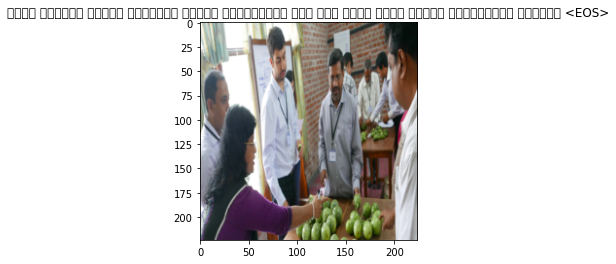




10it [00:42,  6.51s/it]

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে একজন মানুষ দাঁড়িয়ে রয়েছে <EOS>





11it [00:43,  4.88s/it]


12it [00:44,  3.79s/it]


13it [00:48,  3.81s/it]


14it [00:49,  2.96s/it]


15it [00:58,  4.70s/it]


16it [00:59,  3.55s/it]


17it [01:05,  4.41s/it]


18it [01:06,  3.35s/it]


19it [01:11,  3.79s/it]

Epoch: 1 loss: 2.64475


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2455 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2482 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2488 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s

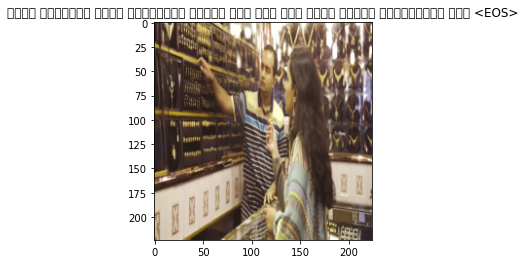




20it [01:22,  6.07s/it]

একটি দোকানের ভেতর অনেকগুলো মানুষ বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>





21it [01:23,  4.53s/it]


22it [01:24,  3.46s/it]


23it [01:29,  3.75s/it]


24it [01:29,  2.88s/it]


25it [01:38,  4.69s/it]


26it [01:39,  3.57s/it]


27it [01:44,  3.85s/it]


28it [01:45,  2.93s/it]


29it [01:51,  3.82s/it]

Epoch: 1 loss: 2.54912


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 0, flags=flags)


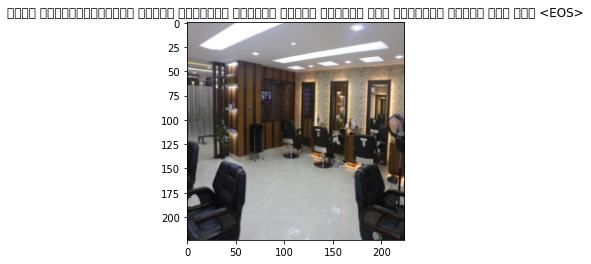




30it [02:02,  6.15s/it]

একটি রেস্টুরেন্টের ভেতরে কয়েকটি চেয়ার টেবিল রয়েছে এবং কয়েকজন মানুষ বসে আছে <EOS>





31it [02:03,  4.62s/it]


32it [02:04,  3.51s/it]


33it [02:10,  4.26s/it]


34it [02:14,  4.16s/it]


35it [02:18,  4.18s/it]


36it [02:23,  4.21s/it]


37it [02:24,  3.32s/it]


38it [02:28,  3.64s/it]


39it [02:30,  3.01s/it]

Epoch: 1 loss: 2.48619


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0, flags=flags)


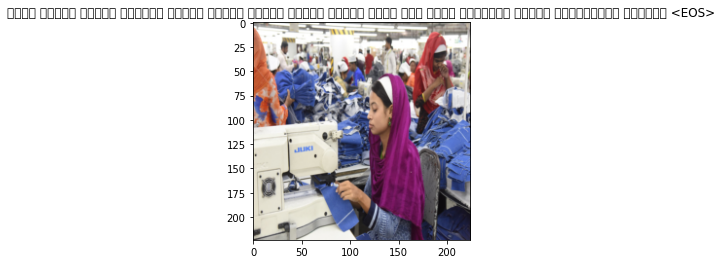




40it [02:46,  7.07s/it]

একজন মহিলা পোশাক শ্রমিক সেলাই মেশিন দিয়ে পোশাক সেলাই করছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>





41it [02:47,  5.25s/it]


42it [02:48,  3.96s/it]


43it [02:49,  3.11s/it]


44it [02:52,  2.94s/it]


45it [02:58,  3.80s/it]


46it [03:01,  3.72s/it]


47it [03:04,  3.45s/it]


48it [03:08,  3.55s/it]


49it [03:10,  3.06s/it]

Epoch: 1 loss: 2.54999


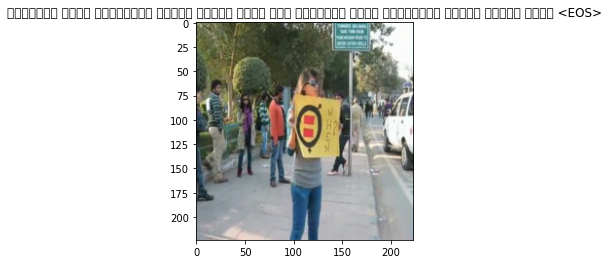




50it [03:26,  6.98s/it]

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে <EOS>





51it [03:27,  5.21s/it]


52it [03:28,  3.91s/it]


53it [03:29,  3.03s/it]


54it [03:34,  3.63s/it]


55it [03:36,  3.17s/it]


56it [03:43,  4.47s/it]


57it [03:44,  3.43s/it]


58it [03:49,  3.66s/it]


59it [03:50,  3.05s/it]

Epoch: 1 loss: 2.50873


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0, flags=flags)


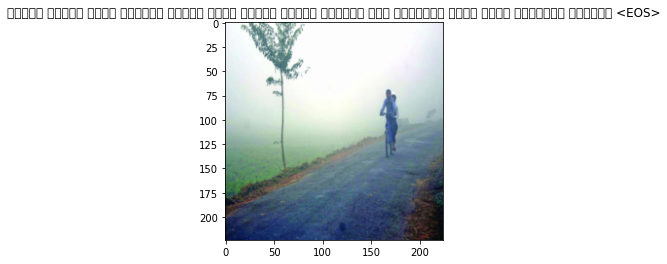




60it [04:06,  6.85s/it]

শীতের সকালে একটি রাস্তা দিয়ে একজন মানুষ হেঁটে যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>





61it [04:07,  5.10s/it]


62it [04:08,  3.82s/it]


63it [04:10,  3.41s/it]


64it [04:12,  3.02s/it]


65it [04:20,  4.35s/it]


66it [04:21,  3.41s/it]


67it [04:26,  3.89s/it]


68it [04:30,  3.87s/it]


69it [04:33,  3.66s/it]

Epoch: 1 loss: 2.49299


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0, flags=flags)


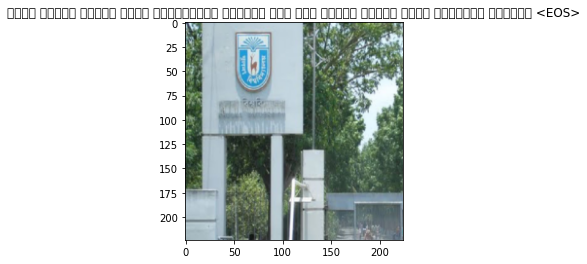




70it [04:47,  6.64s/it]

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ফটকের সামনে কিছু গাছপালা রয়েছে <EOS>





71it [04:48,  4.94s/it]


72it [04:48,  3.72s/it]


73it [04:52,  3.80s/it]


74it [04:53,  2.92s/it]


75it [05:02,  4.65s/it]


76it [05:03,  3.53s/it]


77it [05:09,  4.25s/it]


78it [05:10,  3.26s/it]


79it [05:14,  3.65s/it]

Epoch: 1 loss: 2.46015


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0, flags=flags)


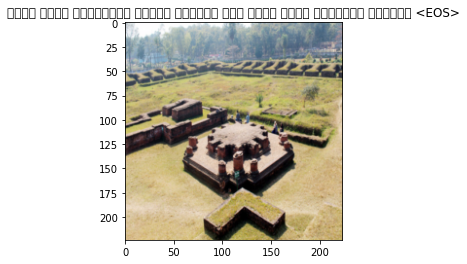




80it [05:32,  7.74s/it]

একটি মাঠে অনেকগুলো মানুষ রয়েছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>





81it [05:33,  5.69s/it]


82it [05:33,  4.25s/it]


83it [05:34,  3.27s/it]


84it [05:39,  3.67s/it]


85it [05:43,  3.75s/it]


86it [05:46,  3.44s/it]


87it [05:51,  3.96s/it]


88it [05:53,  3.38s/it]


89it [05:56,  3.23s/it]

Epoch: 1 loss: 2.61293


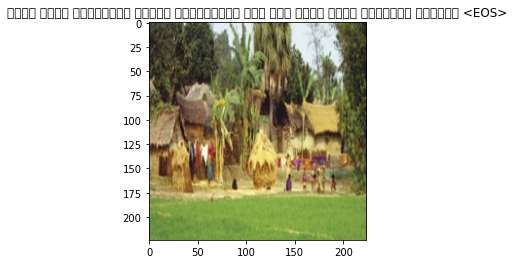




90it [06:09,  6.19s/it]

একটি মাঠে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>





91it [06:10,  4.63s/it]


92it [06:11,  3.56s/it]


93it [06:12,  2.83s/it]


94it [06:21,  4.63s/it]


95it [06:22,  3.51s/it]


96it [06:28,  4.31s/it]


97it [06:29,  3.40s/it]


98it [06:34,  3.84s/it]


99it [06:35,  2.96s/it]

Epoch: 1 loss: 2.47516


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0, flags=flags)


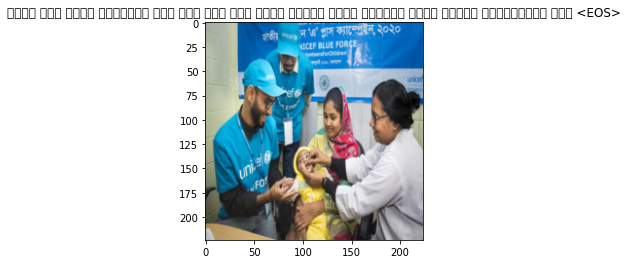




100it [06:48,  6.10s/it]

একজন লোক একটি টেবিলের উপর বসে আছে এবং একজন মহিলা একটি শিশুকে কোলে নিয়ে দাঁড়িয়ে আছে <EOS>





101it [06:49,  4.58s/it]


102it [06:50,  3.45s/it]


103it [06:51,  2.77s/it]


104it [07:00,  4.40s/it]


105it [07:01,  3.37s/it]


106it [07:06,  4.11s/it]


107it [07:08,  3.19s/it]


108it [07:12,  3.47s/it]


109it [07:13,  2.74s/it]

Epoch: 1 loss: 2.50334


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0, flags=flags)


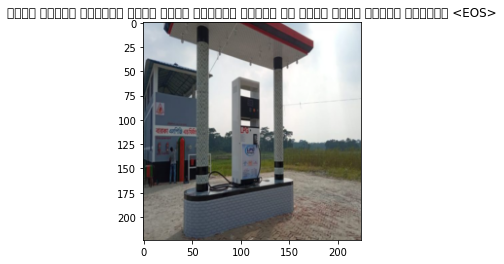




110it [07:28,  6.64s/it]

একটি ফিলিং স্টেশন থেকে একটি ফুয়েল পাম্প এর সাথে একটি গাড়ি রয়েছে <EOS>





111it [07:29,  4.93s/it]


112it [07:30,  3.72s/it]


113it [07:31,  2.88s/it]


114it [07:38,  3.97s/it]


115it [07:43,  4.34s/it]


116it [07:46,  4.01s/it]


117it [07:50,  3.82s/it]


118it [07:52,  3.38s/it]


119it [07:55,  3.17s/it]

Epoch: 1 loss: 2.69460


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f84e07b2050>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.7/multiprocessing/process.py", line 151, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f84e07b2050>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1320, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/pytho

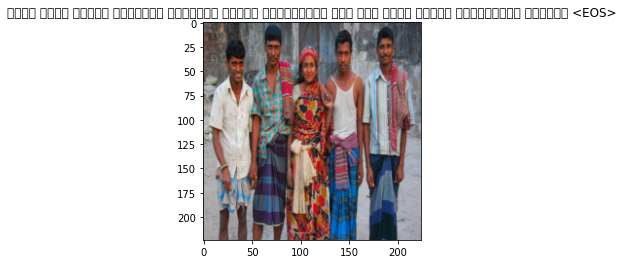




120it [08:10,  6.88s/it]

একটি ঘরের সামনে কয়েকজন আদিবাসী মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে রয়েছে <EOS>





121it [08:11,  5.09s/it]


122it [08:12,  3.84s/it]


123it [08:14,  3.28s/it]


124it [08:18,  3.50s/it]


125it [08:23,  3.93s/it]


126it [08:27,  4.13s/it]


127it [08:30,  3.63s/it]


128it [08:33,  3.45s/it]


129it [08:35,  2.89s/it]

Epoch: 1 loss: 2.58503


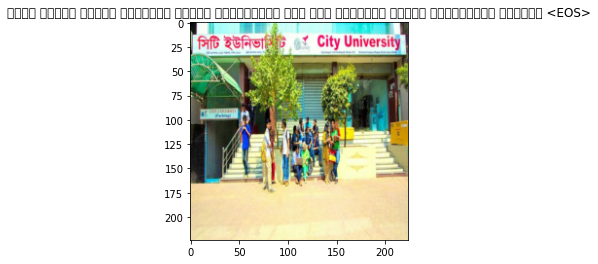




130it [08:51,  7.02s/it]

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>





131it [08:52,  5.25s/it]


132it [08:53,  4.01s/it]


133it [08:54,  3.12s/it]


134it [08:57,  3.00s/it]


135it [09:02,  3.70s/it]


136it [09:07,  3.89s/it]


137it [09:11,  3.88s/it]


138it [09:13,  3.53s/it]


139it [09:15,  3.05s/it]

Epoch: 1 loss: 2.65382


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0, flags=flags)


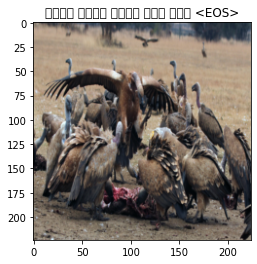




140it [09:31,  6.98s/it]

একটি শকুন পাখি বসে আছে <EOS>





141it [09:33,  5.21s/it]


142it [09:34,  3.93s/it]


143it [09:35,  3.06s/it]


144it [09:36,  2.62s/it]


145it [09:42,  3.74s/it]


146it [09:44,  3.01s/it]


147it [09:51,  4.42s/it]


148it [09:52,  3.37s/it]


149it [09:58,  4.16s/it]

Epoch: 1 loss: 2.62601


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0, flags=flags)


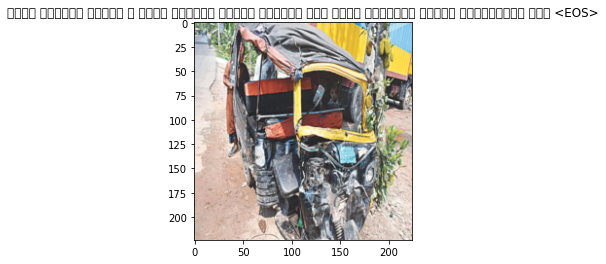




150it [10:09,  6.10s/it]

একটি ভাঙ্গা গাড়ি ও একটি ভাঙ্গা গাড়ি রয়েছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>





151it [10:12,  5.14s/it]


152it [10:13,  3.87s/it]


153it [10:21,  5.12s/it]


154it [10:22,  3.86s/it]


155it [10:27,  4.31s/it]


156it [10:29,  3.52s/it]


157it [10:32,  3.48s/it]


158it [10:35,  3.16s/it]


159it [10:37,  2.85s/it]

Epoch: 1 loss: 2.60164


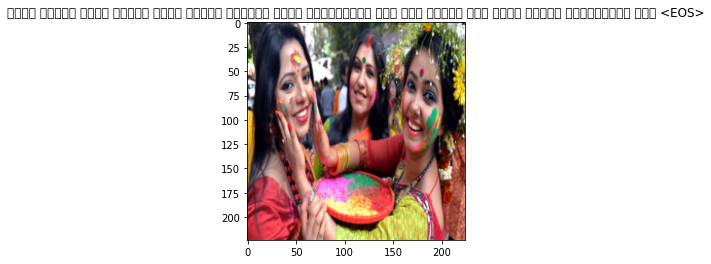




160it [10:52,  6.63s/it]

একজন মহিলা একটি ফুলের মালা দিয়ে সজ্জিত হয়ে দাঁড়িয়ে আছে এবং পেছনে আরও একজন মহিলা দাঁড়িয়ে আছে <EOS>





161it [10:53,  4.92s/it]


162it [10:54,  3.75s/it]


163it [10:55,  2.96s/it]


164it [11:00,  3.36s/it]


165it [11:02,  3.06s/it]


166it [11:08,  4.05s/it]


167it [11:10,  3.43s/it]


168it [11:13,  3.29s/it]


169it [11:15,  2.85s/it]

Epoch: 1 loss: 2.44519


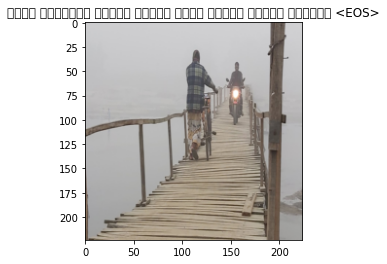




170it [11:32,  7.12s/it]

একটি মসজিদের সামনে দিয়ে একজন মানুষ হেঁটে যাচ্ছে <EOS>





171it [11:33,  5.31s/it]


172it [11:34,  4.01s/it]


173it [11:35,  3.11s/it]


174it [11:39,  3.24s/it]


176it [11:42,  3.99s/it]


AttributeError: ignored

In [ ]:
num_epochs = 25
print_every = 10

saveModel = True
load_model = True

model_path = '/content/drive/MyDrive/image_captioning/model/attention_model_state__with_threshold_freq_1__batch_size_128__num_worker_2.pth'


if load_model:
  print("=====>  Loading Checkpoint")
  model.load_state_dict(torch.load(model_path)['state_dict'])
  # model.load_state_dict(checkpoint)
  model.train()

for epoch in tqdm(range(1,num_epochs+1)):

    for idx, (image, captions) in tqdm(enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)
 
        # Zero the gradients.
        optimizer.zero_grad()
 
        # Feed forward
        outputs,attentions = model(image, captions)
 
        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
 
        # Update the parameters in the optimizer.
        optimizer.step()
 
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                print(caption)
                
            model.train()
        
    #save the latest model
    if saveModel:
        save_model(model,epoch)
        # save_model_(model,epoch, optimizer)

=====>  Loading Checkpoint


0it [00:00, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
9it [03:13, 22.43s/it]

Epoch: 1 loss: 2.59940


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2465 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2492 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2479 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2494 missing from current font.
  font.set_text(s

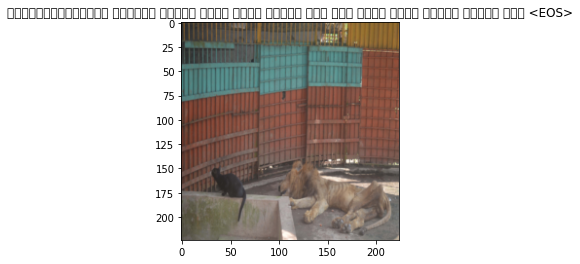

10it [03:53, 27.56s/it]

চিড়িয়াখানায় খাঁচার ভেতরে একটি সিংহ শুয়ে আছে এবং পাশে একটি কুকুর শুয়ে আছে <EOS>


19it [05:58, 16.41s/it]

Epoch: 1 loss: 2.50768


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2509 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2482 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2470 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2460 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2478 missing from current font.
  font.set_text(s

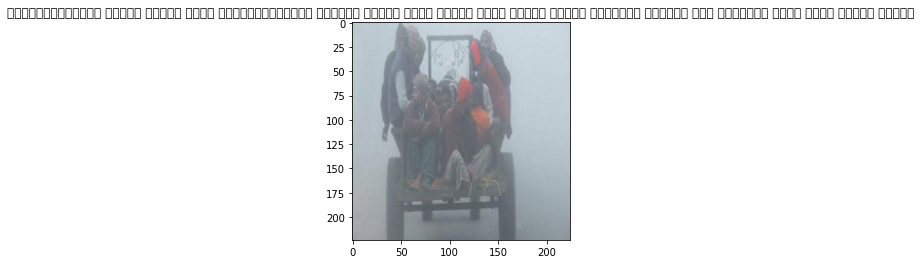

20it [06:36, 22.77s/it]

কুয়াশাচ্ছন্ন শীতের সকালে একটি কুয়াশাচ্ছন্ন রাস্তা দিয়ে একজন মানুষ একটি ভ্যান গাড়ি চালিয়ে যাচ্ছে এবং রাস্তার পাশে একটি ভ্যান গাড়ি


29it [08:19, 13.65s/it]

Epoch: 1 loss: 2.60622


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0, flags=flags)


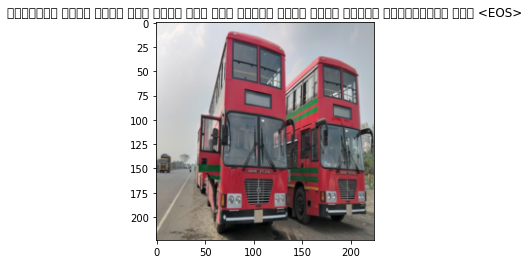

30it [08:58, 21.29s/it]

রাস্তার পাশে একটি বাস থেমে আছে এবং বাসের পাশে একজন মানুষ দাঁড়িয়ে আছে <EOS>


39it [10:23, 11.92s/it]

Epoch: 1 loss: 2.55867


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0, flags=flags)


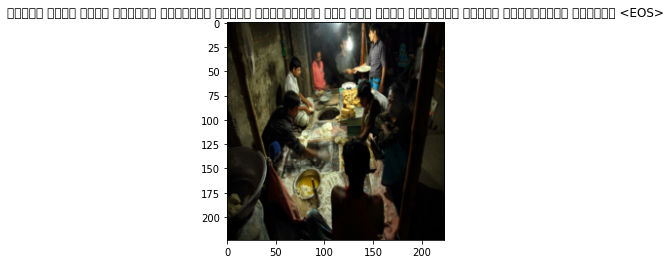

40it [10:49, 16.08s/it]

রাতের বেলা একটি দোকানে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>


49it [12:12, 11.76s/it]

Epoch: 1 loss: 2.66062


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0, flags=flags)


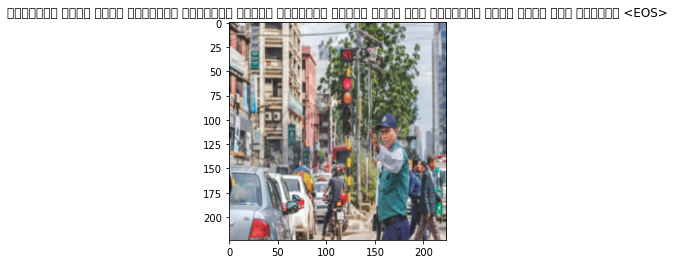

50it [12:29, 13.27s/it]

রাস্তার পাশে একটি ট্রাফিক পয়েন্ট দিয়ে যানবাহন চলাচল করছে এবং রাস্তার পাশে একটি ভবন রয়েছে <EOS>


59it [13:40, 10.01s/it]

Epoch: 1 loss: 2.61763


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0, flags=flags)


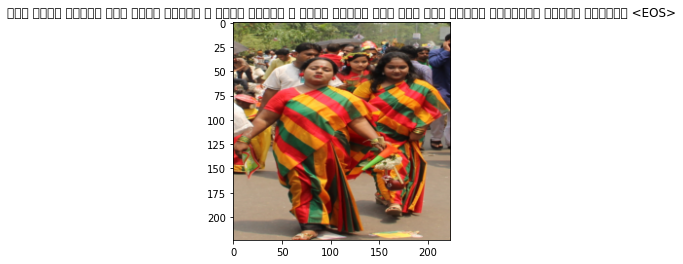

60it [13:54, 11.25s/it]

লাল রঙের শাড়ি পরা একজন মহিলা ও একজন মহিলা ও একজন মহিলা বসে আছে এবং পেছনে কয়েকজন মানুষ রয়েছে <EOS>


69it [14:46,  7.63s/it]

Epoch: 1 loss: 2.76233


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0, flags=flags)


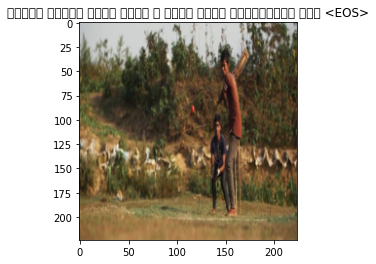

70it [15:01,  9.78s/it]

মাঠের মধ্যে একজন ছেলে ও একজন ছেলে দাঁড়িয়ে আছে <EOS>


79it [15:49,  6.48s/it]

Epoch: 1 loss: 2.64350


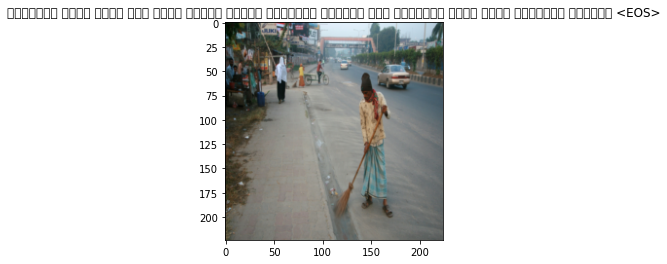

80it [16:00,  7.99s/it]

রাস্তার পাশে একজন লোক একটি ভ্যান গাড়ি চালিয়ে যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>


89it [16:38,  4.85s/it]

Epoch: 1 loss: 2.65878


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0, flags=flags)


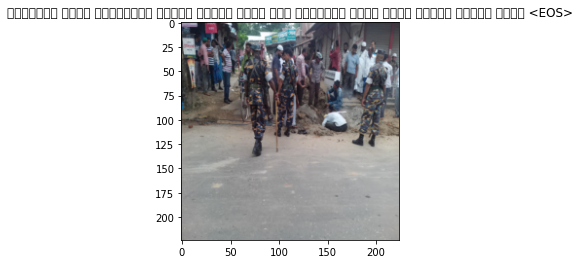

90it [16:49,  6.63s/it]

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে কিছু মানুষ চলাচল করছে <EOS>


99it [17:27,  4.84s/it]

Epoch: 1 loss: 2.70320


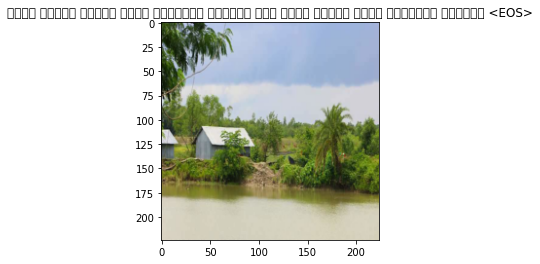

100it [17:39,  6.76s/it]

একটি খালের পাড়ে কিছু গাছপালা রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>


109it [18:13,  3.98s/it]

Epoch: 1 loss: 2.71182


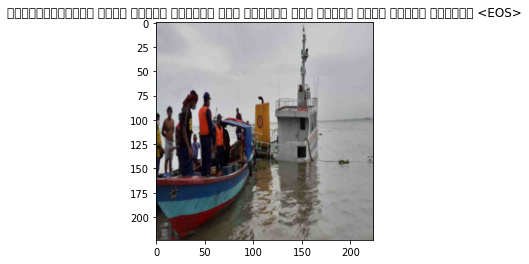

110it [18:23,  5.87s/it]

কোস্টগার্ডের একটি জাহাজ নোঙ্গর করা রয়েছে এবং পিছনে একটি জাহাজ রয়েছে <EOS>


119it [18:55,  3.93s/it]

Epoch: 1 loss: 2.70593


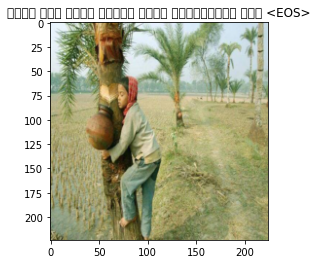

120it [19:07,  6.15s/it]

একজন লোক একটি গাছের নিচে দাঁড়িয়ে আছে <EOS>


129it [19:37,  4.17s/it]

Epoch: 1 loss: 2.55443


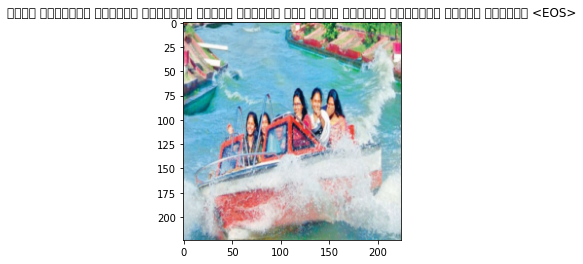

130it [19:49,  6.55s/it]

একটি পার্কের পানিতে কয়েকজন মানুষ রয়েছে এবং নদীর পানিতে কয়েকজন মানুষ রয়েছে <EOS>


139it [20:20,  3.90s/it]

Epoch: 1 loss: 2.65246


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0, flags=flags)


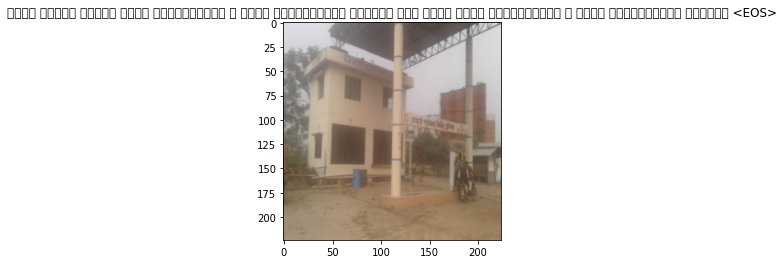

140it [20:32,  6.09s/it]

একটি ভবনের সামনে একটি মোটরসাইকেল ও একটি মোটরসাইকেল রয়েছে এবং পাশে একটি মোটরসাইকেল ও একটি মোটরসাইকেল রয়েছে <EOS>


149it [20:59,  3.65s/it]

Epoch: 1 loss: 2.62445


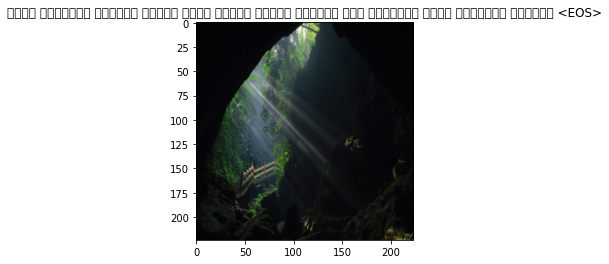

150it [21:12,  6.47s/it]

একটি পাহাড়ি রাস্তা দিয়ে একজন মানুষ হেঁটে যাচ্ছে এবং রাস্তার পাশে গাছপালা রয়েছে <EOS>


159it [21:38,  3.45s/it]

Epoch: 1 loss: 2.71628


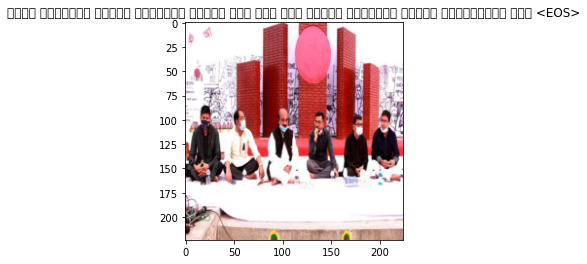

160it [21:51,  6.31s/it]

শহীদ মিনারের সামনে কয়েকজন মানুষ বসে আছে এবং সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>


169it [22:16,  3.57s/it]

Epoch: 1 loss: 2.56782


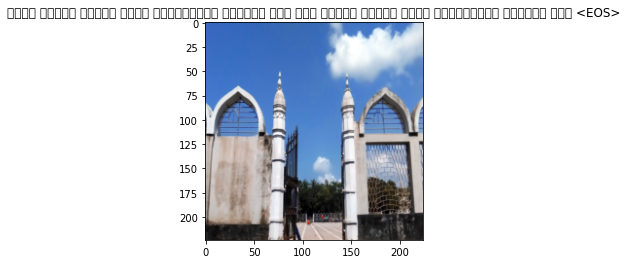

170it [22:28,  5.88s/it]

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>


176it [22:41,  7.73s/it]


TypeError: ignored

In [ ]:
num_epochs = 25
print_every = 10

saveModel = True
load_model = True

model_path = '/content/drive/MyDrive/image_captioning/model/attention_model_state__with_threshold_freq_1__batch_size_128__num_worker_2.pth'


if load_model:
  print("=====>  Loading Checkpoint")
  model.load_state_dict(torch.load(model_path)['state_dict'])
  # model.load_state_dict(checkpoint)
  model.train()

for epoch in range(1,num_epochs+1):

    for idx, (image, captions) in tqdm(enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)
 
        # Zero the gradients.
        optimizer.zero_grad()
 
        # Feed forward
        outputs,attentions = model(image, captions)
 
        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
 
        # Update the parameters in the optimizer.
        optimizer.step()
 
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                print(caption)
                
            model.train()
        
    #save the latest model
    if saveModel:
        save_model(model,epoch)
        save_model_(model,epoch, optimizer)

Epoch: 1 loss: 7.39642


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 

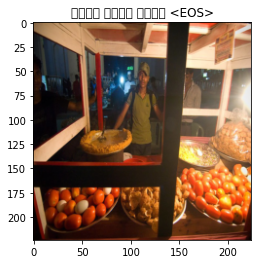

একটি একটি একটি <EOS>
Epoch: 1 loss: 6.24521


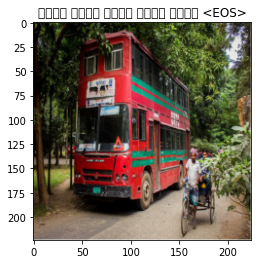

একটি একটি একটি একটি একটি <EOS>
Epoch: 1 loss: 5.99917


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2476 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2434 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2476 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2434 missing from current font.
  font.set_text(s, 0, flags=flags)


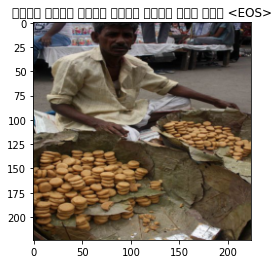

একটি একটি একটি একটি একটি এবং এবং <EOS>
Epoch: 1 loss: 5.87380


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0, flags=flags)


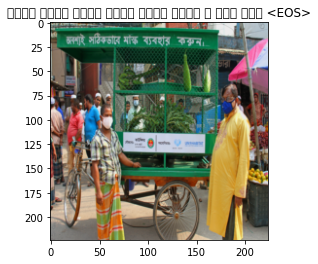

একটি একটি একটি একটি একটি একটি ও এবং এবং <EOS>
Epoch: 1 loss: 5.85305


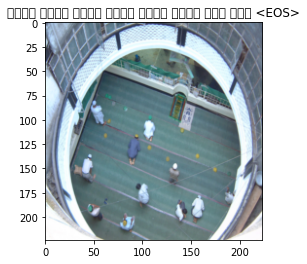

একটি একটি একটি একটি একটি একটি এবং এবং <EOS>
Epoch: 1 loss: 5.83660


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2438 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2459 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2503 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2438 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2459 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2503 missing from current font.
  font.set_text(s, 0,

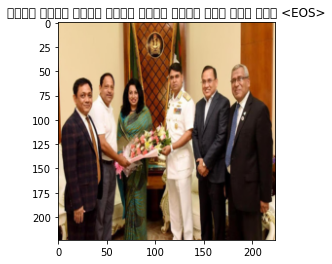

একটি একটি একটি একটি একটি একটি এবং এবং আছে <EOS>
Epoch: 1 loss: 5.68445


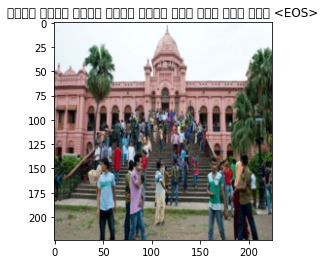

একটি একটি একটি একটি একটি এবং এবং এবং এবং <EOS>
Epoch: 1 loss: 5.77486


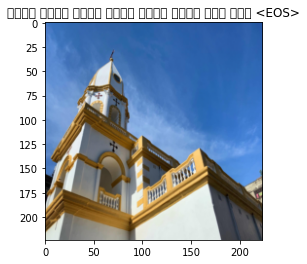

একটি একটি একটি একটি একটি একটি এবং আছে <EOS>
Epoch: 1 loss: 5.67824


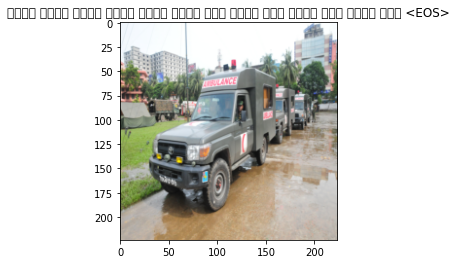

একটি একটি একটি একটি একটি একটি এবং একটি এবং একটি এবং একটি আছে <EOS>
Epoch: 1 loss: 5.52579


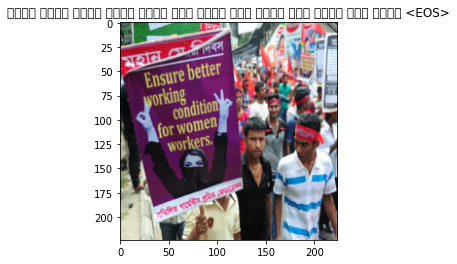

একটি একটি একটি একটি একটি এবং একটি এবং একটি এবং একটি এবং একটি <EOS>
Epoch: 1 loss: 5.51533


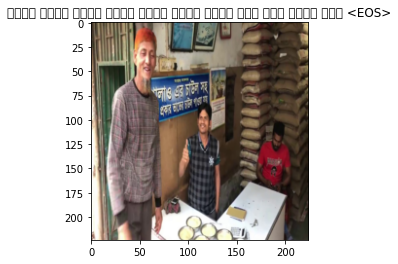

একটি একটি একটি একটি একটি একটি একটি আছে এবং একটি আছে <EOS>
Epoch: 1 loss: 5.40144


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2477 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2480 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2488 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2494 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2478 missing from current font.
  font.set_text(s

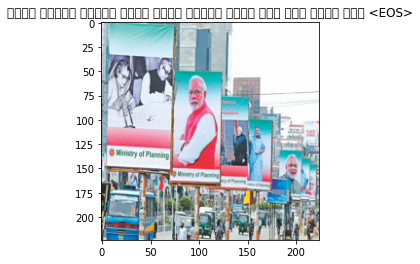

একটি ভবনের সামনে একটি একটি সামনে একটি আছে এবং একটি আছে <EOS>
Epoch: 1 loss: 5.46513


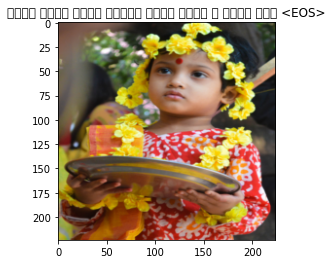

একটি একটি একটি সামনে একটি একটি ও একটি আছে <EOS>
Epoch: 1 loss: 5.45719


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2486 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2479 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2509 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s

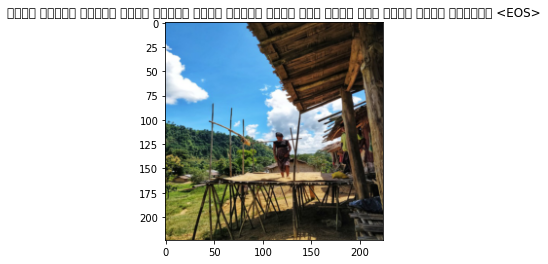

একটি ভবনের সামনে একটি সামনে একটি সামনে একটি এবং একটি এবং পাশে একটি যাচ্ছে <EOS>
Epoch: 1 loss: 5.37146


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2497 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2487 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2470 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2433 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2465 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2492 missing from current font.
  font.set_text(s

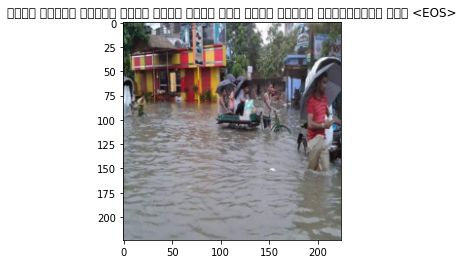

একটি ভবনের সামনে একটি একটি একটি এবং একটি মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 1 loss: 5.27693


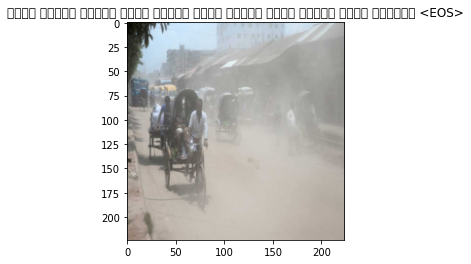

একটি ভবনের সামনে একটি দিয়ে একটি দিয়ে একটি দিয়ে একটি যাচ্ছে <EOS>
Epoch: 1 loss: 5.19879


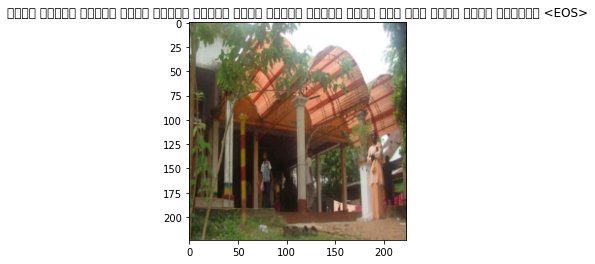

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি আছে এবং পাশে একটি রয়েছে <EOS>
Epoch: 2 loss: 5.02929


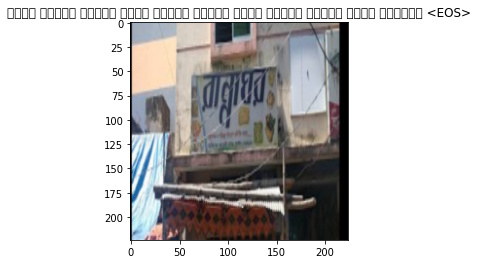

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি রয়েছে <EOS>
Epoch: 2 loss: 5.10066


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2460 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2460 missing from current font.
  font.set_text(s, 0, flags=flags)


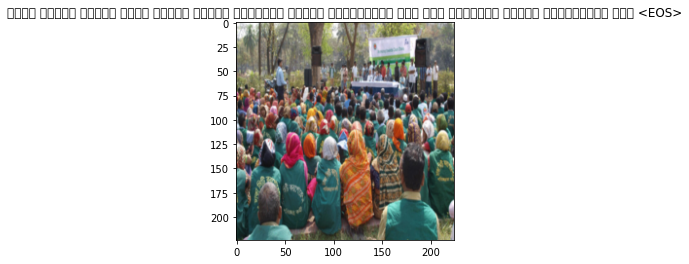

একটি ভবনের সামনে একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 5.15314


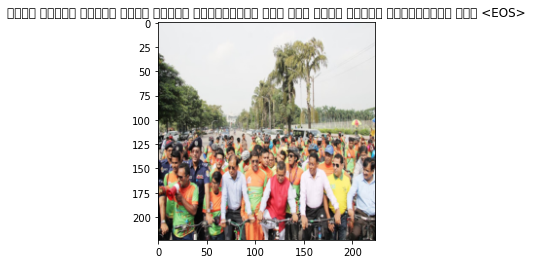

একটি ভবনের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 5.08187


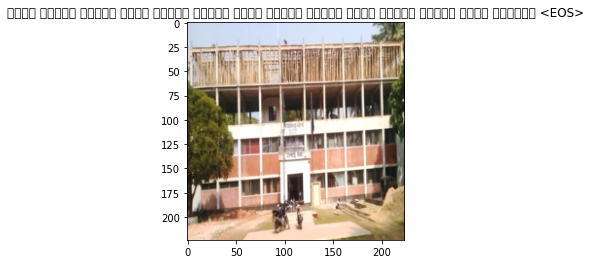

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি রয়েছে <EOS>
Epoch: 2 loss: 5.02872


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2482 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2482 missing from current font.
  font.set_text(s, 0, flags=flags)


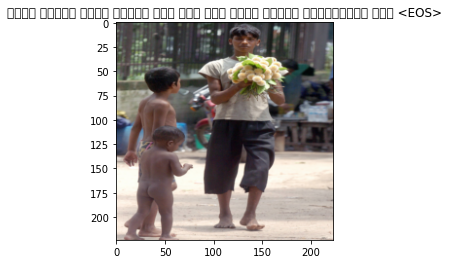

একজন মহিলা একটি মেয়ে বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.84899


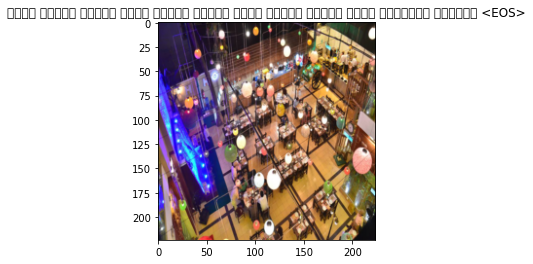

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি ব্যানার রয়েছে <EOS>
Epoch: 2 loss: 4.86732


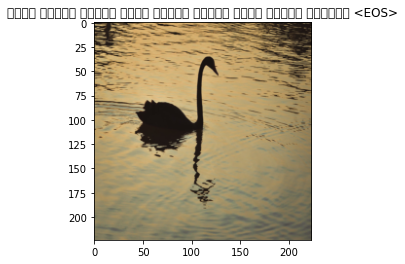

একটি ভবনের সামনে একটি ভবনের সামনে একটি মানুষ রয়েছে <EOS>
Epoch: 2 loss: 4.75314


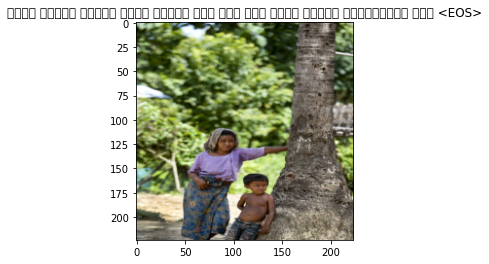

একটি ভবনের সামনে একজন মহিলা বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.93994


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0, flags=flags)


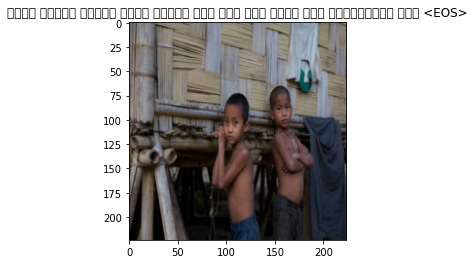

একটি ভবনের সামনে একজন মহিলা বসে আছে এবং একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.78430


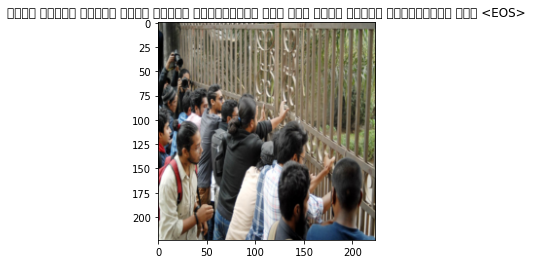

একটি ভবনের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.69382


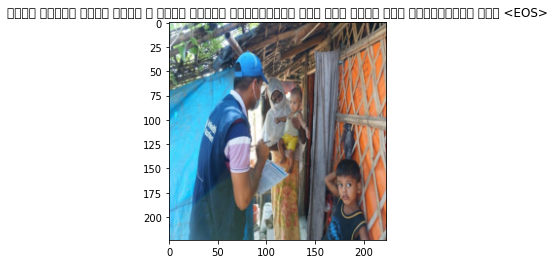

একজন মহিলা একটি ছেলে ও একজন মহিলা দাঁড়িয়ে আছে এবং একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.77096


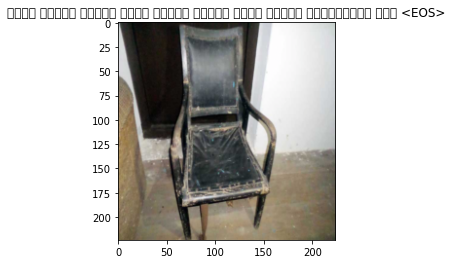

একটি ভবনের সামনে একটি ভবনের সামনে একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.60957


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0, flags=flags)


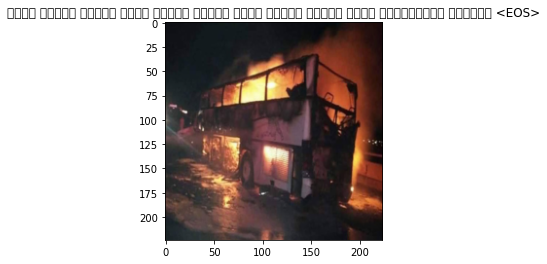

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 2 loss: 4.66691


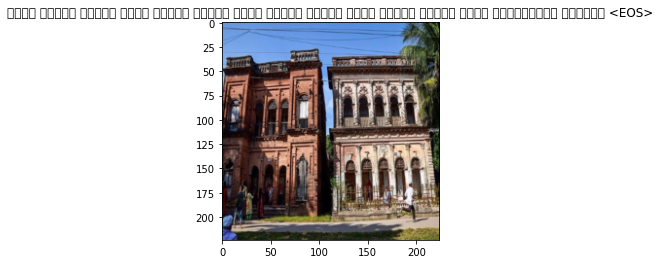

একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 2 loss: 4.70164


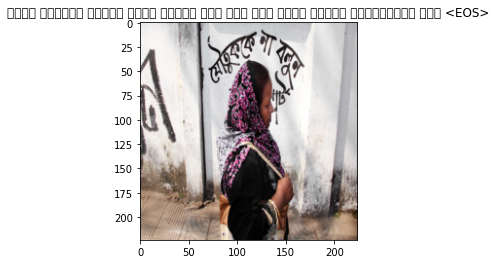

একটি কক্ষের সামনে একজন মহিলা বসে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 2 loss: 4.54966


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2455 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2455 missing from current font.
  font.set_text(s, 0,

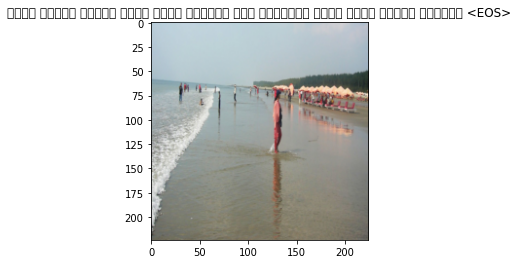

একটি ভবনের সামনে একটি নৌকা রয়েছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 2 loss: 4.41768


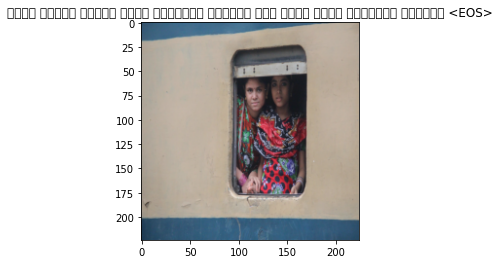

একটি ভবনের সামনে একটি ব্যানার রয়েছে এবং পাশে একটি ব্যানার রয়েছে <EOS>
Epoch: 3 loss: 4.44716


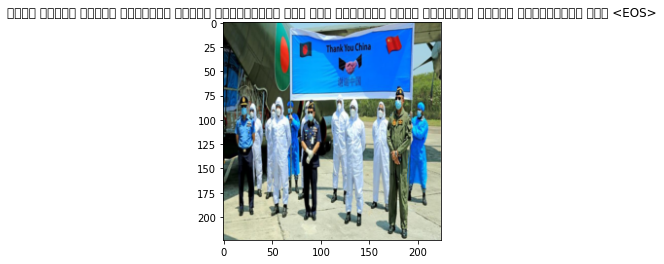

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং রাস্তার পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 3 loss: 4.58105


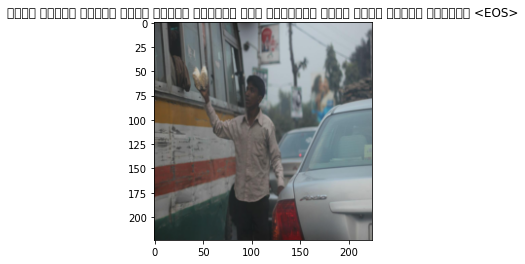

একটি ভবনের সামনে একটি গাড়ি রয়েছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 3 loss: 4.31857


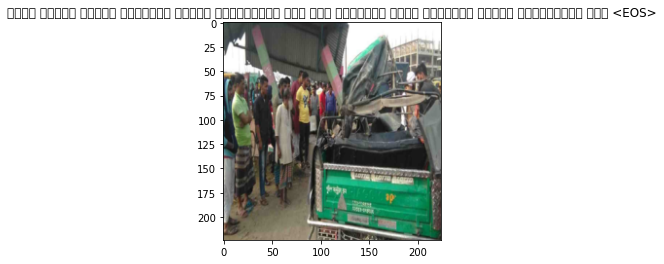

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং রাস্তার পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 3 loss: 4.64205


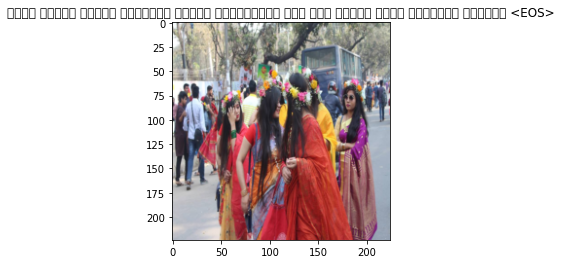

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 3 loss: 4.40795


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0, flags=flags)


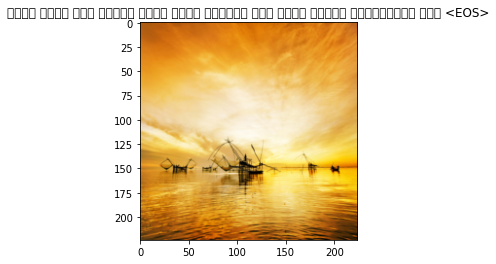

একটি নদীর উপর দিয়ে একটি নৌকা রয়েছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 3 loss: 4.50862


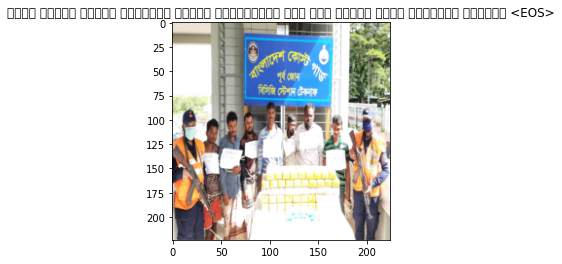

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 3 loss: 4.28757


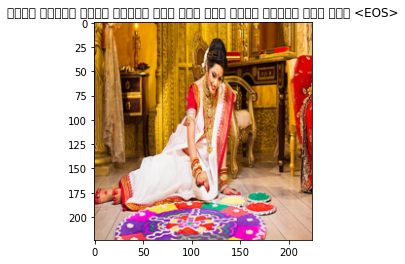

একজন মহিলা একটি মেয়ে বসে আছে এবং একজন মহিলা বসে আছে <EOS>
Epoch: 3 loss: 4.37609


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2461 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2461 missing from current font.
  font.set_text(s, 0, flags=flags)


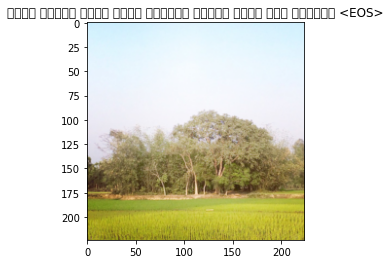

একটি গাছের মাঝে একটি রাস্তা দিয়ে একটি গাছ রয়েছে <EOS>
Epoch: 3 loss: 4.39954


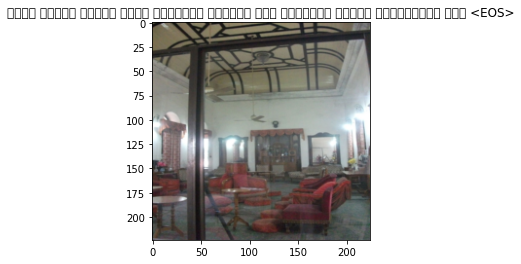

একটি ভবনের সামনে একটি ব্যানার রয়েছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 3 loss: 4.35122


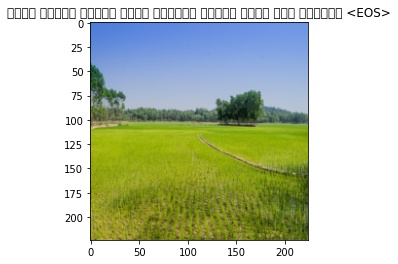

একটি গাছের সামনে একটি রাস্তা দিয়ে একটি গাছ রয়েছে <EOS>
Epoch: 3 loss: 4.18620


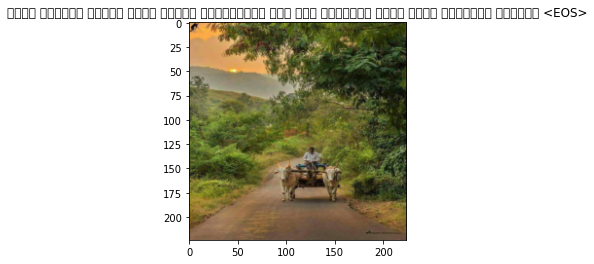

একটি রাস্তা দিয়ে একজন মানুষ দাঁড়িয়ে আছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 3 loss: 4.29714


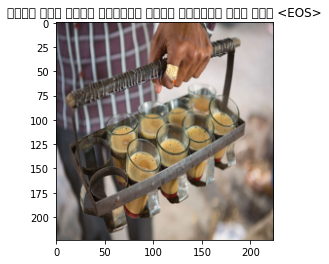

একজন লোক একটি পাত্রে একটি পাত্রে বসে আছে <EOS>
Epoch: 3 loss: 4.30457


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0, flags=flags)


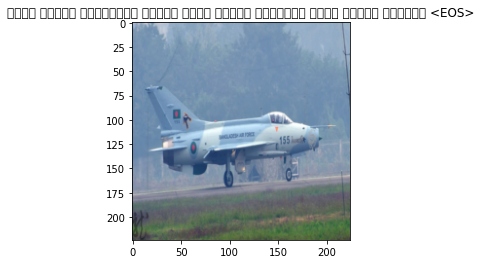

একটি ফিলিং স্টেশনের সামনে একটি বিমান বাহিনীর একটি গাড়ি যাচ্ছে <EOS>
Epoch: 3 loss: 4.16702


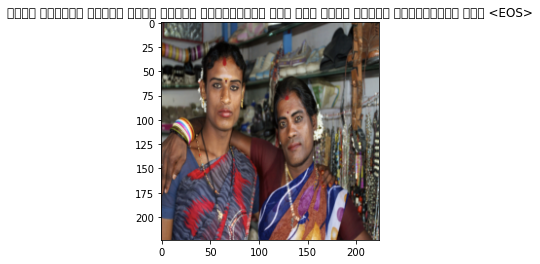

একটি কক্ষের সামনে একজন মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 3 loss: 4.17172


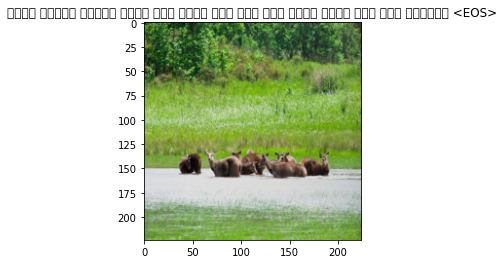

একটি গাছের সামনে একটি ছোট ছেলে বসে আছে এবং পাশে একটি ছোট গাছ রয়েছে <EOS>
Epoch: 3 loss: 4.30533


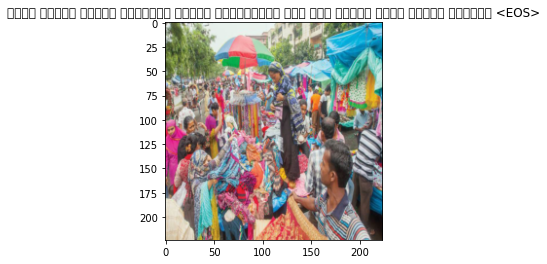

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু মানুষ রয়েছে <EOS>
Epoch: 3 loss: 4.13217


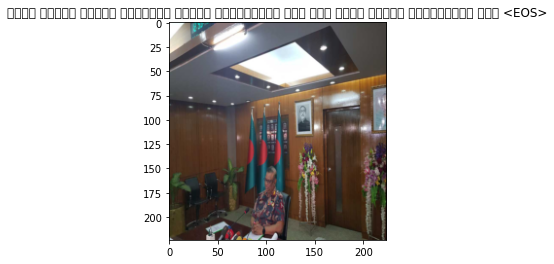

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 4 loss: 4.03645


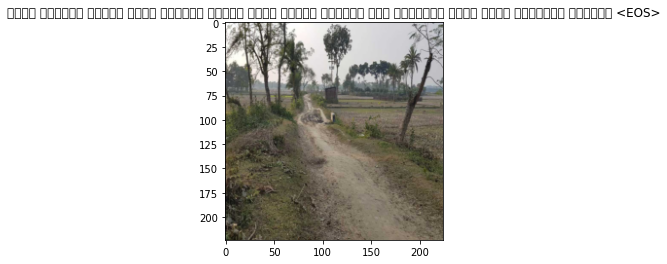

একটি রাস্তা দিয়ে একটি রাস্তা দিয়ে একটি গাড়ি যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 4 loss: 4.07521


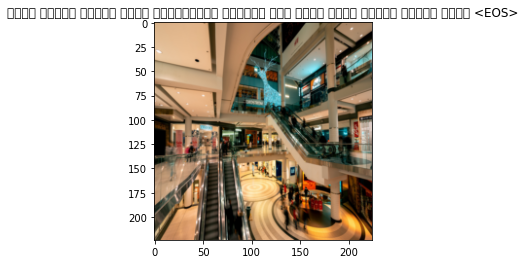

একটি ভবনের সামনে একটি সাইনবোর্ড রয়েছে এবং পাশে কিছু মানুষ চলাচল করছে <EOS>
Epoch: 4 loss: 4.16015


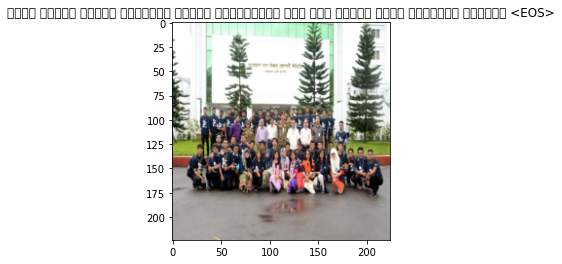

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 4 loss: 3.95721


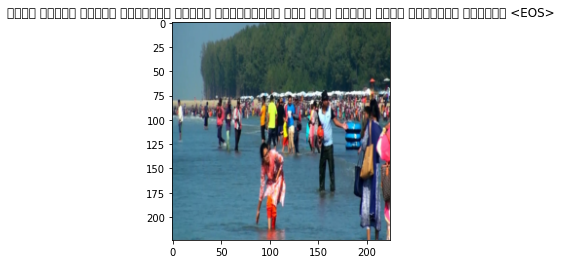

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 4 loss: 4.21975


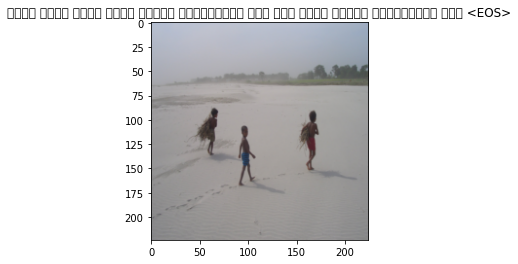

একটি নদীর মাঝে একজন মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 4 loss: 4.18251


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0, flags=flags)


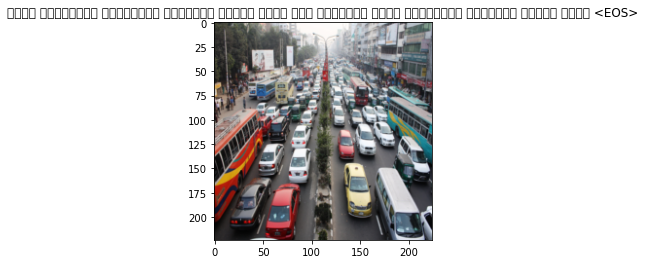

একটি রাস্তায় অনেকগুলো যানবাহন চলাচল করছে এবং রাস্তার পাশে অনেকগুলো যানবাহন চলাচল করছে <EOS>
Epoch: 4 loss: 4.04419


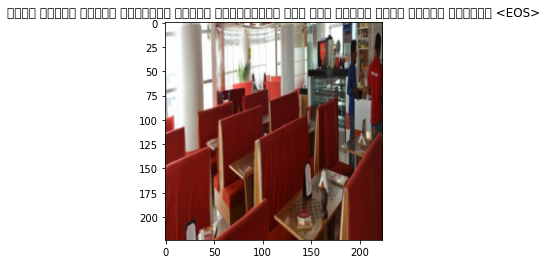

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু মানুষ রয়েছে <EOS>
Epoch: 4 loss: 4.01011


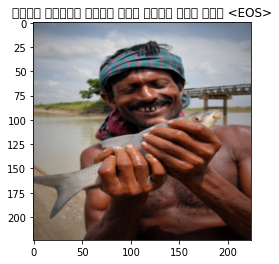

একজন মহিলা একটি ছোট ছেলে বসে আছে <EOS>
Epoch: 4 loss: 3.88610


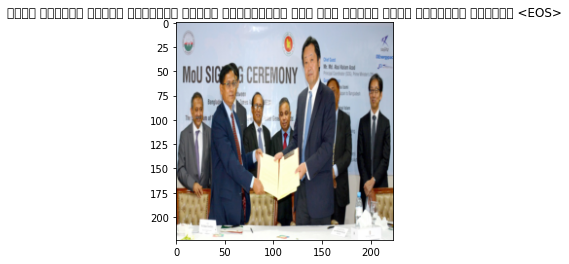

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 4 loss: 4.05033


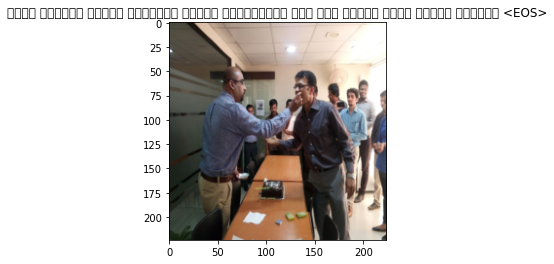

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু মানুষ রয়েছে <EOS>
Epoch: 4 loss: 4.18981


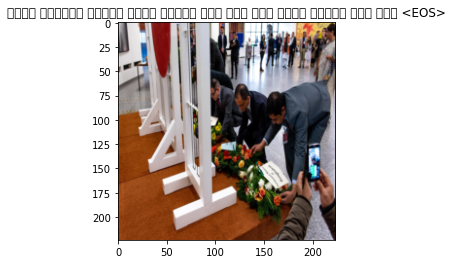

একটি কক্ষের ভেতরে একজন মহিলা বসে আছে এবং একজন মহিলা বসে আছে <EOS>
Epoch: 4 loss: 4.05130


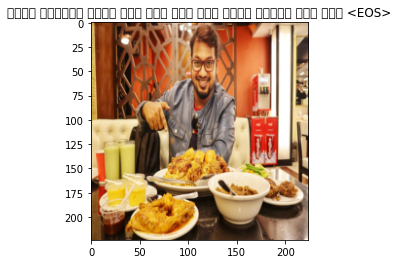

একটি দোকানে একজন লোক বসে আছে এবং একজন মানুষ বসে আছে <EOS>
Epoch: 4 loss: 4.09953


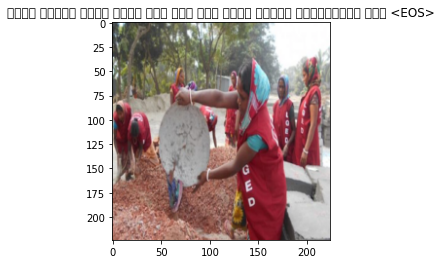

একজন মহিলা একটি ছেলে বসে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 4 loss: 4.10942


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2504 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2504 missing from current font.
  font.set_text(s, 0, flags=flags)


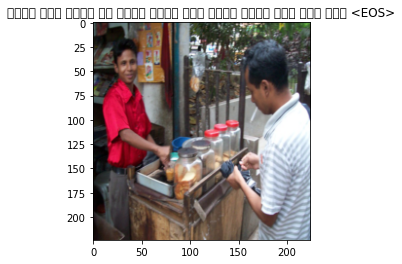

একজন লোক একটি চা তৈরি করছে এবং পাশে একজন লোক বসে আছে <EOS>
Epoch: 4 loss: 3.87657


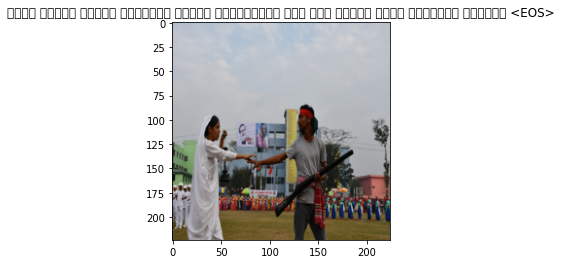

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 4 loss: 4.13526


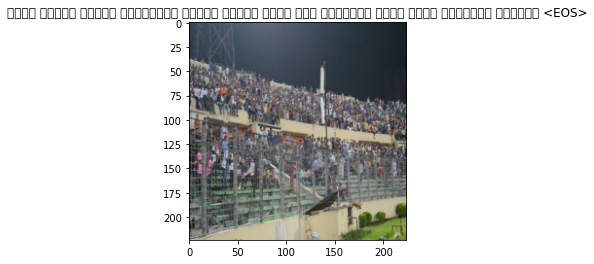

একটি ভবনের সামনে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 4 loss: 4.06204


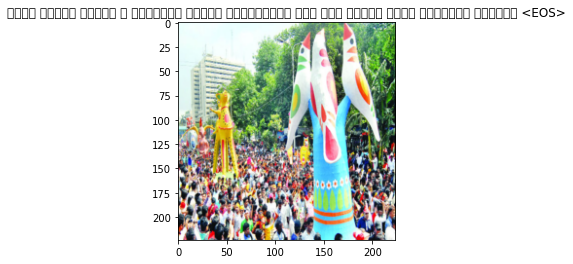

একটি ফুলের মুকুট ও কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 5 loss: 3.85178


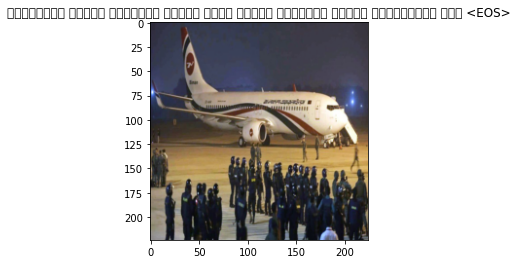

বাংলাদেশ বিমান বাহিনীর সদস্য একটি বিমান বাহিনীর সদস্য দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.97589


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0, flags=flags)


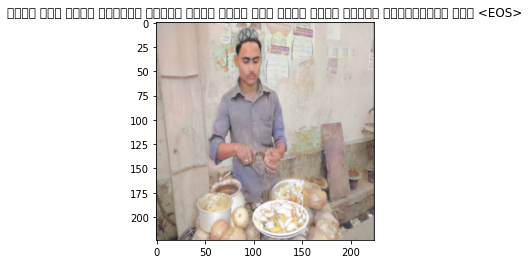

একজন লোক একটি পাত্রে খাবার তৈরি করছে এবং পাশে একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.76744


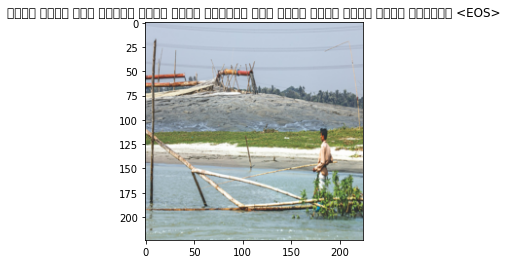

একটি নদীর উপর দিয়ে একটি নৌকা রয়েছে এবং নদীর পাশে একটি নৌকা রয়েছে <EOS>
Epoch: 5 loss: 3.90756


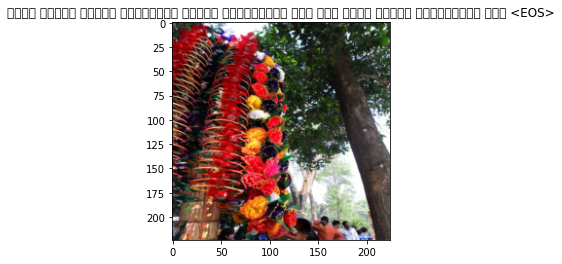

একটি ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.89425


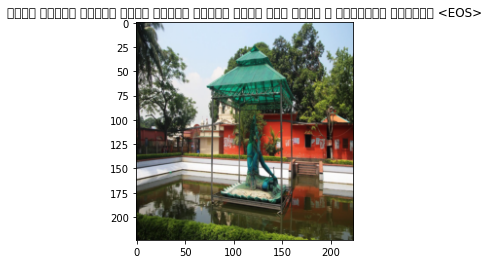

একটি ভবনের সামনে একটি ভবনের সামনে একটি ছোট ছেলে ও গাছপালা রয়েছে <EOS>
Epoch: 5 loss: 3.76417


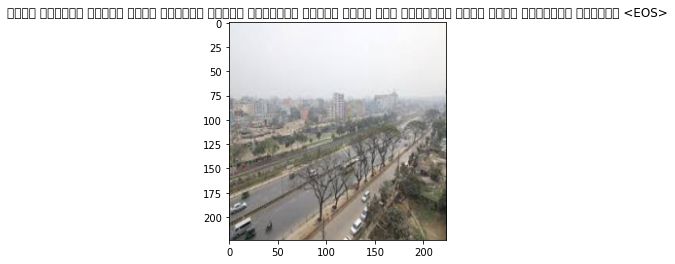

একটি রাস্তা দিয়ে একটি রাস্তা দিয়ে যানবাহন চলাচল করছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 5 loss: 3.76171


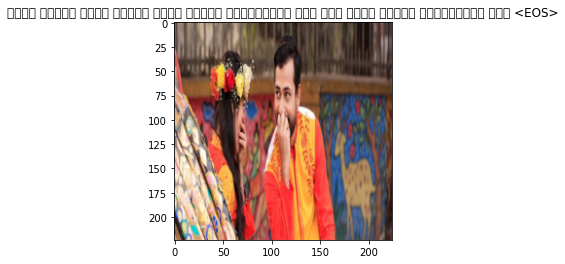

একজন মহিলা একটি মেয়ে হাতে নিয়ে দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.75533


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2456 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2456 missing from current font.
  font.set_text(s, 0, flags=flags)


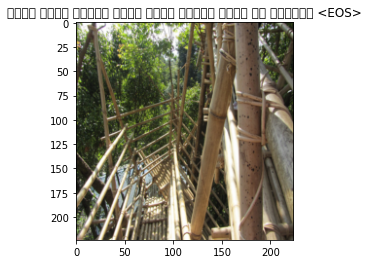

একটি ঘরের সামনে একটি বাঁশ দিয়ে একটি ঘর রয়েছে <EOS>
Epoch: 5 loss: 3.79197


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0, flags=flags)


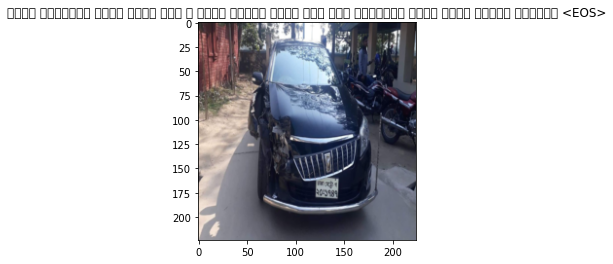

একটি রাস্তার পাশে একটি বাস ও একটি গাড়ি থেমে আছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 5 loss: 3.75965


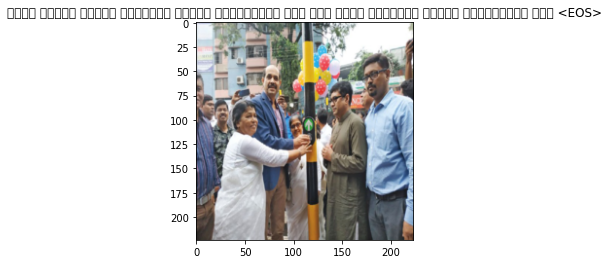

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.78990


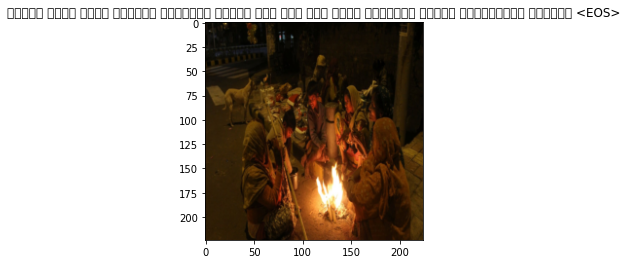

রাতের বেলা একটি দোকানে কয়েকজন মানুষ বসে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 5 loss: 3.64588


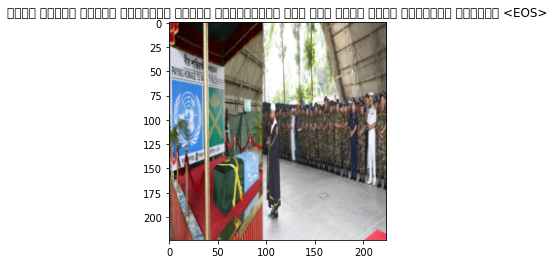

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে একটি ব্যানার রয়েছে <EOS>
Epoch: 5 loss: 3.68382


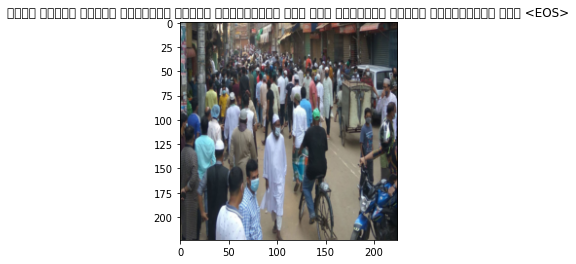

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.84671


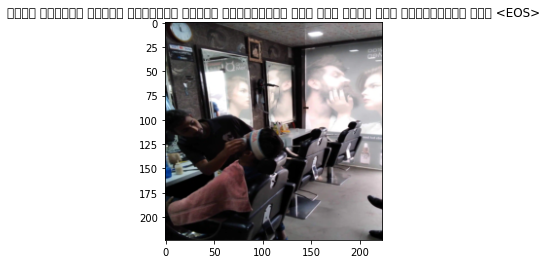

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.80913


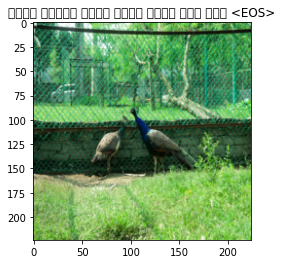

একটি গাছের ডালে একটি পাখি বসে আছে <EOS>
Epoch: 5 loss: 3.72631


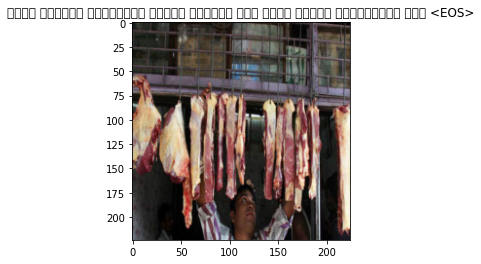

একটি দোকানে অনেকগুলো মানুষ রয়েছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 5 loss: 3.84195


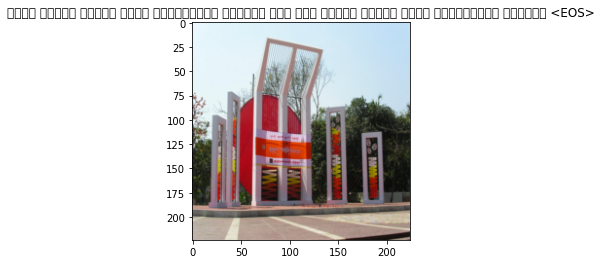

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 6 loss: 3.67822


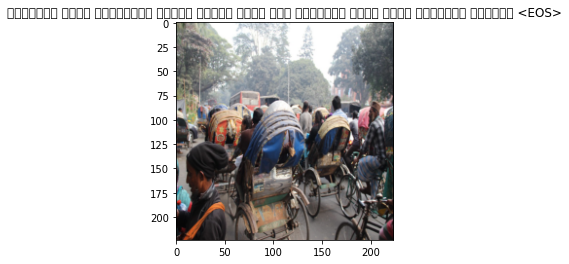

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 6 loss: 3.67984


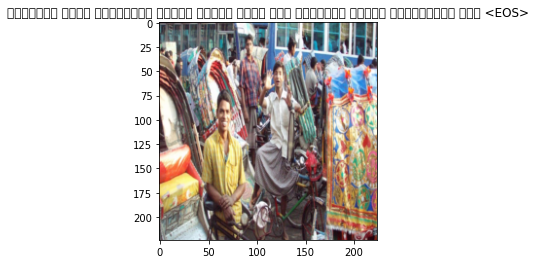

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 6 loss: 3.63065


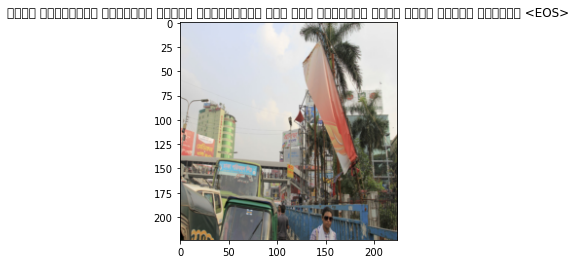

একটি রাস্তায় কয়েকজন মানুষ দাঁড়িয়ে আছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 6 loss: 3.70290


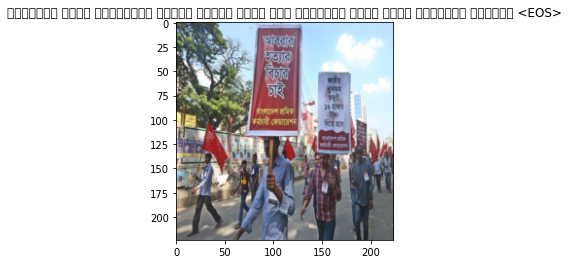

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে একটি ব্যানার রয়েছে <EOS>
Epoch: 6 loss: 3.59312


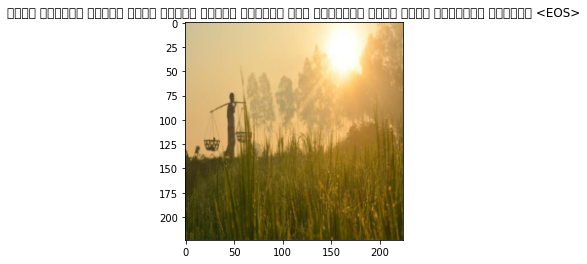

একটি রাস্তা দিয়ে একজন মানুষ হেঁটে যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 6 loss: 3.49491


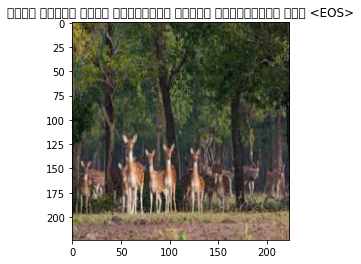

একটি গাছের নিচে অনেকগুলো মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 6 loss: 3.49077


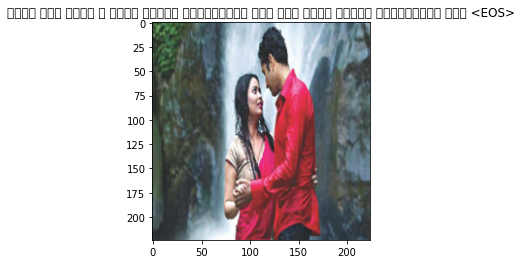

একটি ছোট ছেলে ও একজন মেয়ে দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 6 loss: 3.52226


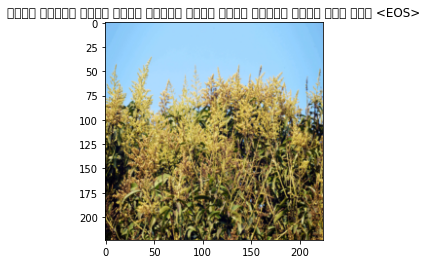

একটি গাছের ডালে একটি গাছের ডালে একটি গাছের ডালে বসে আছে <EOS>
Epoch: 6 loss: 3.59305


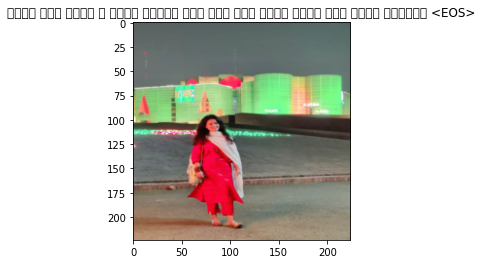

একটি ছোট ছেলে ও একটি মেয়ে বসে আছে এবং পাশে একটি ছোট ছেলে রয়েছে <EOS>
Epoch: 6 loss: 3.63674


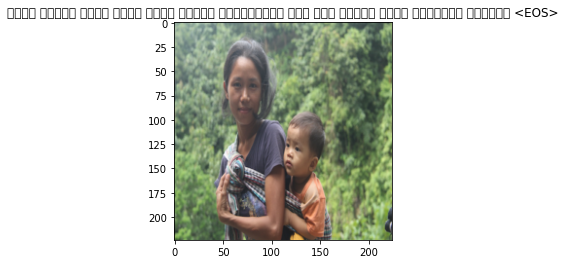

একজন মহিলা একটি শিশু হাতে নিয়ে দাঁড়িয়ে আছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 6 loss: 3.65940


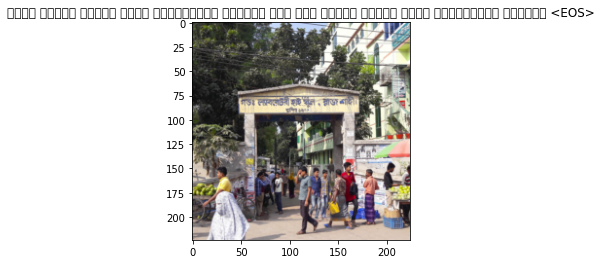

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 6 loss: 3.64741


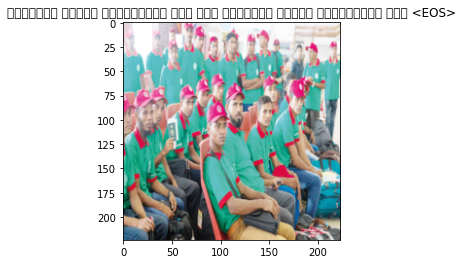

কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 6 loss: 3.65210


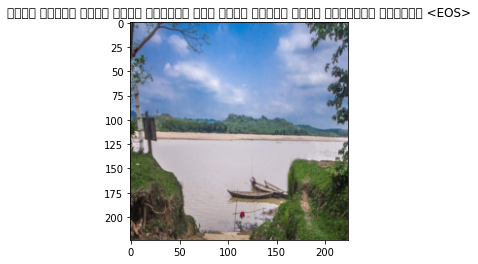

নদীর পাড়ে একটি নৌকা রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 6 loss: 3.55996


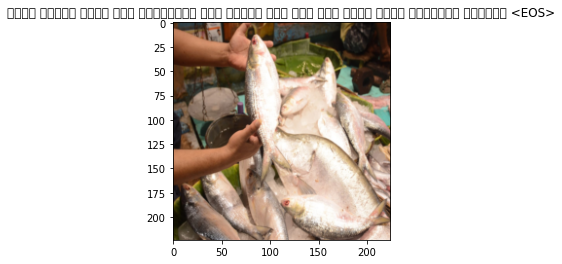

একজন মহিলা একটি মাছ বিক্রেতা মাছ নিয়ে বসে আছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 6 loss: 3.76652


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0, flags=flags)


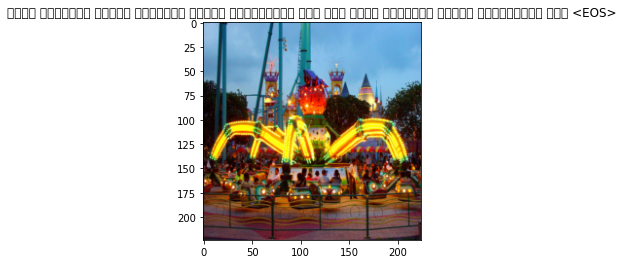

একটি পার্কের মধ্যে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 6 loss: 3.58748


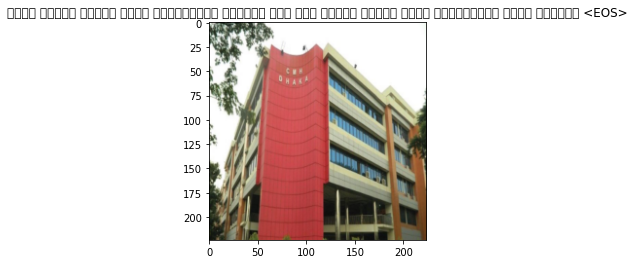

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড দেখা যাচ্ছে <EOS>
Epoch: 6 loss: 3.52293


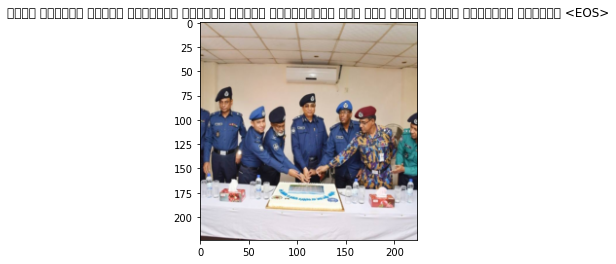

একটি কক্ষের ভেতরে কয়েকজন বিজিবি সদস্য দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 7 loss: 3.46521


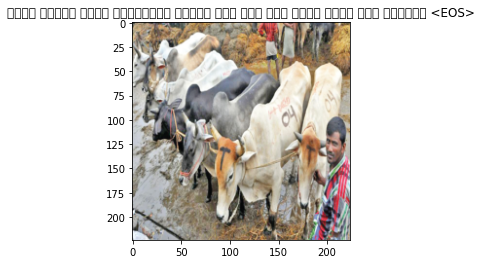

একটি গাছের নিচে অনেকগুলো মানুষ বসে আছে এবং পাশে একটি গরু রয়েছে <EOS>
Epoch: 7 loss: 3.55380


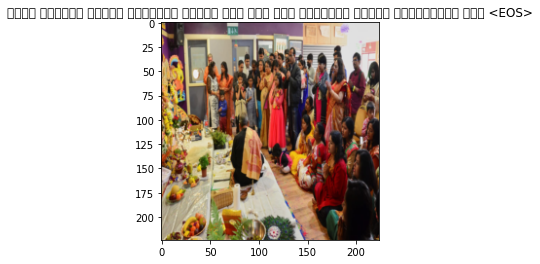

একটি কক্ষের ভেতরে কয়েকজন মানুষ বসে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 7 loss: 3.46547


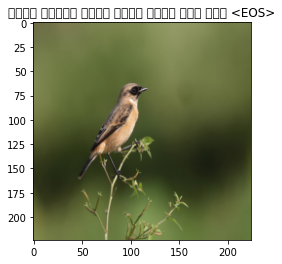

একটি গাছের ডালে একটি পাখি বসে আছে <EOS>
Epoch: 7 loss: 3.44793


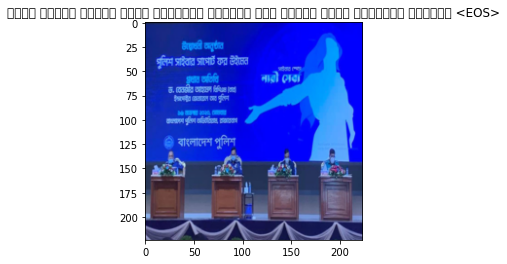

একটি ভবনের সামনে একটি ব্যানার রয়েছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 7 loss: 3.38350


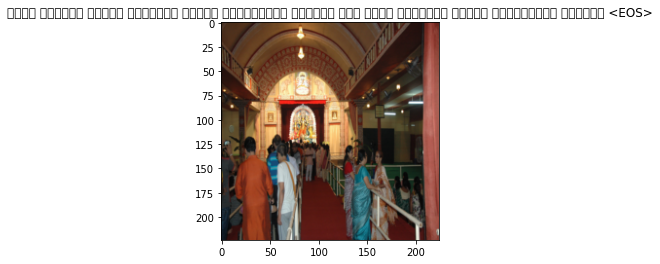

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 7 loss: 3.44286


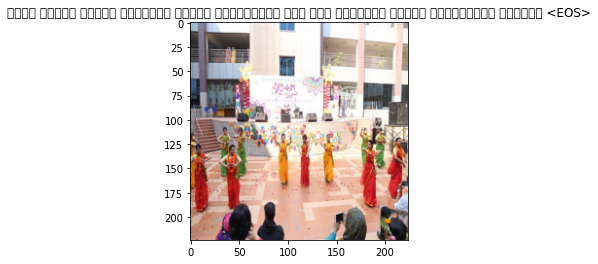

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 7 loss: 3.38256


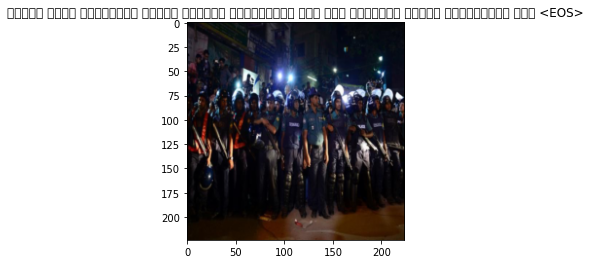

রাতের বেলা অনেকগুলো মানুষ একসাথে দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 7 loss: 3.41462


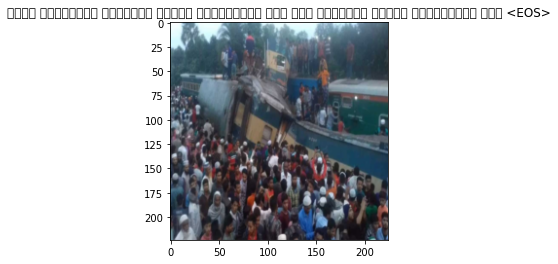

একটি রাস্তায় কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 7 loss: 3.51818


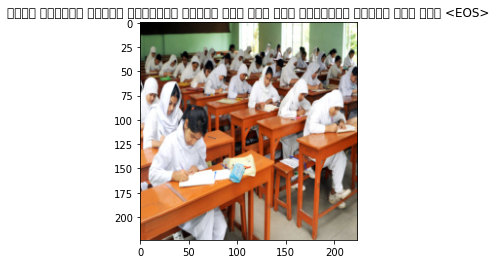

একটি কক্ষের ভেতরে কয়েকজন মানুষ বসে আছে এবং কয়েকজন মানুষ বসে আছে <EOS>
Epoch: 7 loss: 3.40968


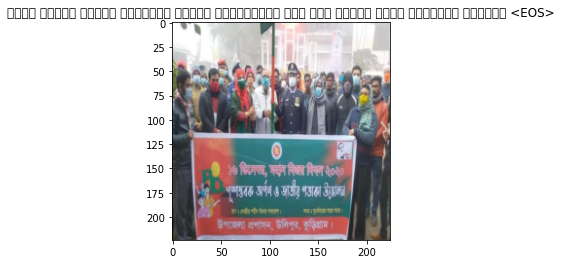

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 7 loss: 3.45041


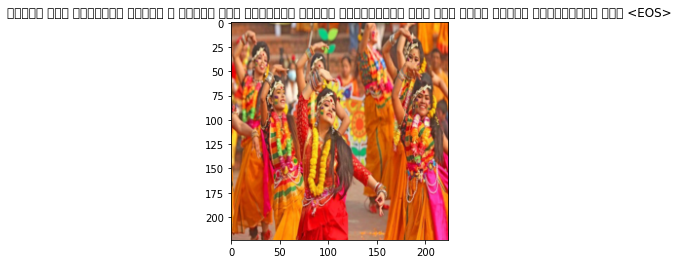

শাড়ি পরা কয়েকজন মেয়ে ও শাড়ি পরা কয়েকজন মেয়ে দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 7 loss: 3.44113


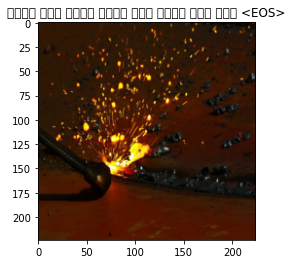

একটি ছোট ছেলে একটি ছোট ছেলে বসে আছে <EOS>
Epoch: 7 loss: 3.34824


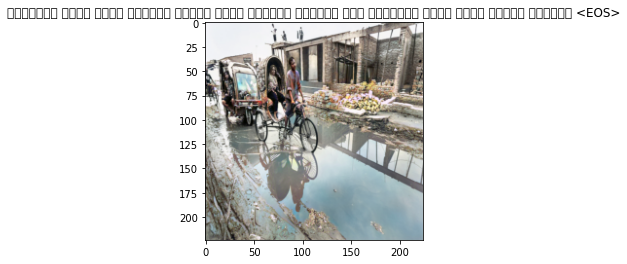

রাস্তার পাশে একটি রিক্সা সামনে একটি রিক্সা যাচ্ছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 7 loss: 3.44142


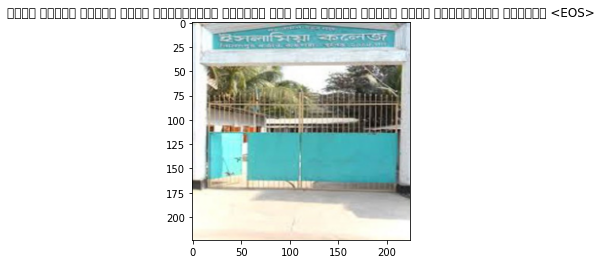

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ফটকের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 7 loss: 3.39763


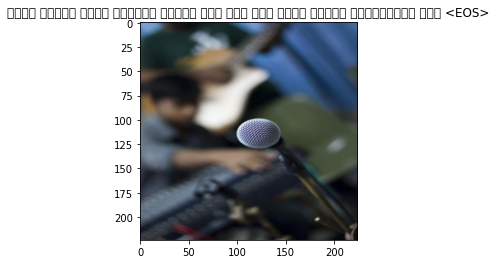

একজন মানুষ একটি কক্ষের মধ্যে বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 7 loss: 3.54574


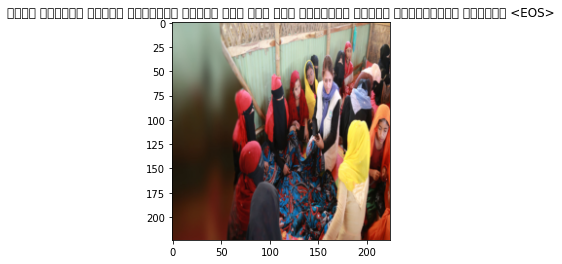

একটি কক্ষের ভেতরে কয়েকজন মহিলা বসে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 7 loss: 3.59110


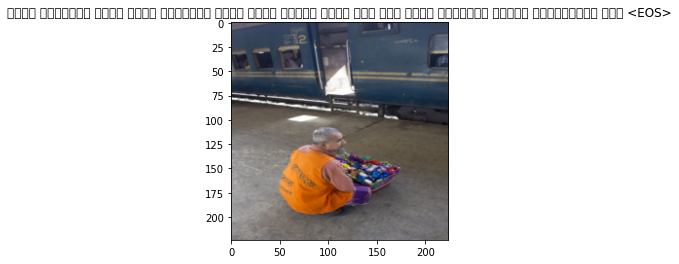

একটি ট্রেনের পাশে একটি ট্রেনের পাশে একটি গাড়ি থেমে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 8 loss: 3.38906


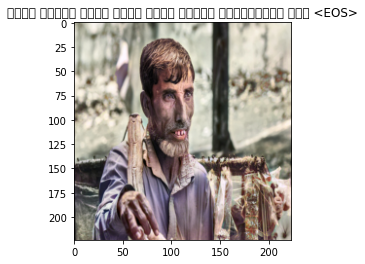

একজন মহিলা একটি শিশু হাতে নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 8 loss: 3.33005


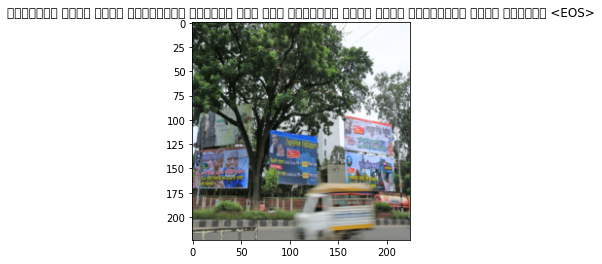

রাস্তার পাশে একটি বিলবোর্ড লাগানো আছে এবং রাস্তার পাশে একটি বিলবোর্ড দেখা যাচ্ছে <EOS>
Epoch: 8 loss: 3.24237


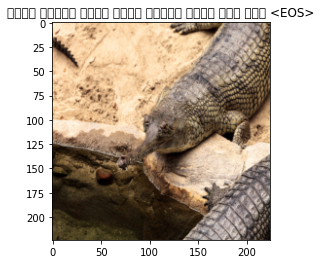

একটি গাছের নিচে একটি গাছের নিচে বসে আছে <EOS>
Epoch: 8 loss: 3.30274


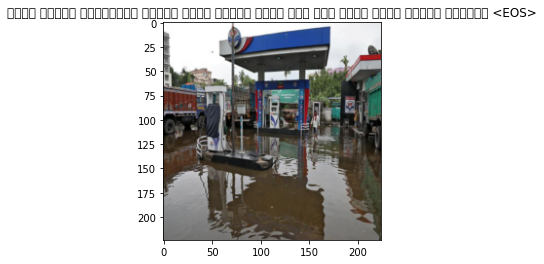

একটি ফিলিং স্টেশনের সামনে একটি গাড়ি থেমে আছে এবং পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 8 loss: 3.30713


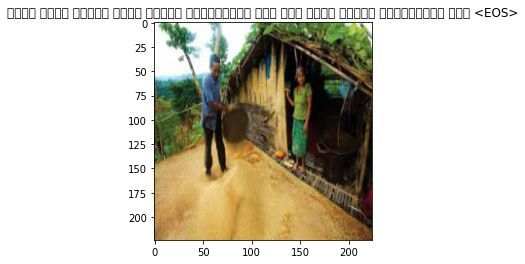

একটি ঘরের সামনে একজন মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 8 loss: 3.30946


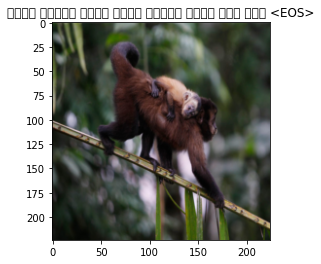

একটি গাছের ডালে একটি গাছের ডালে বসে আছে <EOS>
Epoch: 8 loss: 3.33178


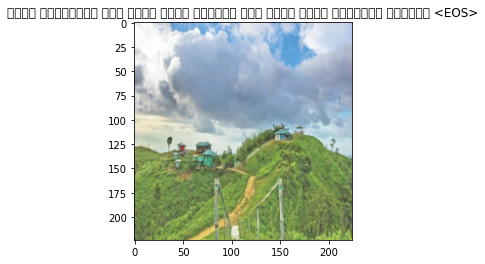

একটি পাহাড়ের উপর একটি নৌকা রয়েছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 8 loss: 3.31653


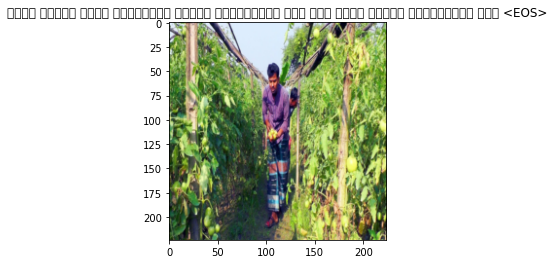

একটি গাছের নিচে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 8 loss: 3.24361


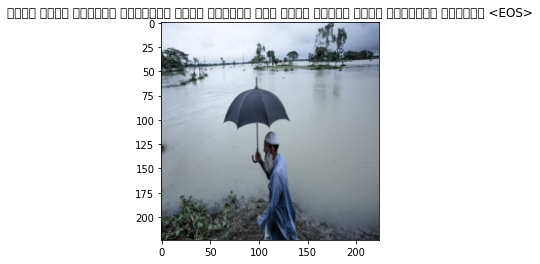

একটি নদীর কিনারে কয়েকটি নৌকা রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 8 loss: 3.38450


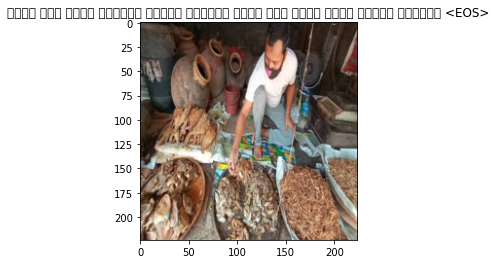

একজন লোক একটি পাত্রে খাবার বিক্রি করছে এবং পাশে কিছু মানুষ রয়েছে <EOS>
Epoch: 8 loss: 3.28521


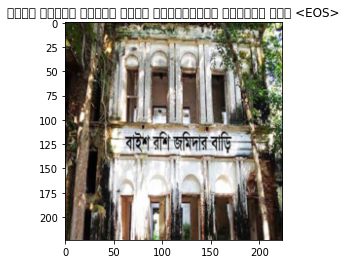

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 8 loss: 3.24540


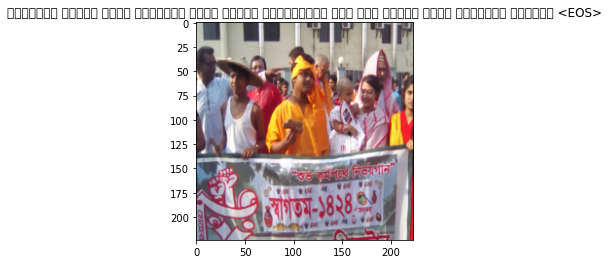

কয়েকজন মানুষ একটি ব্যানার হাতে নিয়ে দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 8 loss: 3.29605


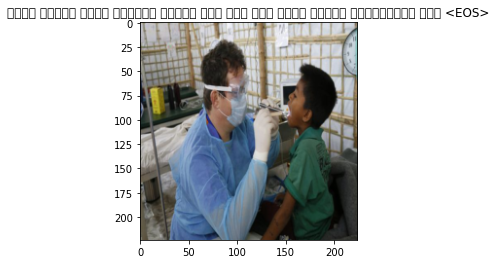

একজন মহিলা একটি কক্ষের ভেতরে বসে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 8 loss: 3.42023


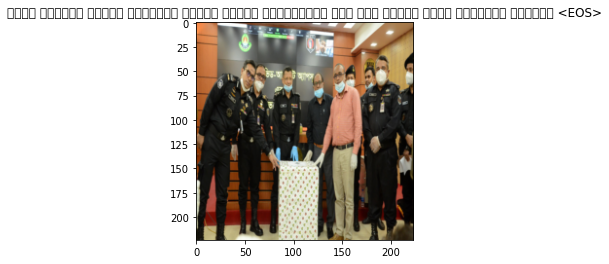

একটি কক্ষের ভেতরে কয়েকজন র‌্যাব সদস্য দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 8 loss: 3.18316


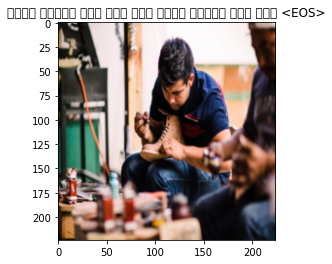

একজন মহিলা বসে আছে এবং একজন মহিলা বসে আছে <EOS>
Epoch: 8 loss: 3.18850


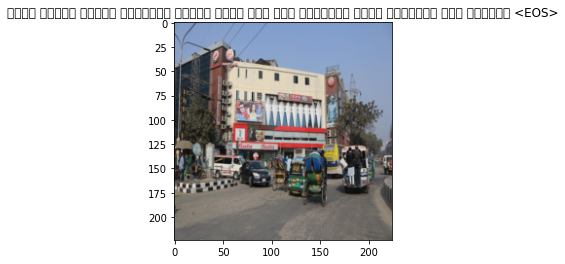

একটি ভবনের সামনে কয়েকটি ট্রাক থেমে আছে এবং রাস্তার পাশে কয়েকটি ভবন রয়েছে <EOS>
Epoch: 8 loss: 3.22789


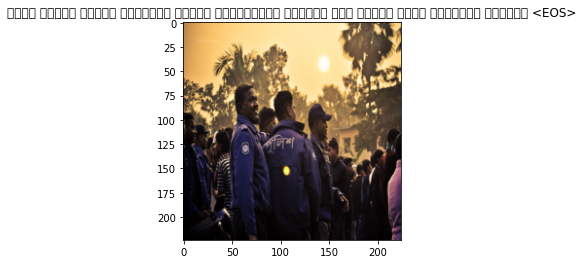

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 9 loss: 3.15606


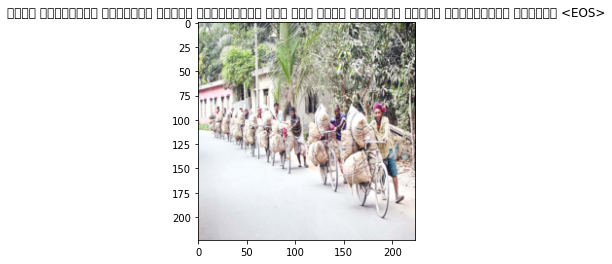

একটি রাস্তায় কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 9 loss: 3.33820


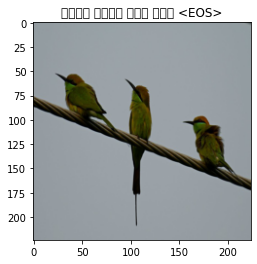

একটি পাখি বসে আছে <EOS>
Epoch: 9 loss: 3.09477


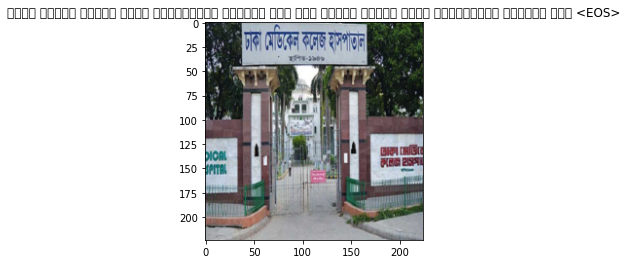

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 9 loss: 3.14736


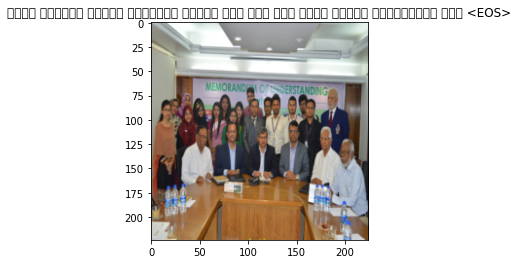

একটি কক্ষের ভেতরে কয়েকজন মানুষ বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 9 loss: 3.18438


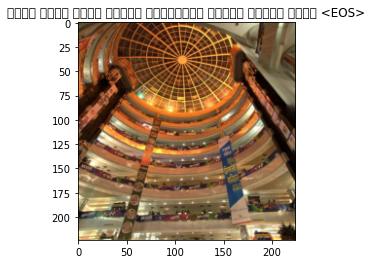

একটি শপিং মলের ভেতরে অনেকগুলো মানুষ চলাচল করছে <EOS>
Epoch: 9 loss: 3.19973


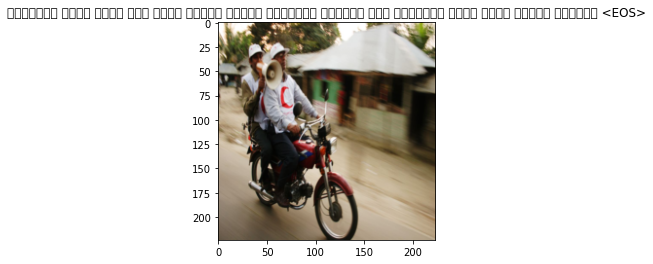

রাস্তার পাশে একজন লোক একটি ভ্যান গাড়ি চালিয়ে যাচ্ছে এবং রাস্তার পাশে একটি গাড়ি রয়েছে <EOS>
Epoch: 9 loss: 3.24727


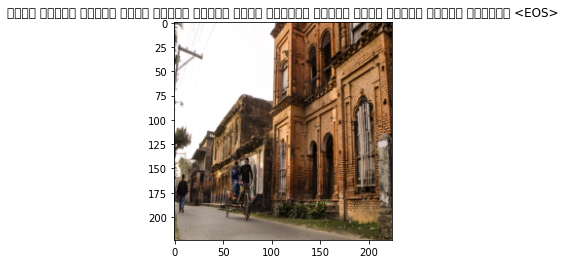

একটি ভবনের সামনে একটি ভবনের সামনে একটি রাস্তা দিয়ে একজন মানুষ হেঁটে যাচ্ছে <EOS>
Epoch: 9 loss: 3.25397


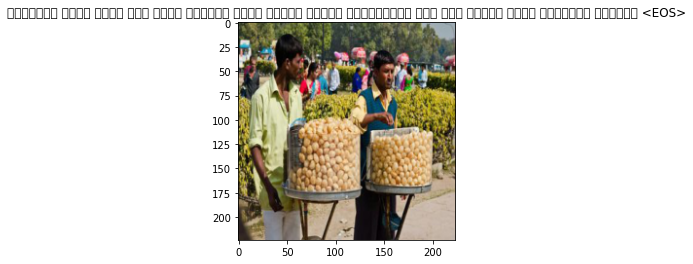

রাস্তার পাশে একজন লোক একটি পাত্রে কিছু খাবার নিয়ে দাঁড়িয়ে আছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 9 loss: 3.32932


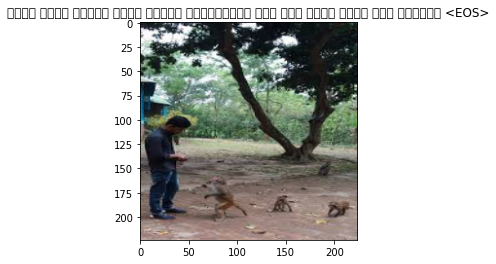

একটি ঘরের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং পাশে একটি গাছ রয়েছে <EOS>
Epoch: 9 loss: 3.08490


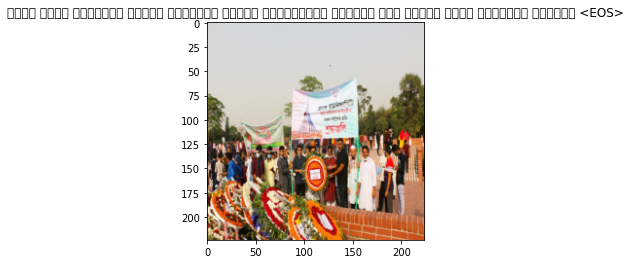

একটি শহীদ মিনারের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 9 loss: 3.17080


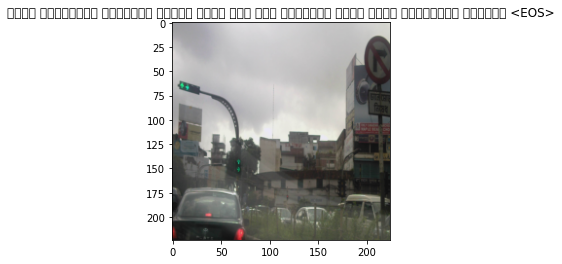

একটি রাস্তায় কয়েকটি গাড়ি থেমে আছে এবং রাস্তার পাশে একটি বিলবোর্ড রয়েছে <EOS>
Epoch: 9 loss: 3.16011


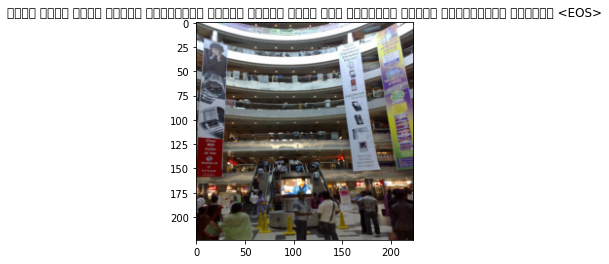

একটি শপিং মলের সামনে অনেকগুলো মানুষ চলাচল করছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 9 loss: 3.24152


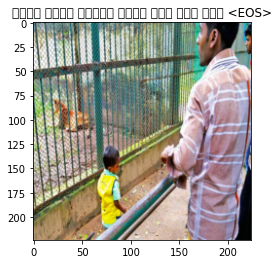

একটি ঘরের সামনে একজন লোক বসে আছে <EOS>
Epoch: 9 loss: 3.06548


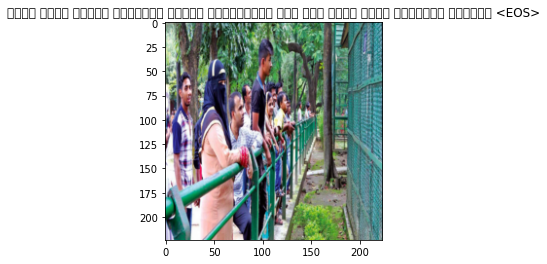

একটি ঘরের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 9 loss: 3.17916


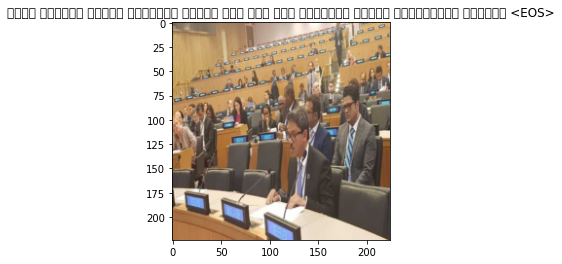

একটি কক্ষের ভেতরে কয়েকজন মানুষ বসে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 9 loss: 3.17250


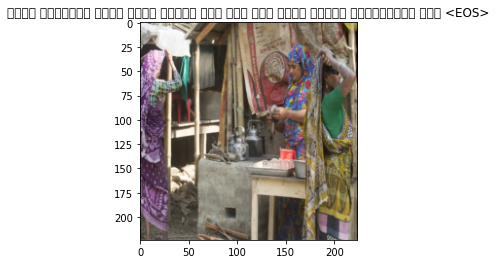

একটি দোকানের ভেতর একজন মহিলা বসে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 9 loss: 3.20000


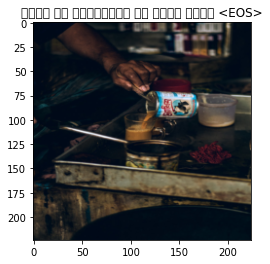

একজন চা দোকানদার চা তৈরি করছে <EOS>
Epoch: 10 loss: 3.21352


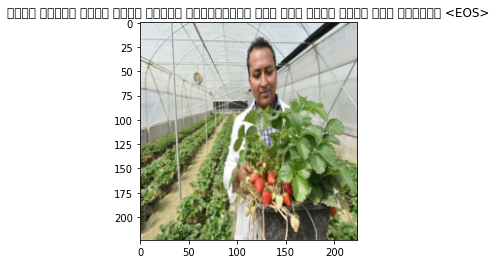

একজন মহিলা একটি সবজি নিয়ে দাঁড়িয়ে আছে এবং পাশে একটি গাছ রয়েছে <EOS>
Epoch: 10 loss: 3.04842


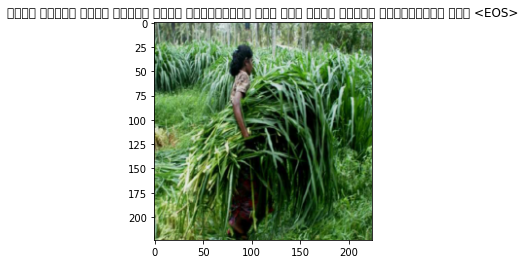

একজন মহিলা একটি গাছের নিচে দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.00681


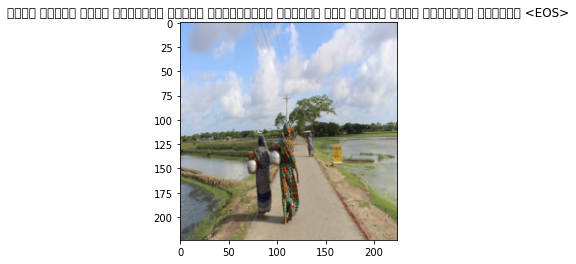

একটি খালের পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 10 loss: 3.07018


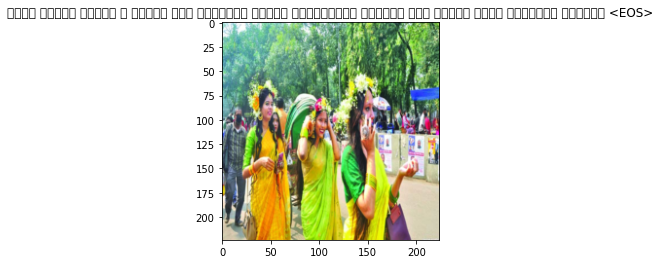

একটি ফুলের মুকুট ও শাড়ি পরা কয়েকজন মেয়ে দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 10 loss: 3.08718


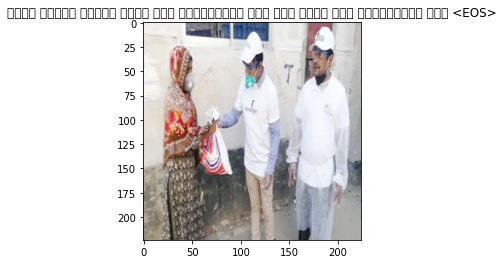

একটি ভবনের সামনে একজন লোক দাঁড়িয়ে আছে এবং একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.09818


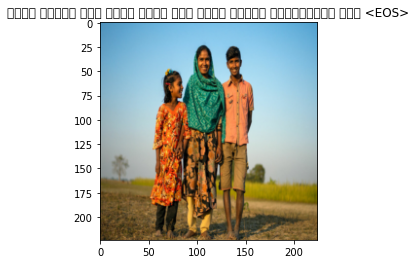

একজন মহিলা তার হাতে একটি ছোট ছেলে নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.00333


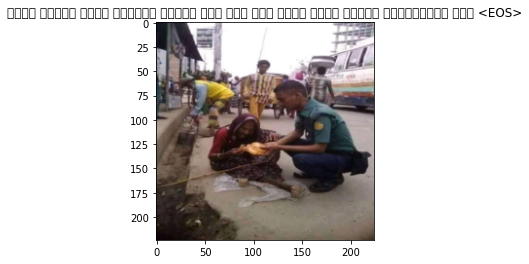

একজন মহিলা একটি গাড়ির সামনে বসে আছে এবং পাশে একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.09943


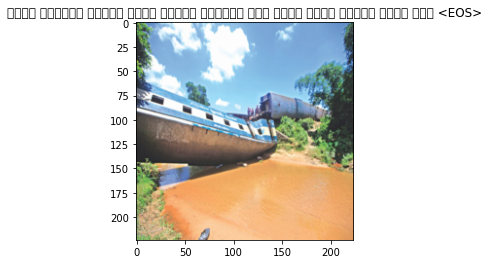

একটি রাস্তা দিয়ে একটি ট্রাক যাচ্ছে এবং পাশে একটি ট্রাক থেমে আছে <EOS>
Epoch: 10 loss: 3.07706


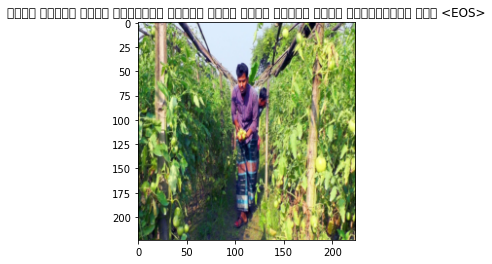

একটি গাছের নিচে কয়েকটি গাছের ডালে একটি গাছের নিচে দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.03451


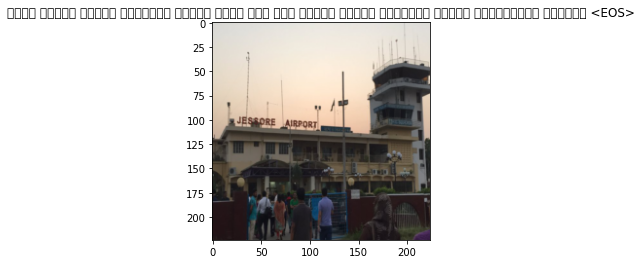

একটি ভবনের সামনে কয়েকটি গাড়ি থেমে আছে এবং ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 10 loss: 3.15117


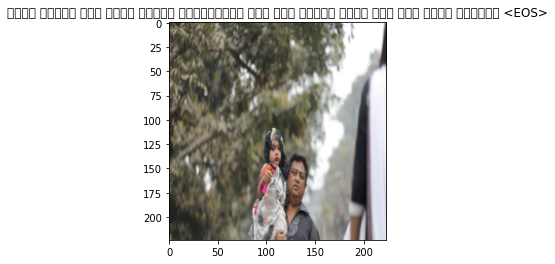

একজন মহিলা তার কোলে নিয়ে দাঁড়িয়ে আছে এবং পিছনে একটি ছোট ছোট ছেলে রয়েছে <EOS>
Epoch: 10 loss: 3.15346


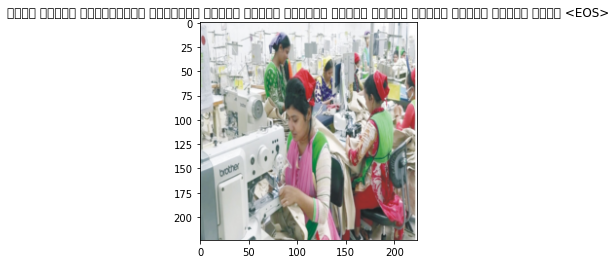

একটি পোশাক কারখানায় কয়েকজন মহিলা পোশাক শ্রমিক সেলাই মেশিন দিয়ে পোশাক সেলাই করছে <EOS>
Epoch: 10 loss: 3.01684


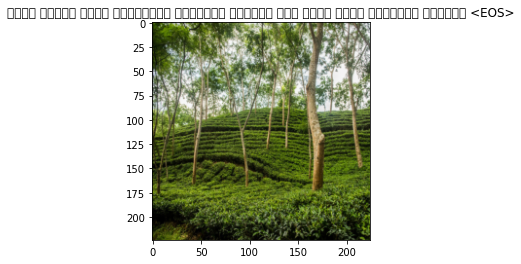

একটি গাছের নিচে অনেকগুলো গাছপালা রয়েছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 10 loss: 3.04391


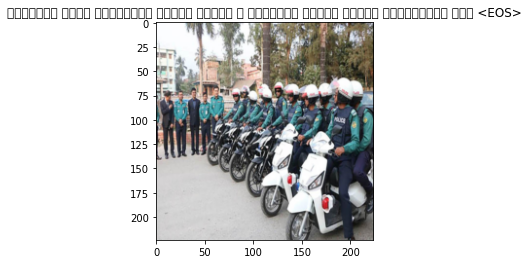

রাস্তার পাশে অনেকগুলো পুলিশ সদস্য ও কয়েকজন পুলিশ সদস্য দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.00955


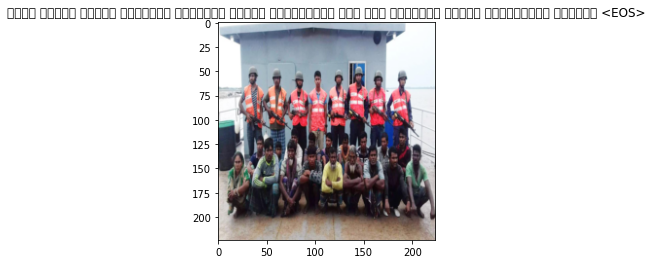

একটি ভবনের সামনে কয়েকজন সশস্ত্র সদস্য দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 10 loss: 3.18855


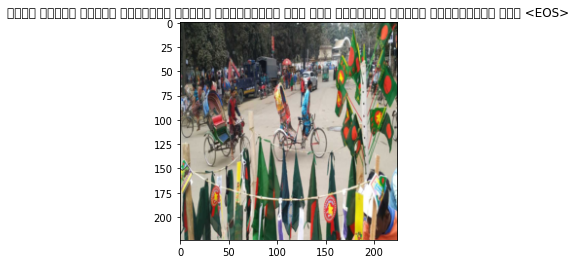

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 10 loss: 3.02155


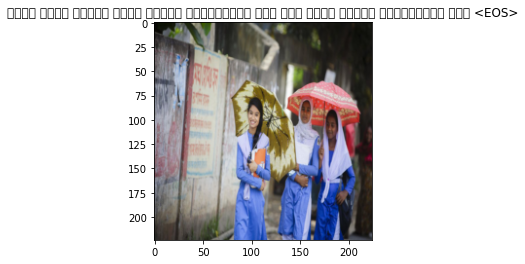

একটি ঘরের সামনে একজন মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.05344


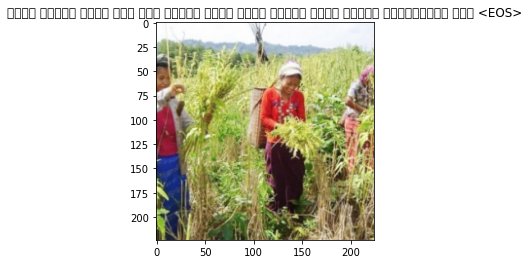

একজন মহিলা একটি ছোট ছোট মেয়ে হাতে একটি ফুলের মালা নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.02489


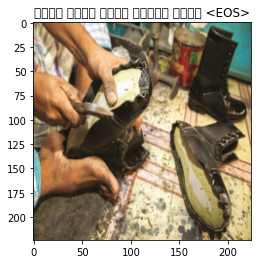

একজন মুচি জুতা সেলাই করছে <EOS>
Epoch: 11 loss: 2.92844


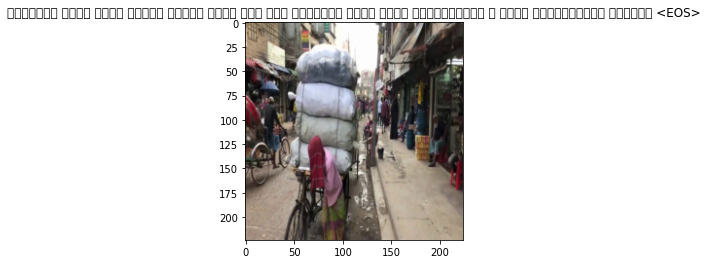

রাস্তার পাশে একটি ভ্যান গাড়ি থেমে আছে এবং রাস্তার পাশে একটি মোটরসাইকেল ও একটি মোটরসাইকেল রয়েছে <EOS>
Epoch: 11 loss: 3.11570


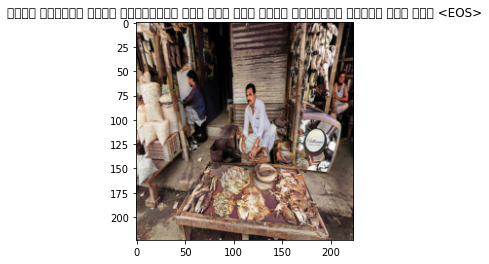

একটি দোকানে একজন দোকানদার বসে আছে এবং পাশে কয়েকজন মানুষ বসে আছে <EOS>
Epoch: 11 loss: 2.95559


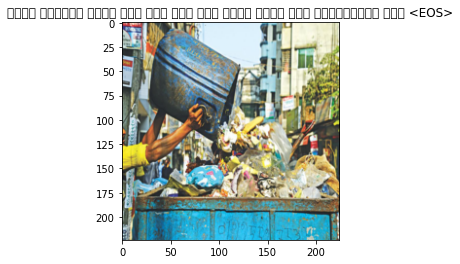

একটি দোকানে একজন লোক বসে আছে এবং পাশে একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 2.90344


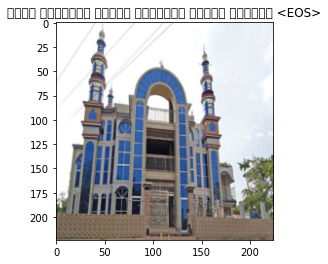

একটি মসজিদের সামনে কয়েকজন মানুষ রয়েছে <EOS>
Epoch: 11 loss: 2.96872


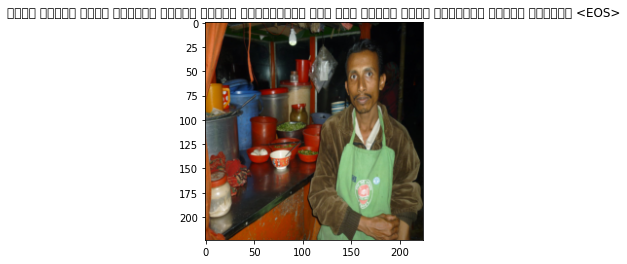

একজন মহিলা একটি পাত্রে খাবার নিয়ে দাঁড়িয়ে আছে এবং পিছনে একটি খাবারের প্লেট রয়েছে <EOS>
Epoch: 11 loss: 3.00769


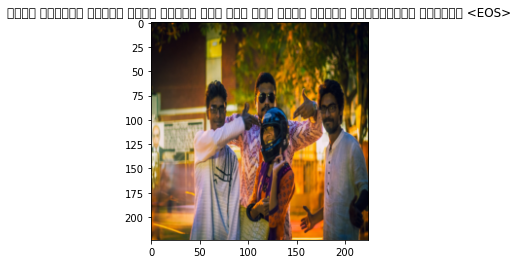

একটি কক্ষের ভেতরে একজন মহিলা বসে আছে এবং একজন মহিলা দাঁড়িয়ে রয়েছে <EOS>
Epoch: 11 loss: 2.91412


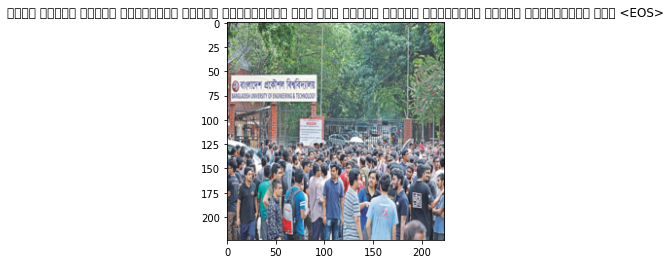

একটি ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.05152


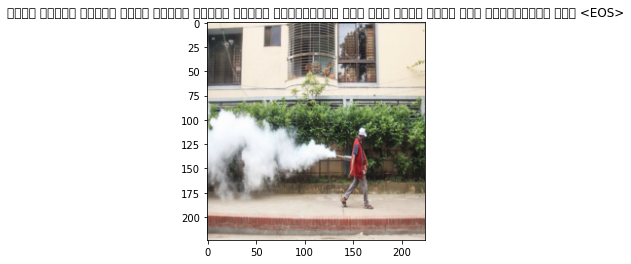

একটি ভবনের সামনে একজন মহিলা পুলিশ সদস্য দাঁড়িয়ে আছে এবং পাশে একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 2.99809


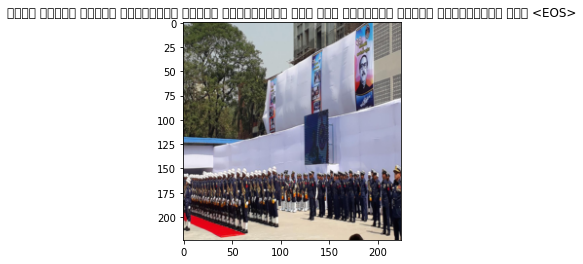

একটি ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 2.93368


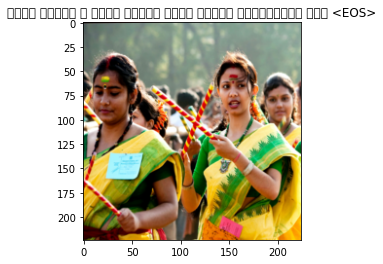

একজন মহিলা ও একটি মেয়ে হাতে নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.13749


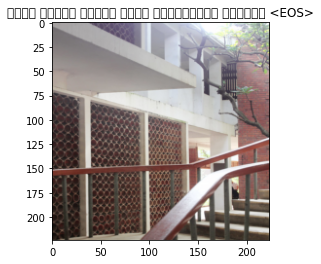

একটি ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 11 loss: 2.91201


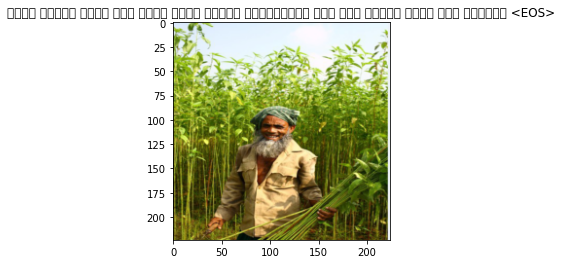

একজন মহিলা একটি ছোট ছেলে হাতে নিয়ে দাঁড়িয়ে আছে এবং পিছনে একটি গাছ রয়েছে <EOS>
Epoch: 11 loss: 2.90116


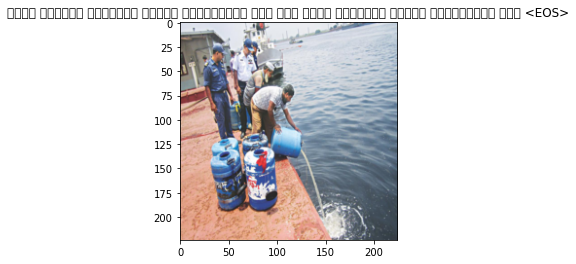

একটি নৌকায় কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.03351


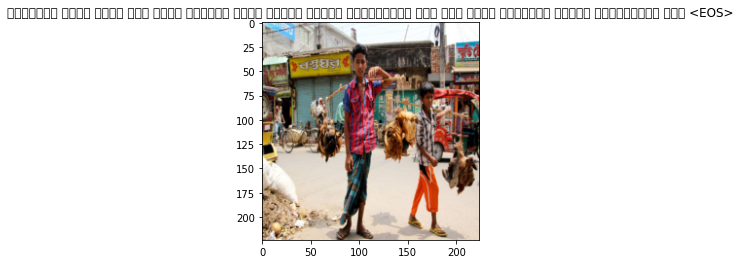

রাস্তার পাশে একজন লোক একটি পাত্রে কিছু খাবার নিয়ে দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 11 loss: 3.02505


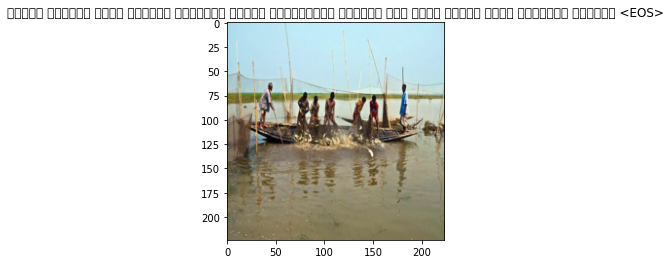

নদীতে ভাসমান একটি নৌকায় কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 12 loss: 2.99379


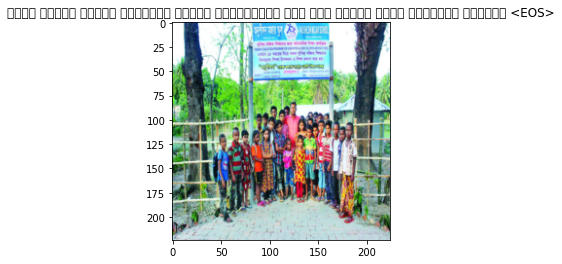

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 12 loss: 2.91326


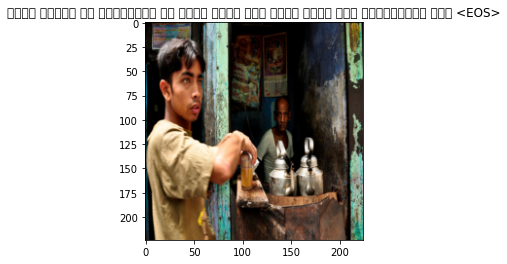

একজন মহিলা চা দোকানদার চা তৈরি করছে এবং পাশে একজন লোক দাঁড়িয়ে আছে <EOS>
Epoch: 12 loss: 2.82585


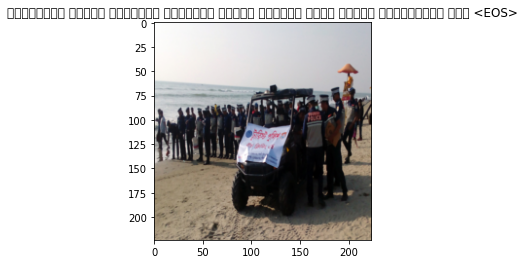

বাংলাদেশ বিমান বাহিনীর কয়েকজন সদস্য অস্ত্র হাতে নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 12 loss: 2.94203


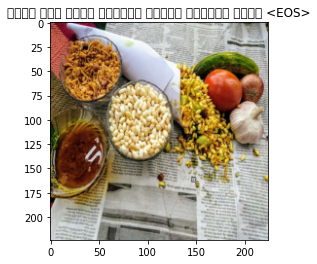

একজন লোক একটি পাত্রে খাবার বিক্রি করছে <EOS>
Epoch: 12 loss: 2.84597


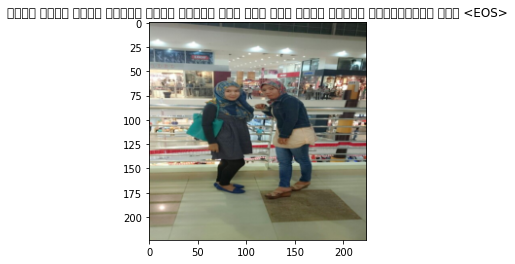

একটি শপিং মলের ভেতরে একজন মানুষ বসে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 12 loss: 2.89516


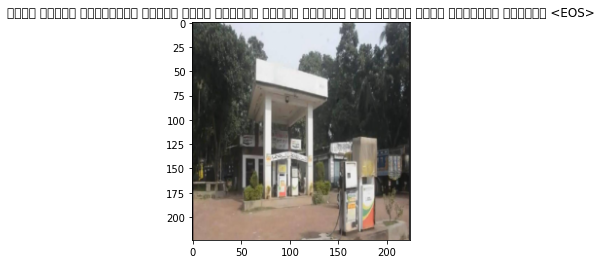

একটি ফিলিং স্টেশনের সামনে একটি ফুয়েল পাম্প রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 12 loss: 2.94638


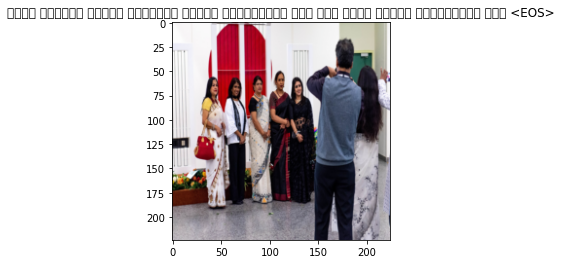

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 12 loss: 2.82957


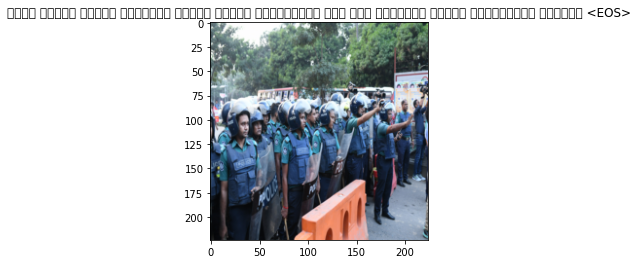

একটি ভবনের সামনে কয়েকজন পুলিশ সদস্য দাঁড়িয়ে আছে এবং কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 12 loss: 2.91326


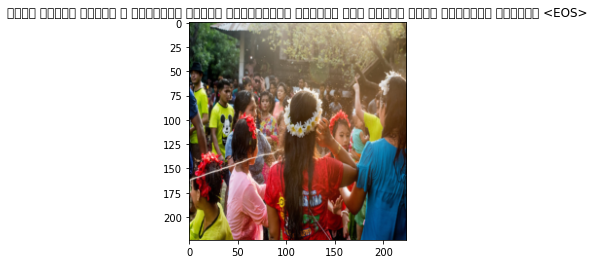

একটি ফুলের মুকুট ও কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 12 loss: 2.89142


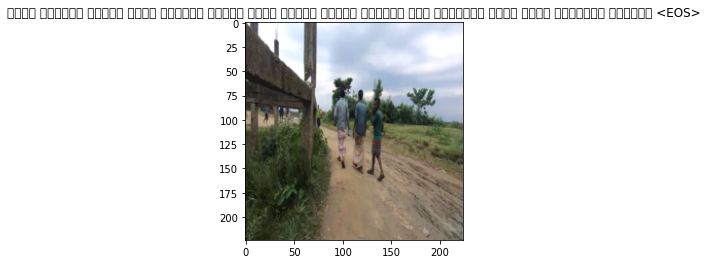

একটি রাস্তা দিয়ে একটি রাস্তা দিয়ে একজন মানুষ হেঁটে যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 12 loss: 2.80123


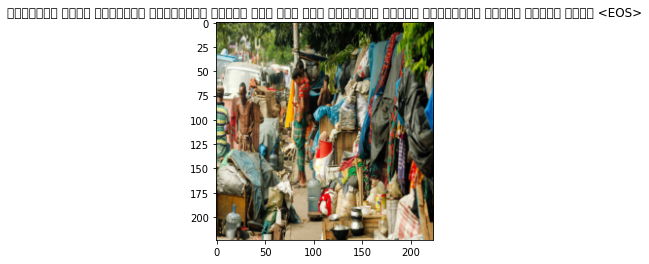

রাস্তার পাশে ফুটপাতে অনেকগুলো মানুষ বসে আছে এবং দোকানের সামনে অনেকগুলো মানুষ চলাচল করছে <EOS>
Epoch: 12 loss: 2.94150


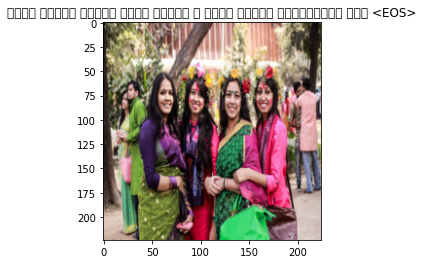

একটি ভবনের সামনে একজন মহিলা ও একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 12 loss: 2.87657


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2464 missing from current font.
  font.set_text(s, 0, flags=flags)


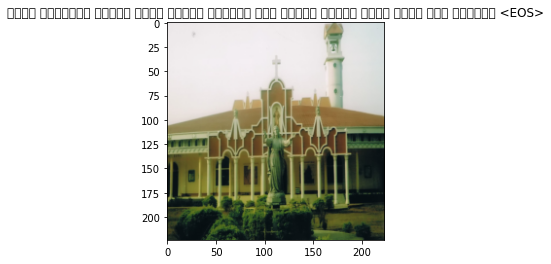

একটি মসজিদের সামনে একটি মসজিদ রয়েছে এবং ভবনের সামনে একটি খোলা মাঠ রয়েছে <EOS>
Epoch: 12 loss: 3.03237


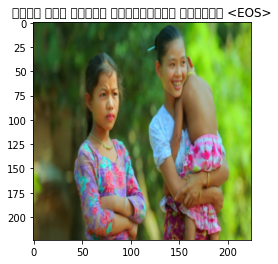

একটি ছোট মেয়ে দাঁড়িয়ে রয়েছে <EOS>
Epoch: 12 loss: 2.88717


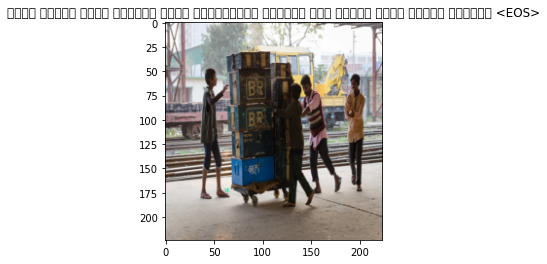

একজন মানুষ একটি গাড়ির পাশে দাঁড়িয়ে রয়েছে এবং পিছনে একটি গাড়ি রয়েছে <EOS>
Epoch: 12 loss: 3.01436


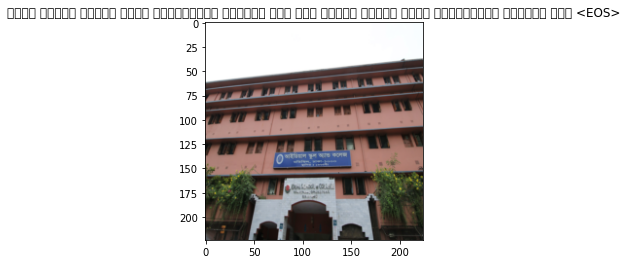

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 12 loss: 2.72780


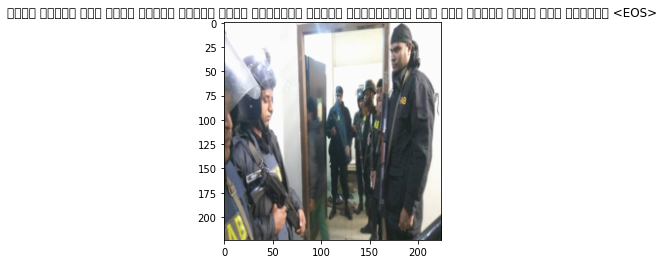

কালো পোশাক পরা একজন র‌্যাব সদস্য একজন আসামীকে নিয়ে দাঁড়িয়ে আছে এবং পিছনে একটি ভবন রয়েছে <EOS>
Epoch: 13 loss: 2.86968


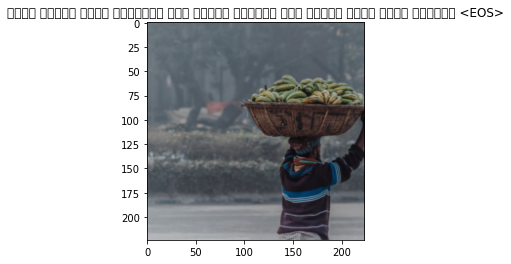

একজন মানুষ একটি ঝুড়িতে করে নিয়ে যাচ্ছে এবং পিছনে একটি নৌকা রয়েছে <EOS>
Epoch: 13 loss: 2.74591


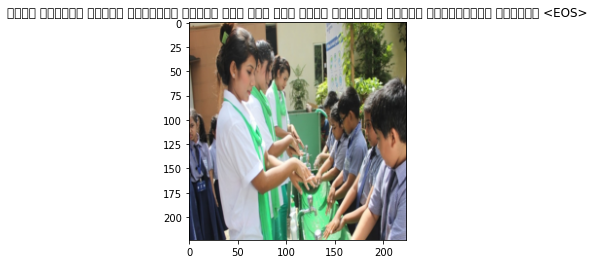

একটি কক্ষের ভেতরে কয়েকজন মানুষ বসে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 13 loss: 2.86794


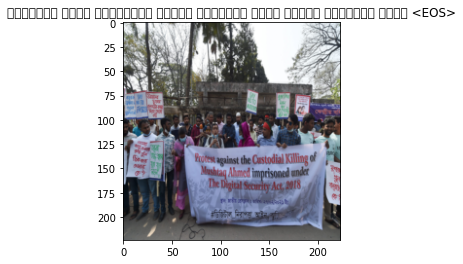

রাস্তার পাশে অনেকগুলো মানুষ ব্যানার হাতে নিয়ে আন্দোলন করছে <EOS>
Epoch: 13 loss: 2.99835


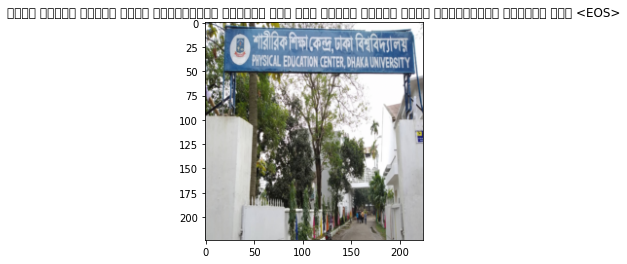

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ফটকের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 13 loss: 2.85911


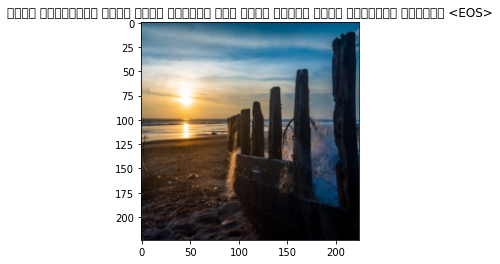

নদীর কিনারায় একটি নৌকা রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 13 loss: 2.69246


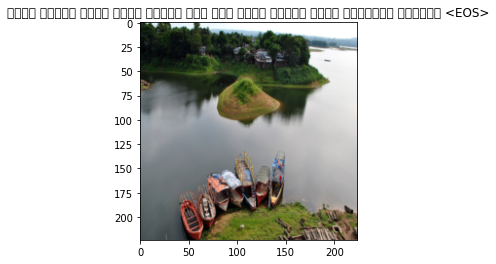

নদীর পাড়ে একটি নৌকা বাঁধা আছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 13 loss: 2.89256


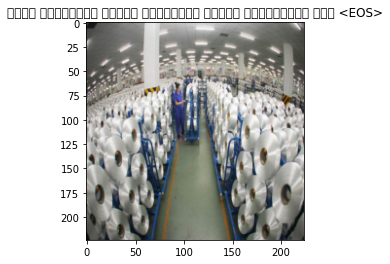

একটি কারখানার ভেতরে অনেকগুলো মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 13 loss: 2.84339


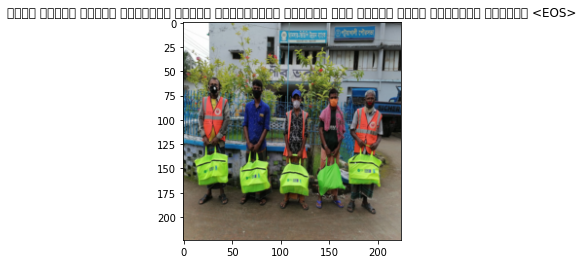

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 13 loss: 2.90005


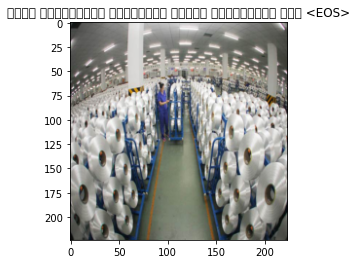

একটি কারখানায় অনেকগুলো মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 13 loss: 2.76178


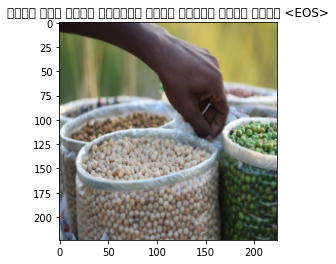

একজন লোক একটি পাত্রে কিছু খাবার তৈরি করছে <EOS>
Epoch: 13 loss: 2.82020


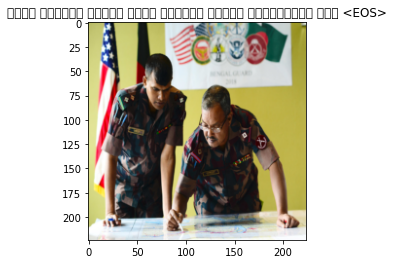

একজন বিজিবি সদস্য একজন বিজিবি সদস্য দাঁড়িয়ে আছে <EOS>
Epoch: 13 loss: 2.82524


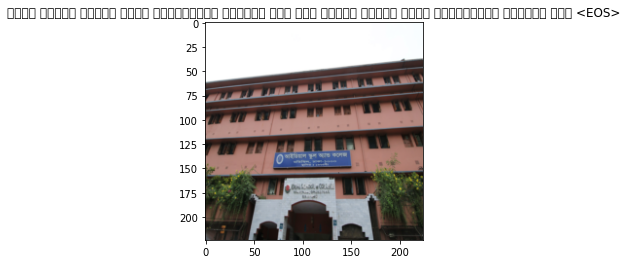

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 13 loss: 2.83655


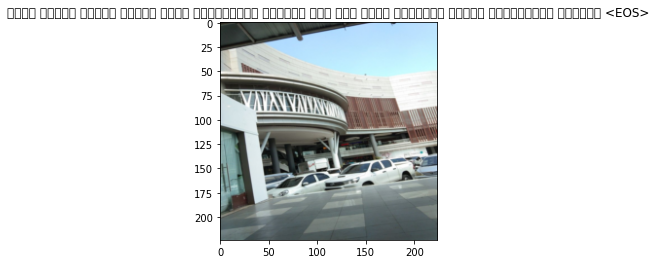

একটি বহুতল ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 13 loss: 2.63883


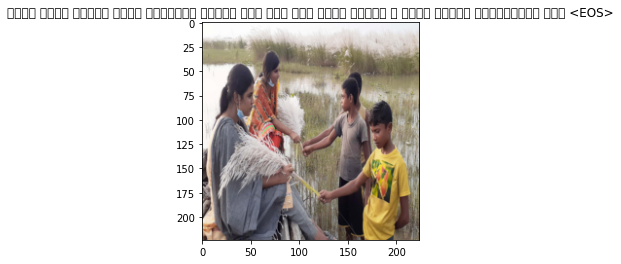

একটি ঘরের সামনে একজন আদিবাসী মহিলা বসে আছে এবং একজন মহিলা ও একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 13 loss: 2.87474


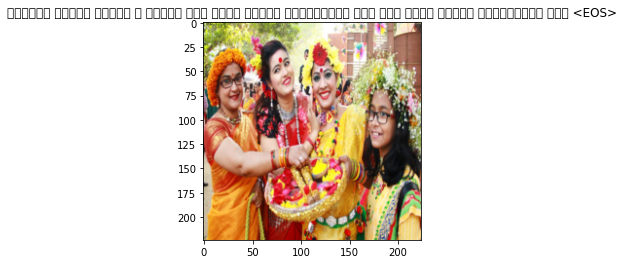

মাথায় ফুলের মুকুট ও শাড়ি পরা একজন মেয়ে দাঁড়িয়ে আছে এবং একজন মেয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 13 loss: 2.77914


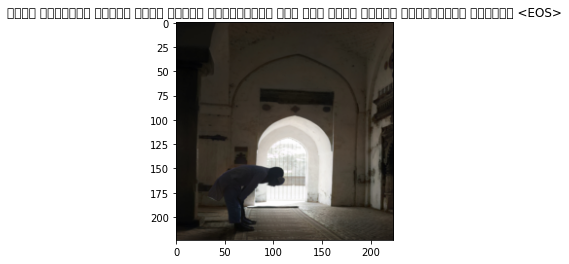

একটি মসজিদের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং একজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 13 loss: 2.83654


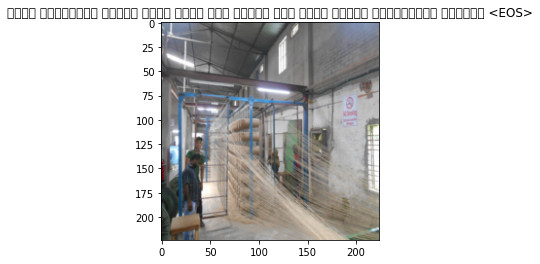

একটি কারখানার ভেতরে সুতা তৈরি করা হচ্ছে এবং একজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 14 loss: 2.76550


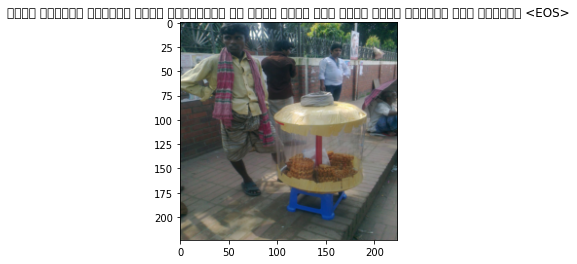

একটি চায়ের দোকানে একজন দোকানদার চা তৈরি করছে এবং পাশে একটি চায়ের কাপ রয়েছে <EOS>
Epoch: 14 loss: 2.71175


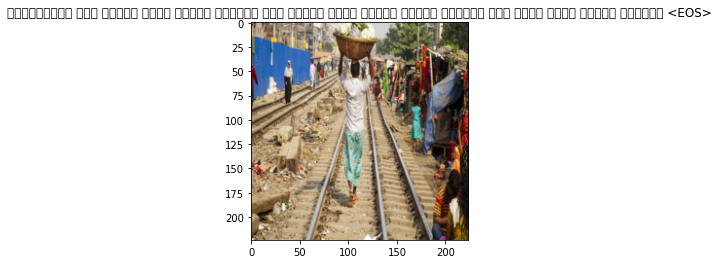

রেললাইনের উপর দিয়ে একটি ট্রেন লাইনের উপর দিয়ে একজন মানুষ হেঁটে যাচ্ছে এবং পাশে একটি ট্রেন রয়েছে <EOS>
Epoch: 14 loss: 2.81745


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2498 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2498 missing from current font.
  font.set_text(s, 0, flags=flags)


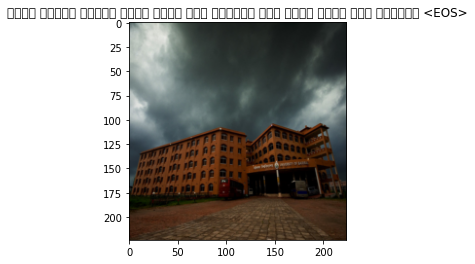

একটি ভবনের সামনে একটি খোলা মাঠ রয়েছে এবং দূরে একটি ভবন রয়েছে <EOS>
Epoch: 14 loss: 2.72322


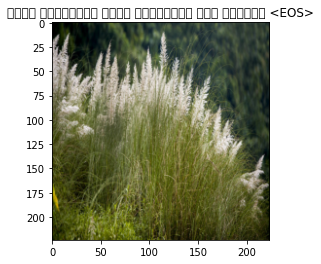

একটি পাহাড়ের মাঝে অনেকগুলো গাছ রয়েছে <EOS>
Epoch: 14 loss: 2.67017


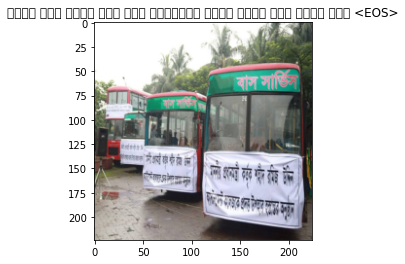

একটি বাস থেমে আছে এবং রাস্তার পাশে একটি বাস থেমে আছে <EOS>
Epoch: 14 loss: 2.76720


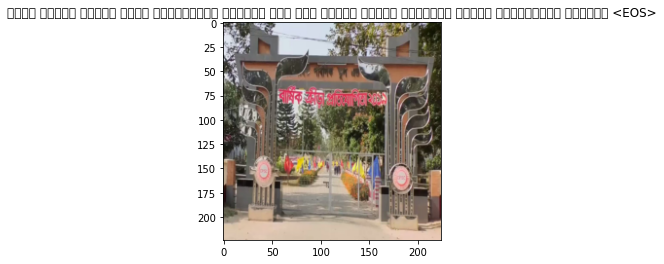

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ফটকের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 14 loss: 2.74997


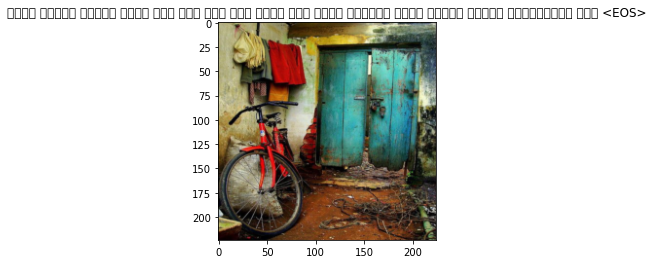

একটি ভবনের সামনে একজন লোক বসে আছে এবং একজন লোক একটি পাত্রে কিছু খাবার নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 14 loss: 2.81573


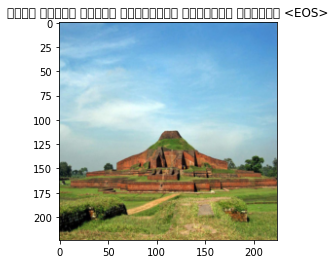

একটি মাঠের মধ্যে অনেকগুলো গাছপালা রয়েছে <EOS>
Epoch: 14 loss: 2.71729


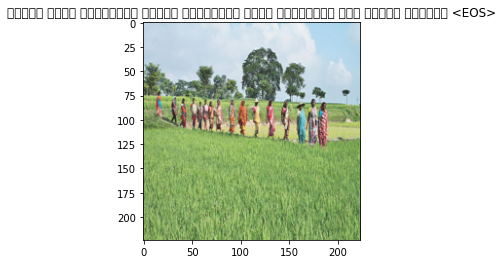

মাঠের মাঝে অনেকগুলো মানুষ সারিবদ্ধ ভাবে অনেকগুলো ধান নিয়ে যাচ্ছে <EOS>
Epoch: 14 loss: 2.83335


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2467 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2467 missing from current font.
  font.set_text(s, 0, flags=flags)


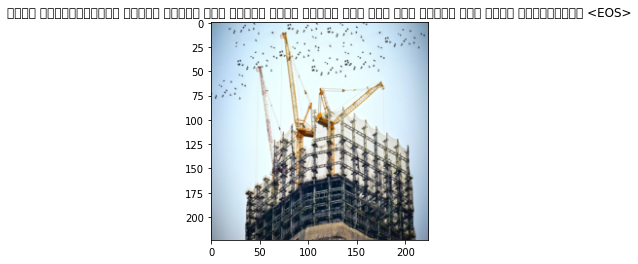

একটি নির্মাণাধীন ভবনের ছাদের উপর দিয়ে একজন মানুষ বসে আছে এবং আকাশে মেঘ ভেসে বেড়াচ্ছে <EOS>
Epoch: 14 loss: 2.68724


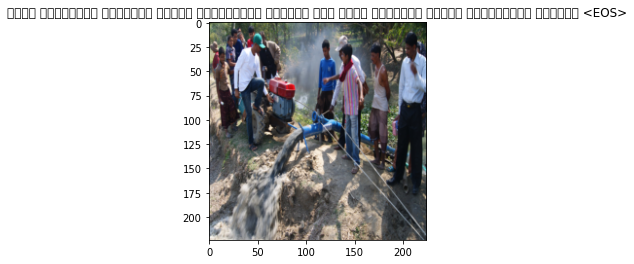

একটি রাস্তায় কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 14 loss: 2.62310


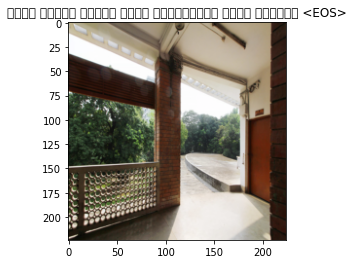

একটি ভবনের সামনে একটি সাইনবোর্ড দেখা যাচ্ছে <EOS>
Epoch: 14 loss: 2.75330


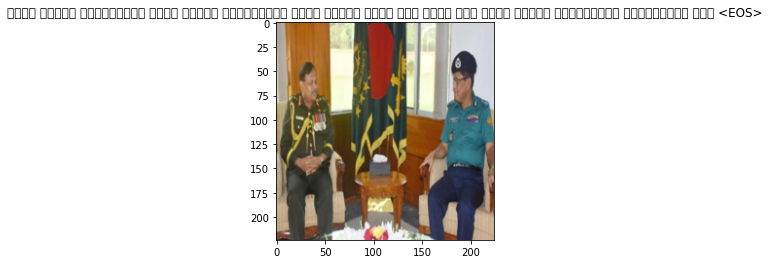

একজন পুলিশ কর্মকর্তা একজন পুলিশ কর্মকর্তা একজন লোকের সাথে কথা বলছে এবং একজন পুলিশ কর্মকর্তা দাঁড়িয়ে আছে <EOS>
Epoch: 14 loss: 2.61242


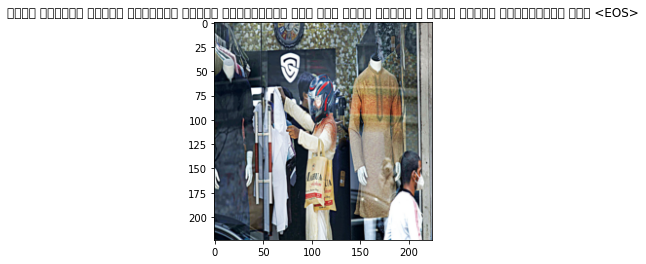

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং একজন মহিলা ও একজন মহিলা দাঁড়িয়ে আছে <EOS>
Epoch: 14 loss: 2.77844


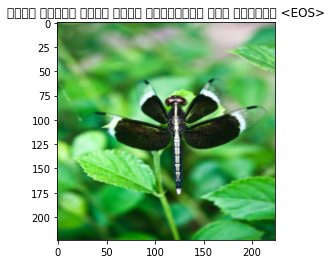

একটি গাছের ডালে একটি প্রজাপতি বসে রয়েছে <EOS>
Epoch: 14 loss: 2.85537


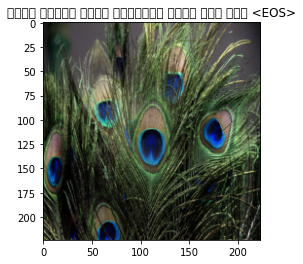

একটি গাছের ডালে কয়েকটি পাখি বসে আছে <EOS>
Epoch: 14 loss: 2.66946


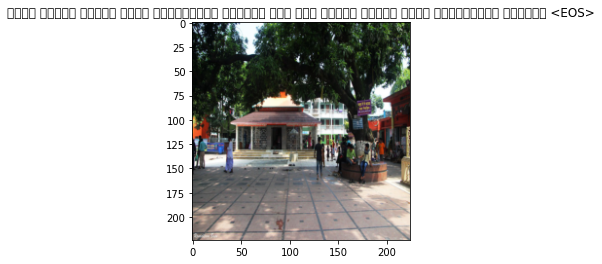

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 15 loss: 2.67147


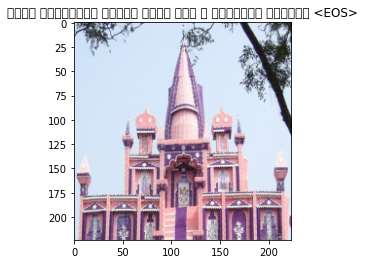

একটি মন্দিরের সামনে একটি গাছ ও গাছপালা রয়েছে <EOS>
Epoch: 15 loss: 2.76880


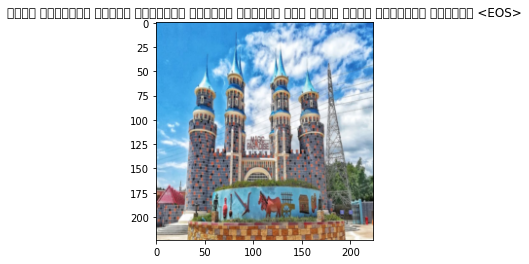

একটি পার্কের মধ্যে কয়েকটি মূর্তি রয়েছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 15 loss: 2.75752


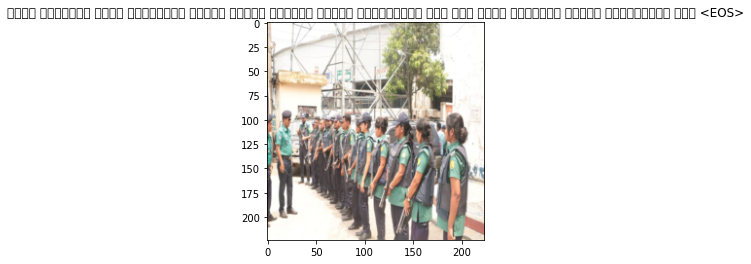

একটি রাস্তার পাশে অনেকগুলো পুলিশ সদস্য অস্ত্র নিয়ে দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 15 loss: 2.57948


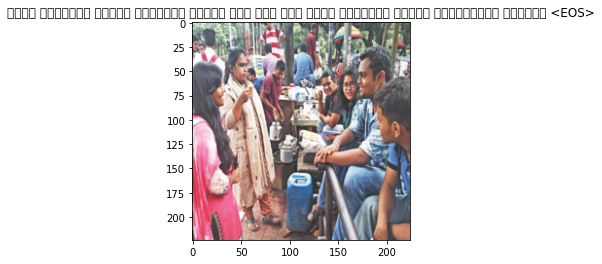

একটি দোকানের সামনে কয়েকজন মানুষ বসে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 15 loss: 2.65735


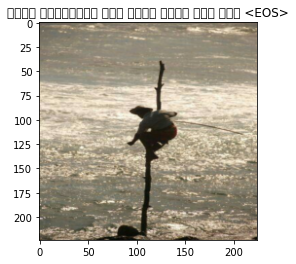

একটি জলাশয়ের উপর একটি পাখি বসে আছে <EOS>
Epoch: 15 loss: 2.65673


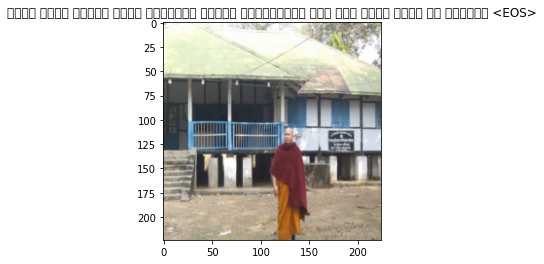

একটি ঘরের সামনে একজন আদিবাসী মহিলা দাঁড়িয়ে আছে এবং পাশে একটি ঘর রয়েছে <EOS>
Epoch: 15 loss: 2.61809


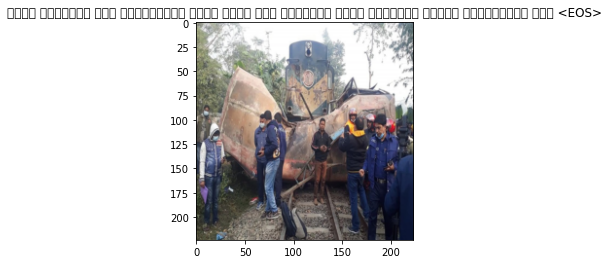

একটি ট্রেনের বগি লাইনচ্যুত হয়ে গেছে এবং ট্রেনের পাশে কয়েকজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 15 loss: 2.70344


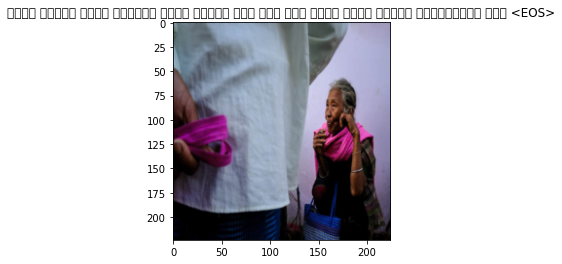

একজন মহিলা একটি শিশুকে কোলে নিয়ে বসে আছে এবং পাশে একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 15 loss: 2.63376


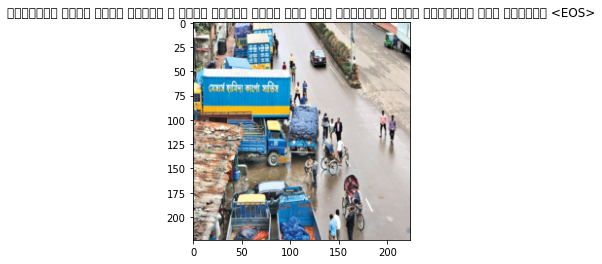

রাস্তার পাশে একটি ট্রাক ও একটি ট্রাক থেমে আছে এবং রাস্তার পাশে কয়েকটি ভবন রয়েছে <EOS>
Epoch: 15 loss: 2.73755


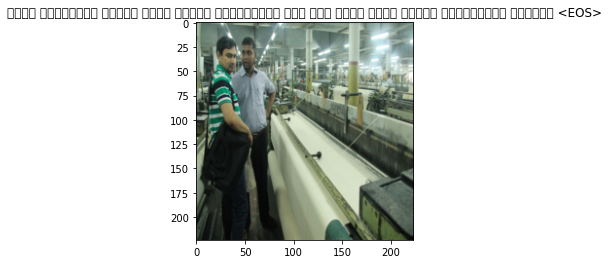

একটি কারখানার ভেতরে একজন মানুষ দাঁড়িয়ে আছে এবং পাশে একজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 15 loss: 2.72322


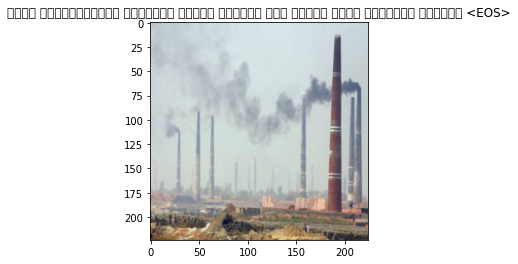

একটি নির্মাণাধীন কয়েকটি চিমনি রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 15 loss: 2.70496


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2499 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2499 missing from current font.
  font.set_text(s, 0, flags=flags)


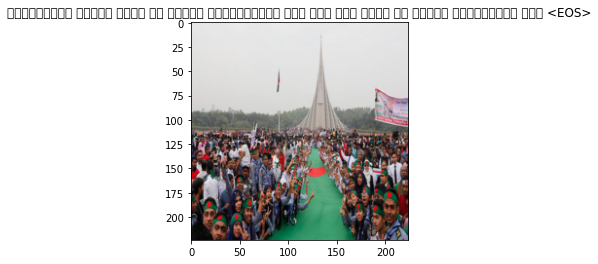

স্বাধীনতা দিবসে অনেক জন মানুষ স্মৃতিসৌধে বসে আছে এবং অনেক জন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 15 loss: 2.69230


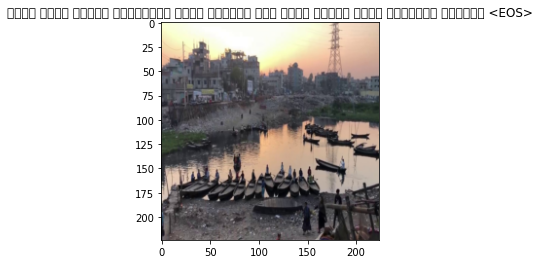

একটি নদীর পাড়ে অনেকগুলো নৌকা রয়েছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 15 loss: 2.76128


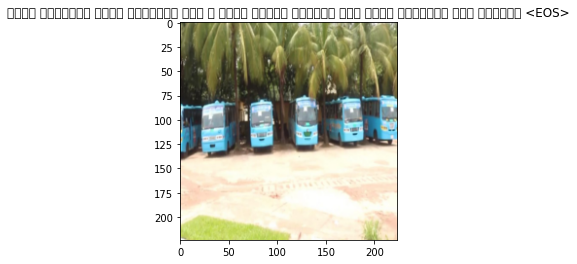

একটি রাস্তার পাশে কয়েকটি বাস ও কিছু মানুষ রয়েছে এবং পাশে কয়েকটি গাছ রয়েছে <EOS>
Epoch: 15 loss: 2.56524


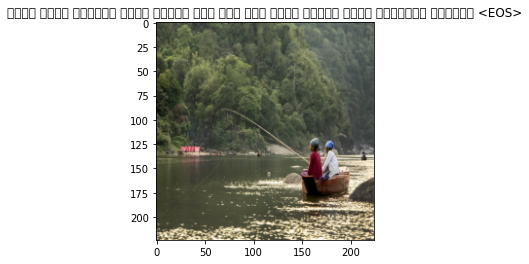

একটি নদীর পানিতে একজন মানুষ বসে আছে এবং নদীর পাড়ে কিছু গাছপালা রয়েছে <EOS>
Epoch: 15 loss: 2.63519


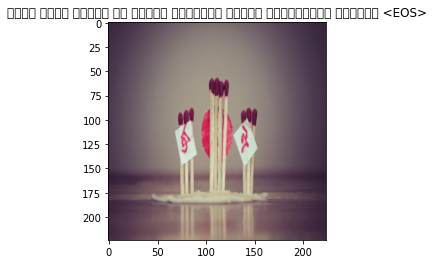

একটি শহীদ মিনার এর মধ্যে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 15 loss: 2.72406


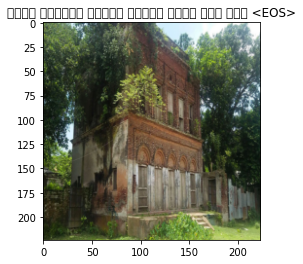

একটি পুরাতন ভবনের সামনে একটি গাছ আছে <EOS>
Epoch: 16 loss: 2.74386


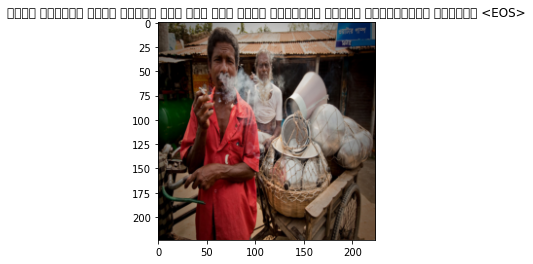

একটি দোকানে একজন মহিলা বসে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 16 loss: 2.60611


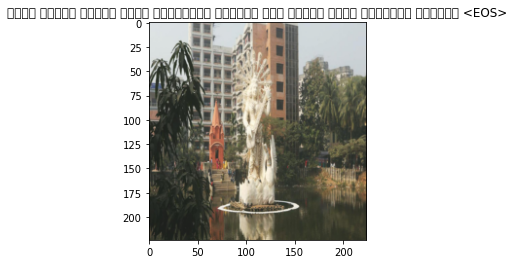

একটি ভবনের সামনে একটি ভাস্কর্য রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 16 loss: 2.62775


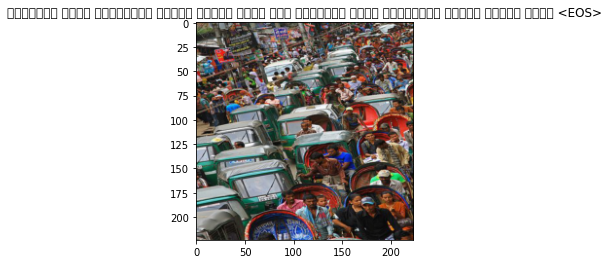

রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে এবং রাস্তার পাশে অনেকগুলো মানুষ চলাচল করছে <EOS>
Epoch: 16 loss: 2.62531


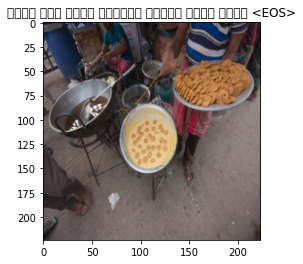

একজন লোক একটি পাত্রে খাবার তৈরি করছে <EOS>
Epoch: 16 loss: 2.55315


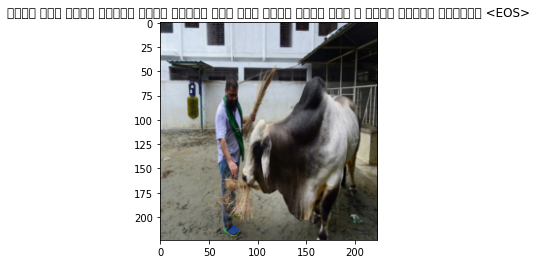

একজন লোক একটি গরুকে একটি গরুকে আছে এবং পাশে একটি গরু ও একটি কুকুর রয়েছে <EOS>
Epoch: 16 loss: 2.53242


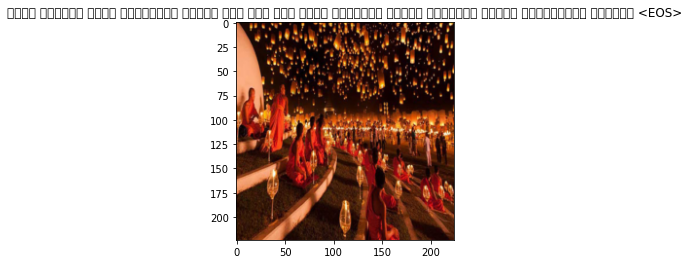

একটি কক্ষের ভেতর অনেকগুলো মানুষ বসে আছে এবং একটি টেবিলের সামনে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 16 loss: 2.62931


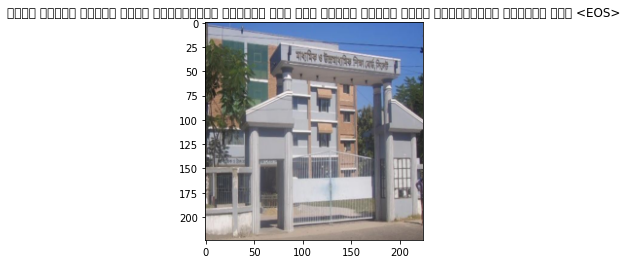

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Epoch: 16 loss: 2.57570


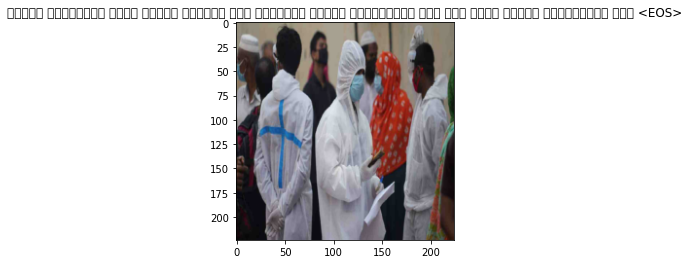

করোনা মহামারীর সময় মাস্ক পরিধান করে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 16 loss: 2.69457


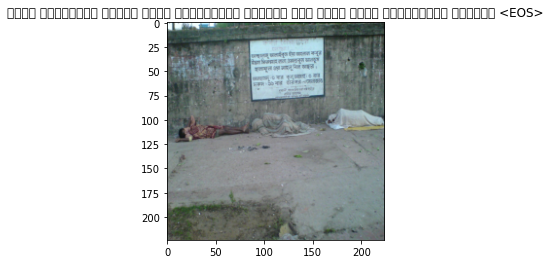

একটি দেয়ালের সামনে একটি সাইনবোর্ড রয়েছে এবং পাশে একটি সাইনবোর্ড রয়েছে <EOS>
Epoch: 16 loss: 2.59725


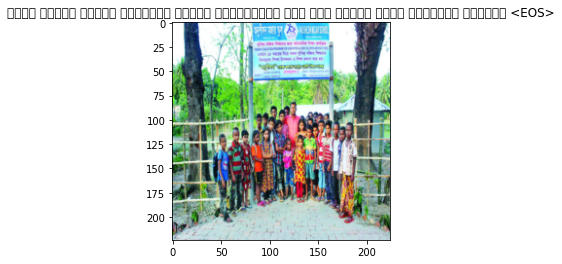

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং সামনে একটি ব্যানার রয়েছে <EOS>
Epoch: 16 loss: 2.62992


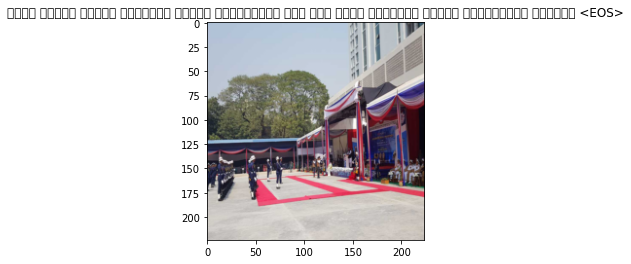

একটি ভবনের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Epoch: 16 loss: 2.70906


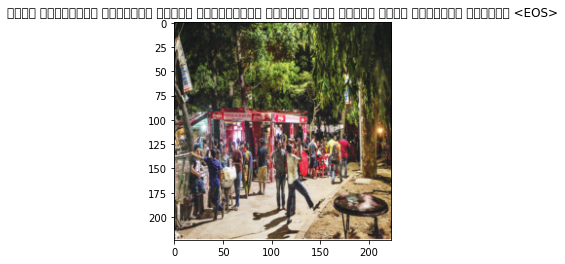

একটি রাস্তায় কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Epoch: 16 loss: 2.76951


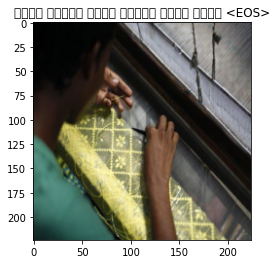

একজন মানুষ একটি কাপড় তৈরি করছে <EOS>
Epoch: 16 loss: 2.67939


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2457 missing from current font.
  font.set_text(s, 0, flags=flags)


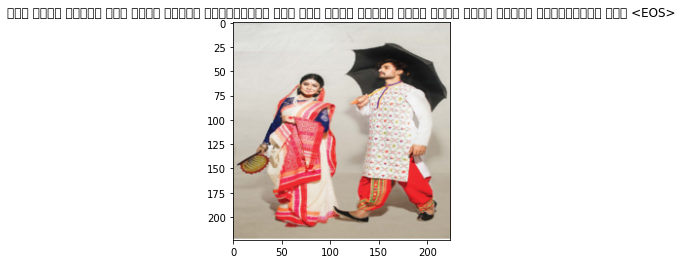

লাল রঙের শাড়ি পরা একজন মেয়ে দাঁড়িয়ে আছে এবং একজন মেয়ে হাতে একটি ছাতা নিয়ে দাঁড়িয়ে আছে <EOS>
Epoch: 16 loss: 2.65036


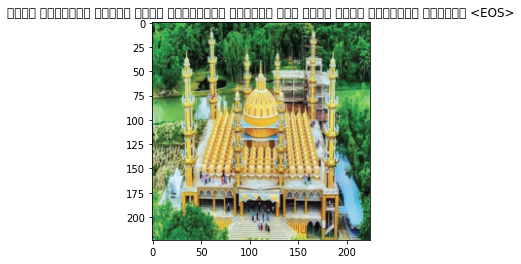

একটি পার্কের মধ্যে একটি ভাস্কর্য রয়েছে এবং পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 16 loss: 2.54511


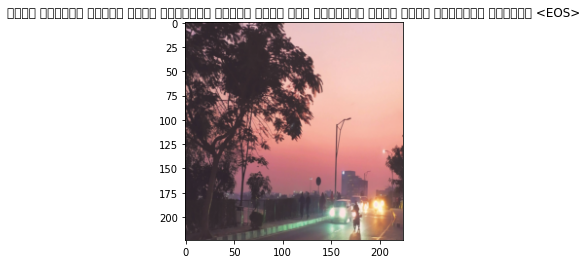

একটি রাস্তা দিয়ে কিছু যানবাহন চলাচল করছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Epoch: 16 loss: 2.51348


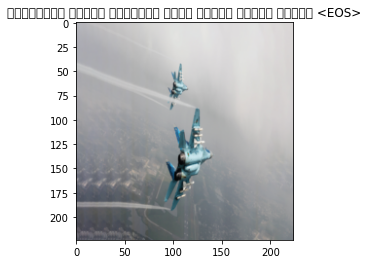

বাংলাদেশ বিমান বাহিনীর একটি বিমান আকাশে উড়ছে <EOS>
Epoch: 17 loss: 2.54783


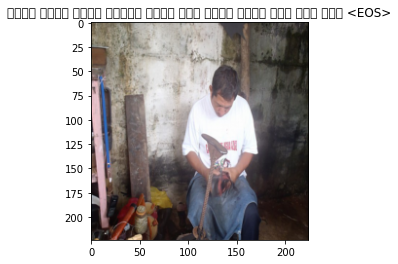

একজন মুচি জুতা সেলাই করছে এবং পাশে একজন লোক বসে আছে <EOS>
Epoch: 17 loss: 2.59965


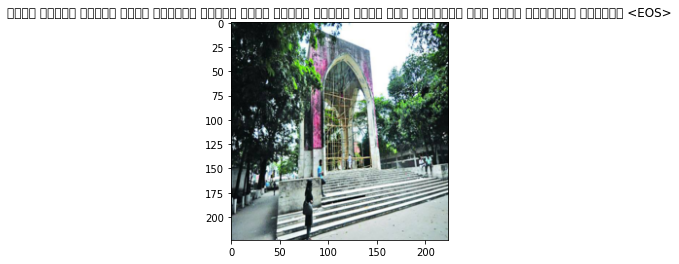

একটি ভবনের সামনে একটি রাস্তা দিয়ে কিছু মানুষ চলাচল করছে এবং রাস্তার দুই পাশে গাছপালা রয়েছে <EOS>
Epoch: 17 loss: 2.55205


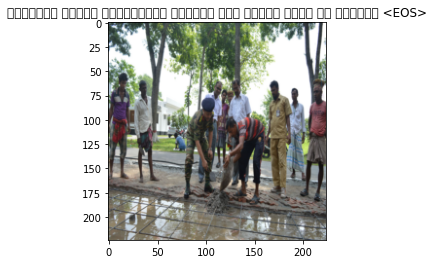

কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে একটি ঘর রয়েছে <EOS>
Epoch: 17 loss: 2.52531


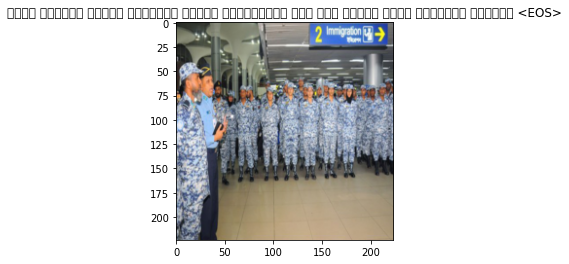

একটি কক্ষের ভেতরে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং সামনে একটি ব্যানার রয়েছে <EOS>
Epoch: 17 loss: 2.64958


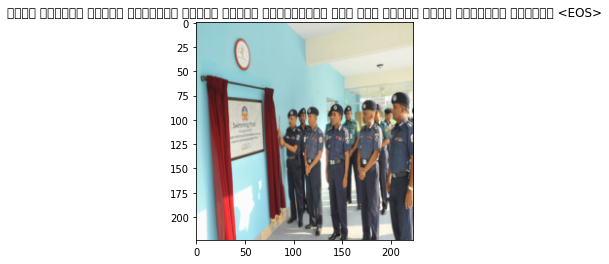

একটি কক্ষের ভেতরে কয়েকজন পুলিশ সদস্য দাঁড়িয়ে আছে এবং পিছনে একটি ব্যানার রয়েছে <EOS>
Epoch: 17 loss: 2.61823


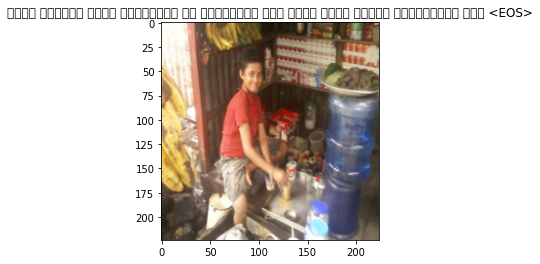

একটি দোকানে একজন দোকানদার চা বানাচ্ছে এবং পাশে একজন মানুষ দাঁড়িয়ে আছে <EOS>
Epoch: 17 loss: 2.49835


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2527 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2527 missing from current font.
  font.set_text(s, 0, flags=flags)


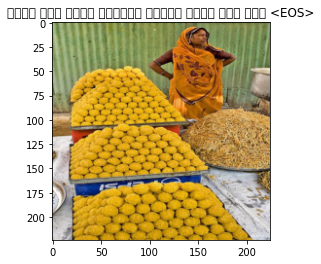

একজন লোক একটি পাত্রে খাবার নিয়ে বসে আছে <EOS>


In [ ]:
num_epochs = 25
print_every = 10
 
for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image,captions = image.to(device),captions.to(device)
 
        # Zero the gradients.
        optimizer.zero_grad()
 
        # Feed forward
        outputs,attentions = model(image, captions)
 
        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
 
        # Update the parameters in the optimizer.
        optimizer.step()
 
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                print(caption)
                
            model.train()
        
    #save the latest model
    save_model(model,epoch)

## 6 Visualizing the attentions
Defining helper functions
<li>Given the image generate captions and attention scores</li>
<li>Plot the attention scores in the image</li>

In [ ]:
# import torch
# # from modelfolder import yourmodel

# model_path = "/content/drive/MyDrive/image_captioning/model/attention_model_state__freq_thers_2__batch_256__num_worker__4.pth"
model_path = '/content/drive/MyDrive/image_captioning/model/attention_model_state__with_threshold_freq_1__batch_size_128__num_worker_2.pth'
# checkpoint = torch.load(model_path)
# try:
#     checkpoint.eval()
# except AttributeError as error:
#     print("Error", error)
# ### 'dict' object has no attribute 'eval'

# model.load_state_dict(checkpoint['state_dict'])
# ### now you can evaluate it
# model.eval()
# print("Finished")
# # model.load_state_dict(torch.load(model_path))
# model.eval()

model.load_state_dict(torch.load(model_path)['state_dict'])
model.eval()
print()

In [ ]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)
        print(caption)
    
    return caps,alphas

#Show attention
def plot_attention(img, result, attention_plot):
    #untransform
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    temp_image = img

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7,7)
        
        ax = fig.add_subplot(len_result//2,len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())
        

    plt.tight_layout()
    plt.show()


def print_examples(model, device, dataset):

    #defining the transform to be applied
    transform = T.Compose([
        T.Resize((224,224)),                     
        # T.RandomCrop(224),                 
        T.ToTensor(),                               
        T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
    ])

    test_img1 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/dog.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 1 CORRECT: Dog on a beach by the ocean")
    print("Example 1 OUTPUT: \n")
    get_caps_from(test_img1)


    test_img36 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/36.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 36 CORRECT: একটি দোকানের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং দোকানে অনেক ধরনের পণ্য সামগ্রী রয়েছে।")
    print("Example 36 OUTPUT: \n")
    get_caps_from(test_img36)

    test_img7 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/7.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।")
    print("Example 7 OUTPUT: \n")
    get_caps_from(test_img7)


    test_img1 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/dog.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 1 CORRECT: Dog on a beach by the ocean")
    print(
        "Example 1 OUTPUT: "
    )
    get_caps_from(test_img1)


    test_img2 = transform(
        Image.open("/content/drive/MyDrive/image_captioning/test_examples/child.jpg").convert("RGB")
    ).unsqueeze(0)
    print("Example 2 CORRECT: Child holding red frisbee outdoors")
    print(
        "Example 2 OUTPUT: " )
    get_caps_from(test_img2)


    test_img3 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/bus.png").convert("RGB")).unsqueeze(
        0
    )
    print("Example 3 CORRECT: Bus driving by parked cars")
    print(
        "Example 3 OUTPUT: " )
    get_caps_from(test_img3)


    test_img4 = transform(
        Image.open("/content/drive/MyDrive/image_captioning/test_examples/boat.png").convert("RGB")
    ).unsqueeze(0)
    print("Example 4 CORRECT: A small boat in the ocean")
    print(
        "Example 4 OUTPUT: " )
    get_caps_from(test_img4)


    test_img5 = transform(
        Image.open("/content/drive/MyDrive/image_captioning/test_examples/horse.png").convert("RGB")
    ).unsqueeze(0)
    print("Example 5 CORRECT: A cowboy riding a horse in the desert")
    print(
        "Example 5 OUTPUT: " )
    get_caps_from(test_img5)


    test_img6 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/6.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 6 CORRECT: রাস্তার পাশের দোকানে একজন লোক অনেকগুলো মাঠা তৈরি করছে বিক্রি করার জন্য এবং দোকানের বাইরে কালো টি-শার্ট পরে একজন দাঁড়িয়ে লোক আছে ও রাস্তা দিয়ে কিছু মানুষ চলাচল করছে।")
    print(
        "Example 6 OUTPUT: " )
    get_caps_from(test_img6)


    test_img7 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/7.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।")
    print(
        "Example 7 OUTPUT: " )
    get_caps_from(test_img7)


    test_img8 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/8.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 8 CORRECT: প্লেনের মধ্যে অনেকগুলো কালো পোশাক পরা বাংলাদেশ সশস্ত্র বাহিনীর কয়েকজন সদস্য বসে রয়েছে ও আরো সামনের আসনে এক পাশে দুইজন মহিলা বসে রয়েছে আরেক পাশে বাংলাদেশ সশস্ত্র বাহিনীর একজন সদস্যের সাথে আরও একজন মহিলা বসে রয়েছে।")
    print(
        "Example 8 OUTPUT: " )
    get_caps_from(test_img8)


    test_img9 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/9.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 9 CORRECT: অনেকগুলো পাহাড়ের সামনে একজন মেয়ে হাত বাড়িয়ে দাঁড়িয়ে রয়েছে।")
    print(
        "Example 9 OUTPUT: " )
    get_caps_from(test_img9)


    test_img10 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/10.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 10 CORRECT: অনেকগুলো ভবন গাছপালা ও একটি স্টেডিয়ামের সামনে বড় একটি দিঘি রয়েছে।")
    print(
        "Example 10 OUTPUT: " )
    get_caps_from(test_img10)

    
    test_img11 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/11.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 11 CORRECT: রাস্তার পাশে কয়েকটি দোকানে কয়েকজন লোক অবস্থান নিয়েছে বৃষ্টি থেকে বাঁচার জন্য এবং রাস্তার পাশের দোকানের সামনে একটি রিক্সা রয়েছে।")
    print(
        "Example 11 OUTPUT: " )
    get_caps_from(test_img11)

    
    test_img12 = transform(Image.open("/content/drive/MyDrive/image_captioning/test_examples/12.jpg").convert("RGB")).unsqueeze(
        0
    )
    print("Example 12 CORRECT: দুইটি ভবনের মাঝে অনেকগুলো লোক দাঁড়িয়ে রয়েছে এবং মাটিতে অনেকগুলো মাছ ফেলে রাখা হয়েছে ও কিছু মানুষ কিছু মাছ সংগ্রহ করে কয়েকটি পাত্রে রাখছে।")
    print(
        "Example 12 OUTPUT: " )
    get_caps_from(test_img12)



Example 1 CORRECT: Dog on a beach by the ocean
Example 1 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2478 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2494 missing from current font.
  font.set_text(s

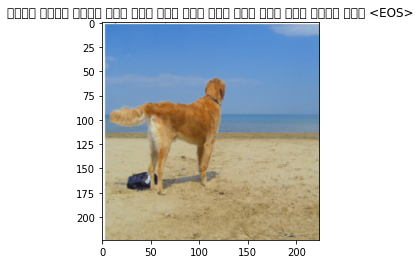

একটি মাঠে একটি ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছেলে আছে <EOS>
Example 36 CORRECT: একটি দোকানের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং দোকানে অনেক ধরনের পণ্য সামগ্রী রয়েছে।
Example 36 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2470 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2480 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2488 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2455 missing from current font.
  font.set_text(s

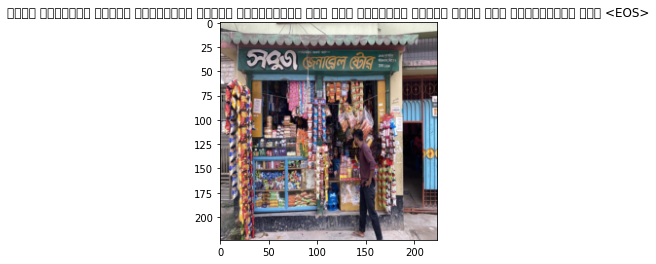

একটি দোকানের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং দোকানের সামনে একজন লোক দাঁড়িয়ে আছে <EOS>
Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।
Example 7 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2477 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2439 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2509 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2477 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2458 missing from current font.
  font.set_text(s, 

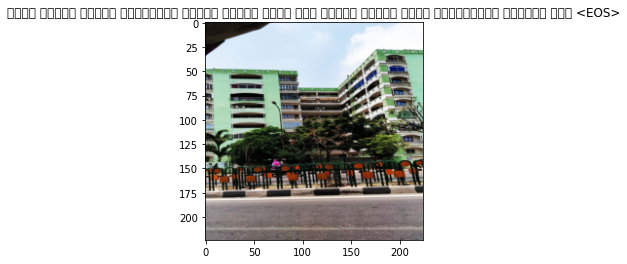

একটি ভবনের সামনে অনেকগুলো মানুষ চলাচল করছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Example 1 CORRECT: Dog on a beach by the ocean
Example 1 OUTPUT: 


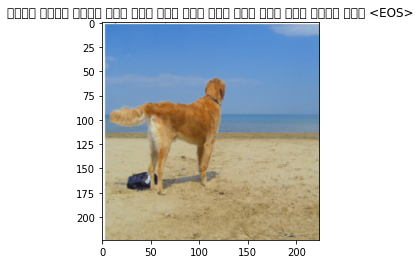

একটি মাঠে একটি ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছেলে আছে <EOS>
Example 2 CORRECT: Child holding red frisbee outdoors
Example 2 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2486 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2486 missing from current font.
  font.set_text(s, 0, flags=flags)


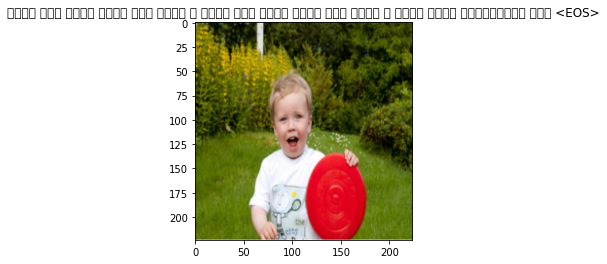

একটি ছোট ছেলে একটি ছোট ছেলে ও একটি ছোট ছেলে একটি ছোট ছেলে ও একটি শিশু দাঁড়িয়ে আছে <EOS>
Example 3 CORRECT: Bus driving by parked cars
Example 3 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0,

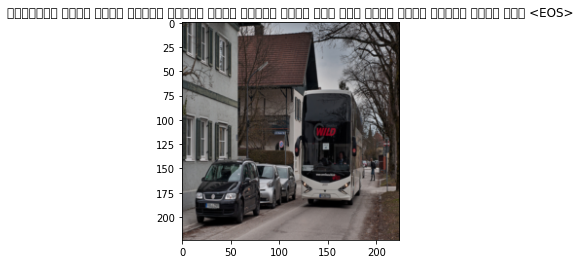

রাস্তার পাশে একটি ভবনের সামনে একটি গাড়ি থেমে আছে এবং পাশে একটি গাড়ি থেমে আছে <EOS>
Example 4 CORRECT: A small boat in the ocean
Example 4 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2471 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0,

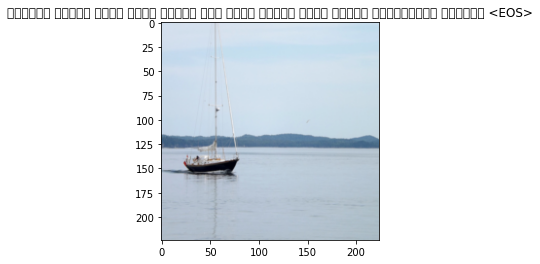

সাগরের মধ্যে একটি নৌকা ভাসছে এবং নদীর পাড়ে একজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Example 5 CORRECT: A cowboy riding a horse in the desert
Example 5 OUTPUT: 


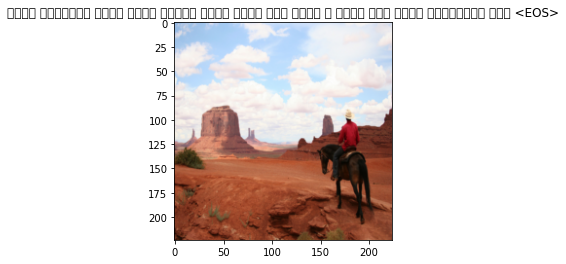

একটি রাস্তার পাশে একটি গাছের নিচে একটি ছোট ছেলে ও একটি ছোট ছেলে দাড়িয়ে আছে <EOS>
Example 6 CORRECT: রাস্তার পাশের দোকানে একজন লোক অনেকগুলো মাঠা তৈরি করছে বিক্রি করার জন্য এবং দোকানের বাইরে কালো টি-শার্ট পরে একজন দাঁড়িয়ে লোক আছে ও রাস্তা দিয়ে কিছু মানুষ চলাচল করছে।
Example 6 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2504 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2504 missing from current font.
  font.set_text(s, 0, flags=flags)


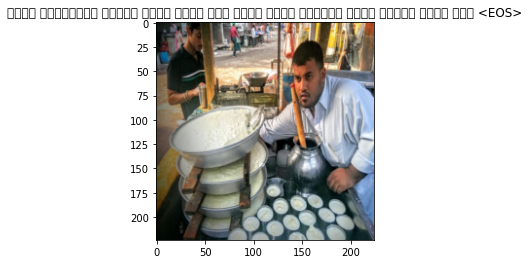

একজন বাবুর্চি খাদ্য তৈরি করছে এবং পাশে একটি পাত্রে কিছু খাবার রাখা আছে <EOS>
Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।
Example 7 OUTPUT: 


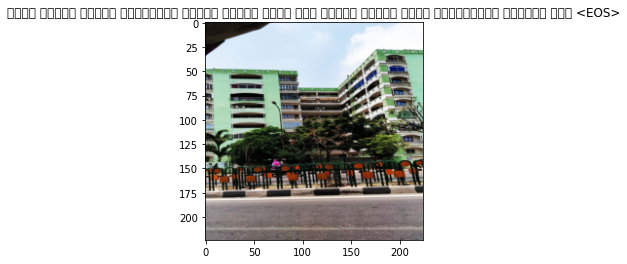

একটি ভবনের সামনে অনেকগুলো মানুষ চলাচল করছে এবং ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে <EOS>
Example 8 CORRECT: প্লেনের মধ্যে অনেকগুলো কালো পোশাক পরা বাংলাদেশ সশস্ত্র বাহিনীর কয়েকজন সদস্য বসে রয়েছে ও আরো সামনের আসনে এক পাশে দুইজন মহিলা বসে রয়েছে আরেক পাশে বাংলাদেশ সশস্ত্র বাহিনীর একজন সদস্যের সাথে আরও একজন মহিলা বসে রয়েছে।
Example 8 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2456 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2456 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2489 missing from current font.
  font.set_text(s, 0, flags=flags)


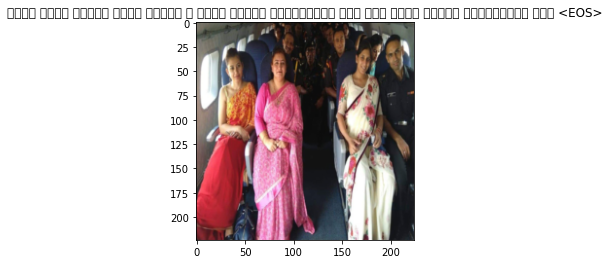

একটি ঘরের সামনে একজন মহিলা ও একজন মহিলা দাঁড়িয়ে আছে এবং একজন মহিলা দাঁড়িয়ে আছে <EOS>
Example 9 CORRECT: অনেকগুলো পাহাড়ের সামনে একজন মেয়ে হাত বাড়িয়ে দাঁড়িয়ে রয়েছে।
Example 9 OUTPUT: 


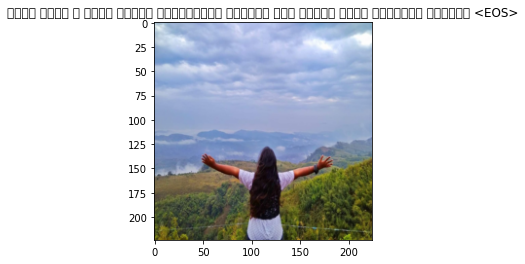

একটি ছেলে ও একটি মেয়ে দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Example 10 CORRECT: অনেকগুলো ভবন গাছপালা ও একটি স্টেডিয়ামের সামনে বড় একটি দিঘি রয়েছে।
Example 10 OUTPUT: 


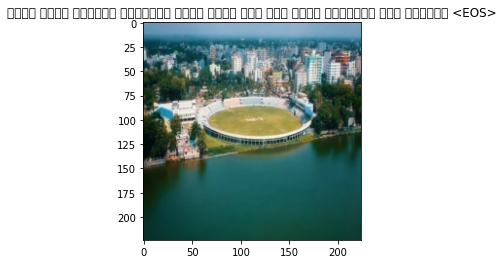

একটি নদীর কিনারে কয়েকটি নৌকা থেমে আছে এবং পাশে কয়েকটি ভবন রয়েছে <EOS>
Example 11 CORRECT: রাস্তার পাশে কয়েকটি দোকানে কয়েকজন লোক অবস্থান নিয়েছে বৃষ্টি থেকে বাঁচার জন্য এবং রাস্তার পাশের দোকানের সামনে একটি রিক্সা রয়েছে।
Example 11 OUTPUT: 


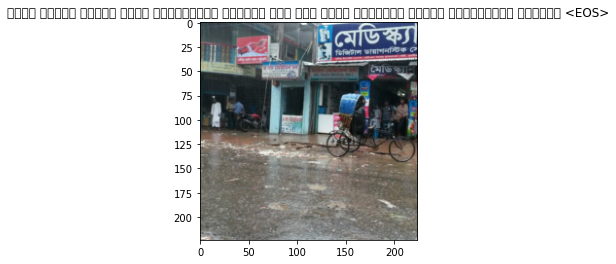

একটি ভবনের সামনে একটি সাইনবোর্ড লাগানো আছে এবং পাশে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে <EOS>
Example 12 CORRECT: দুইটি ভবনের মাঝে অনেকগুলো লোক দাঁড়িয়ে রয়েছে এবং মাটিতে অনেকগুলো মাছ ফেলে রাখা হয়েছে ও কিছু মানুষ কিছু মাছ সংগ্রহ করে কয়েকটি পাত্রে রাখছে।
Example 12 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2499 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2499 missing from current font.
  font.set_text(s, 0, flags=flags)


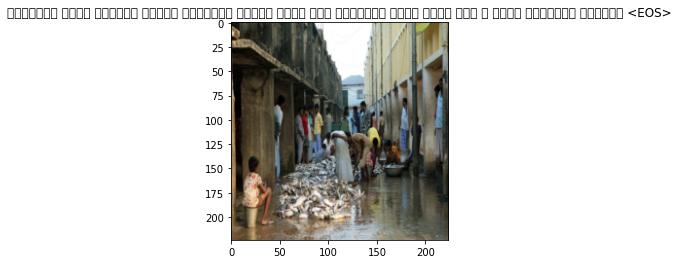

বৃষ্টির সময় রাস্তা দিয়ে যানবাহন চলাচল করছে এবং রাস্তার পাশে একটি ভবন ও কিছু গাছপালা রয়েছে <EOS>


In [ ]:
#with thershold_freq = 1
print_examples(model, device, dataset)

Example 1 CORRECT: Dog on a beach by the ocean
Example 1 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2478 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2494 missing from current font.
  font.set_text(s

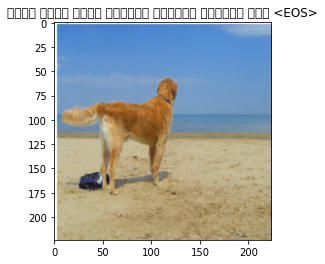

একটি মাঠে একটি সিংহের বাচ্চা দাড়িয়ে আছে <EOS>
Example 36 CORRECT: একটি দোকানের সামনে একজন মানুষ দাঁড়িয়ে আছে এবং দোকানে অনেক ধরনের পণ্য সামগ্রী রয়েছে।
Example 36 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2507 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2479 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2492 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2460 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2497 missing from current font.
  font.set_text(s

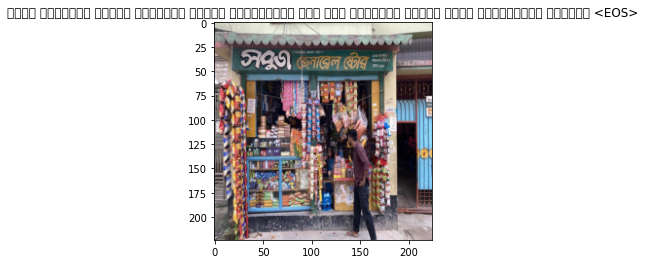

একটি দোকানের সামনে কয়েকজন মানুষ দাঁড়িয়ে আছে এবং দোকানের সামনে একটি সাইনবোর্ড রয়েছে <EOS>
Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।
Example 7 OUTPUT: 



/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2482 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2477 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2437 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2455 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2468 missing from current font.
  font.set_text(s

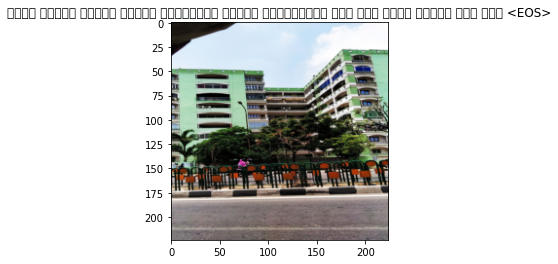

একটি বহুতল ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং কিছু মানুষ বসে আছে <EOS>
Example 1 CORRECT: Dog on a beach by the ocean
Example 1 OUTPUT: 


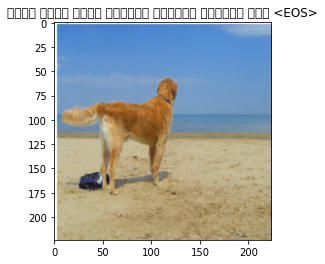

একটি মাঠে একটি সিংহের বাচ্চা দাড়িয়ে আছে <EOS>
Example 2 CORRECT: Child holding red frisbee outdoors
Example 2 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2474 missing from current font.
  font.set_text(s, 0, flags=flags)


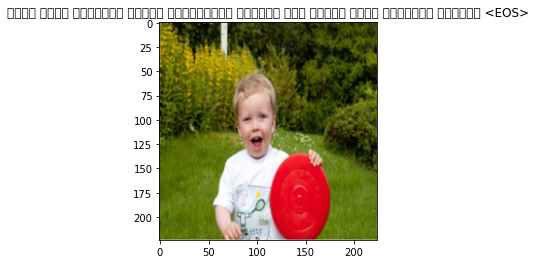

একটি মাঠে কয়েকজন মানুষ দাঁড়িয়ে রয়েছে এবং পিছনে কিছু গাছপালা রয়েছে <EOS>
Example 3 CORRECT: Bus driving by parked cars
Example 3 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2486 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2486 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2451 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2469 missing from current font.
  font.set_text(s, 0,

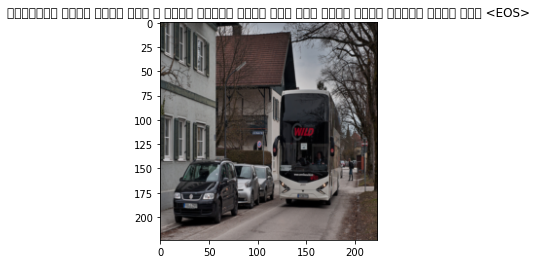

রাস্তার পাশে একটি বাস ও একটি গাড়ি থেমে আছে এবং পাশে একটি গাড়ি থেমে আছে <EOS>
Example 4 CORRECT: A small boat in the ocean
Example 4 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2461 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2496 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2461 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2508 missing from current font.
  font.set_text(s, 0,

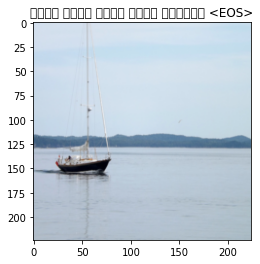

নদীর মাঝে একটি নৌকা রয়েছে <EOS>
Example 5 CORRECT: A cowboy riding a horse in the desert
Example 5 OUTPUT: 


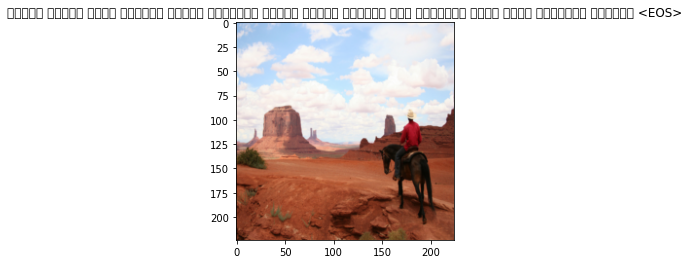

শীতের সকালে একটি রাস্তা দিয়ে কয়েকজন মানুষ হেঁটে যাচ্ছে এবং রাস্তার পাশে কিছু গাছপালা রয়েছে <EOS>
Example 6 CORRECT: রাস্তার পাশের দোকানে একজন লোক অনেকগুলো মাঠা তৈরি করছে বিক্রি করার জন্য এবং দোকানের বাইরে কালো টি-শার্ট পরে একজন দাঁড়িয়ে লোক আছে ও রাস্তা দিয়ে কিছু মানুষ চলাচল করছে।
Example 6 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2454 missing from current font.
  font.set_text(s, 0, flags=flags)


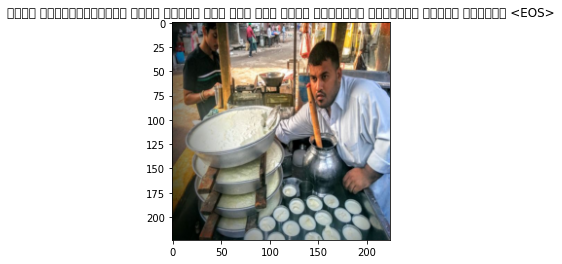

একটি রেস্টুরেন্টে একজন মানুষ বসে আছে এবং পাশে কয়েকটি খাবারের পাত্র রয়েছে <EOS>
Example 7 CORRECT: দুইটি একই রঙের ভবনের সামনে কয়েকটি গাছপালা রয়েছে এবং গাছপালাগুলো সামনে ফাঁকা রাস্তার মধ্য দিয়ে একজন মহিলা হেটে যাচ্ছে ও রাস্তার মাঝে রাস্তা বিভাজক রয়েছে।
Example 7 OUTPUT: 


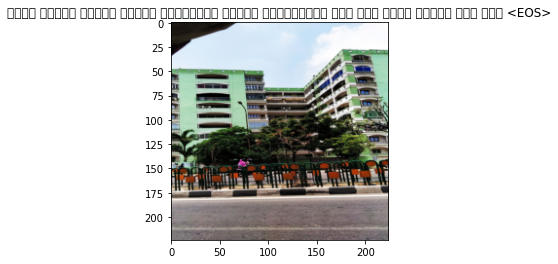

একটি বহুতল ভবনের সামনে অনেকগুলো মানুষ দাঁড়িয়ে আছে এবং কিছু মানুষ বসে আছে <EOS>
Example 8 CORRECT: প্লেনের মধ্যে অনেকগুলো কালো পোশাক পরা বাংলাদেশ সশস্ত্র বাহিনীর কয়েকজন সদস্য বসে রয়েছে ও আরো সামনের আসনে এক পাশে দুইজন মহিলা বসে রয়েছে আরেক পাশে বাংলাদেশ সশস্ত্র বাহিনীর একজন সদস্যের সাথে আরও একজন মহিলা বসে রয়েছে।
Example 8 OUTPUT: 


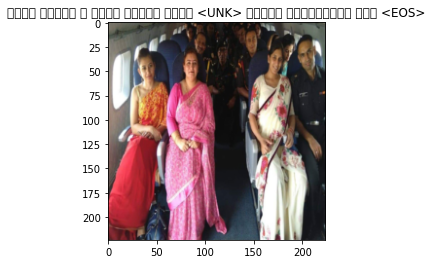

একজন মহিলা ও একজন মহিলা একটি <UNK> সামনে দাঁড়িয়ে আছে <EOS>
Example 9 CORRECT: অনেকগুলো পাহাড়ের সামনে একজন মেয়ে হাত বাড়িয়ে দাঁড়িয়ে রয়েছে।
Example 9 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2475 missing from current font.
  font.set_text(s, 0, flags=flags)


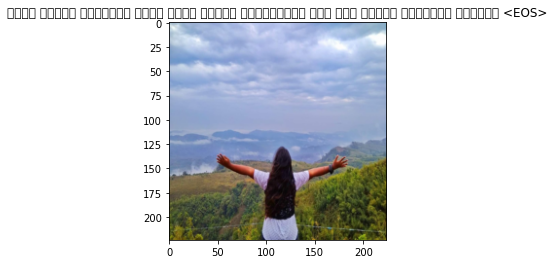

একটি ফসলের ক্ষেতের পাশে একজন মানুষ দাঁড়িয়ে আছে এবং পেছনে গাছপালা রয়েছে <EOS>
Example 10 CORRECT: অনেকগুলো ভবন গাছপালা ও একটি স্টেডিয়ামের সামনে বড় একটি দিঘি রয়েছে।
Example 10 OUTPUT: 


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 2441 missing from current font.
  font.set_text(s, 0, flags=flags)


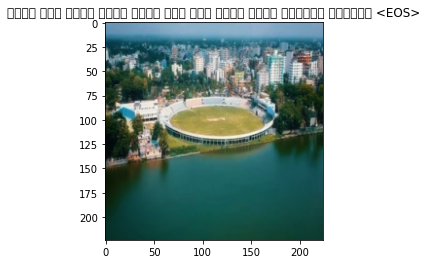

নদীর উপর একটি নৌকা থেমে আছে এবং পাশে একটি জলাশয় রয়েছে <EOS>
Example 11 CORRECT: রাস্তার পাশে কয়েকটি দোকানে কয়েকজন লোক অবস্থান নিয়েছে বৃষ্টি থেকে বাঁচার জন্য এবং রাস্তার পাশের দোকানের সামনে একটি রিক্সা রয়েছে।
Example 11 OUTPUT: 


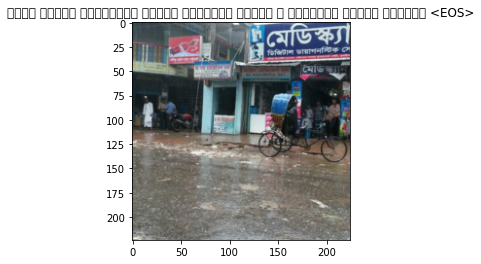

একটি ফিলিং স্টেশনের সামনে কয়েকটি গাড়ি ও কয়েকজন মানুষ রয়েছে <EOS>
Example 12 CORRECT: দুইটি ভবনের মাঝে অনেকগুলো লোক দাঁড়িয়ে রয়েছে এবং মাটিতে অনেকগুলো মাছ ফেলে রাখা হয়েছে ও কিছু মানুষ কিছু মাছ সংগ্রহ করে কয়েকটি পাত্রে রাখছে।
Example 12 OUTPUT: 


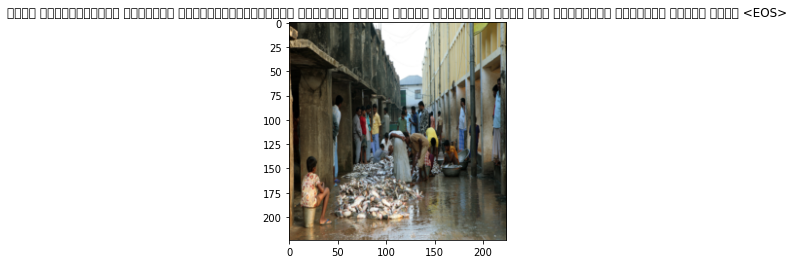

সিটি কর্পোরেশনের কয়েকজন পরিচ্ছন্নতাকর্মী রাস্তার পাশের ময়লা পরিষ্কার করছে এবং রাস্তায় যানবাহন চলাচল করছে <EOS>


In [ ]:
#with thershold_freq = 2
print_examples(model, device, dataset)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: Runtime

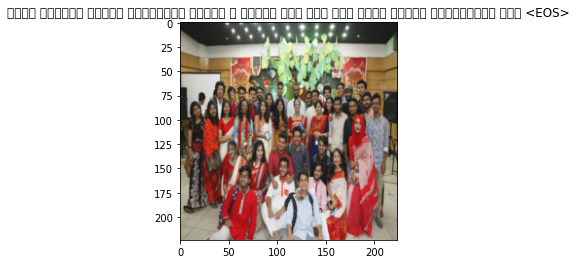

একটি কক্ষের ভেতরে অনেকগুলো মেয়ে ও মেয়ে বসে আছে এবং একজন মেয়ে দাঁড়িয়ে আছে <EOS>


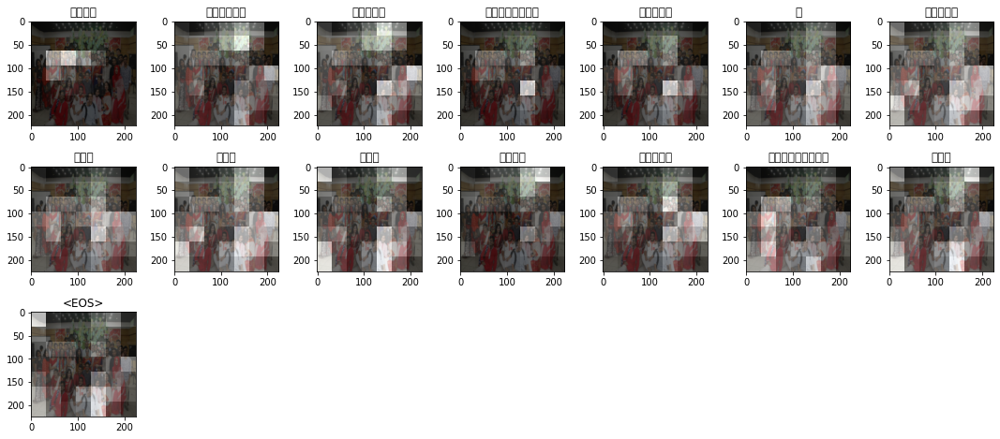

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2465 missing from current font.
  font.

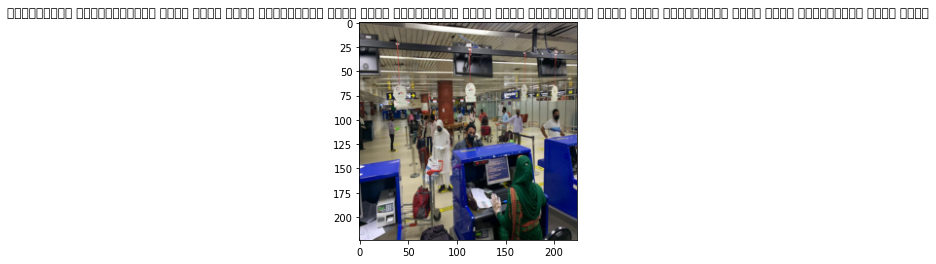

ডাইনোসরের দৃষ্টিনন্দন শুকর শুকর শুকর ডাইনোসরের শুকর শুকর ডাইনোসরের শুকর শুকর ডাইনোসরের শুকর শুকর ডাইনোসরের শুকর শুকর ডাইনোসরের শুকর শুকর


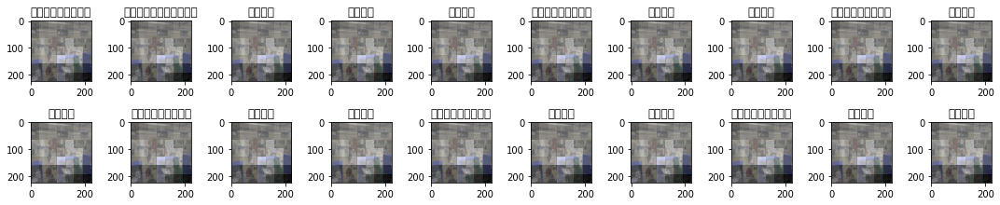

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2480 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2494 missing from current font.
  font.set_text(s

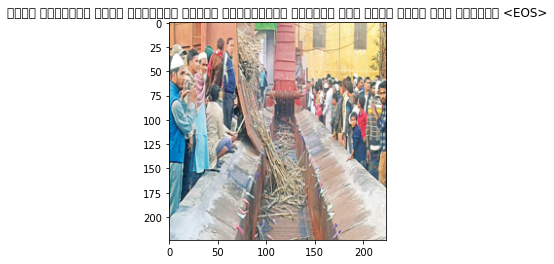

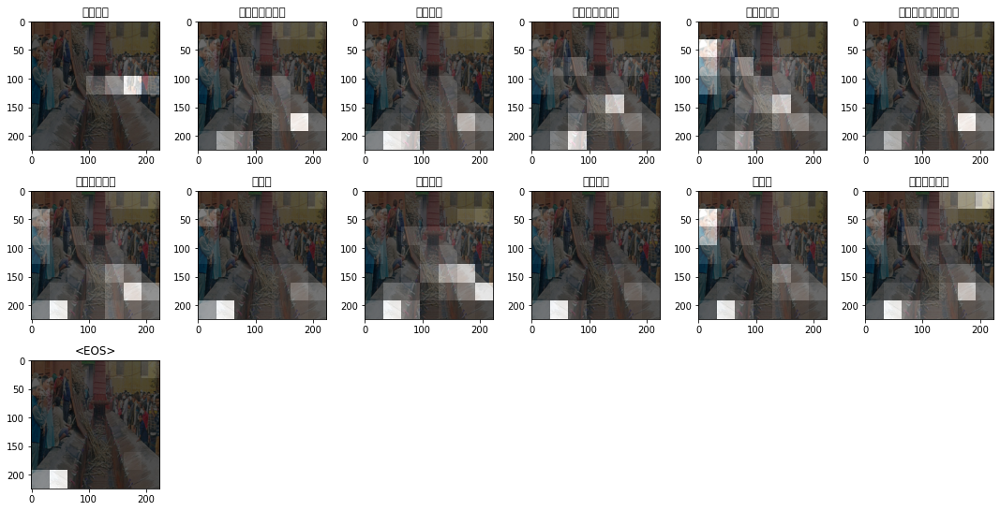

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2479 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2492 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2503 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2460 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s

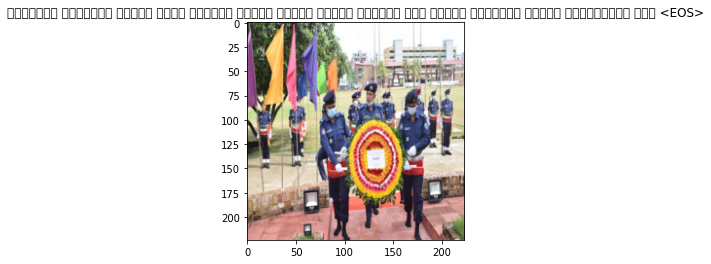

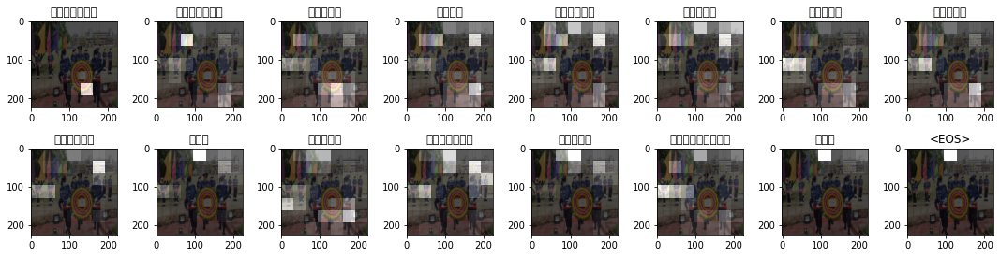

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2470 missing from current font.
  font.set_text(s

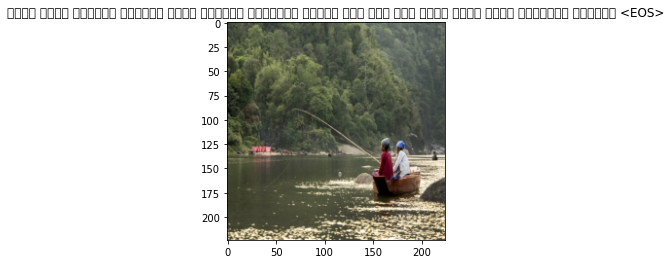

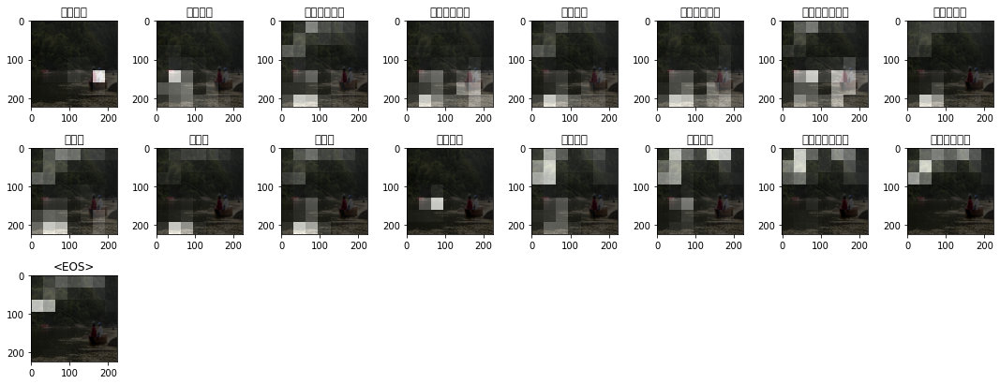

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2447 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2453 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2463 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2495 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2472 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 2470 missing from current font.
  font.set_text(s

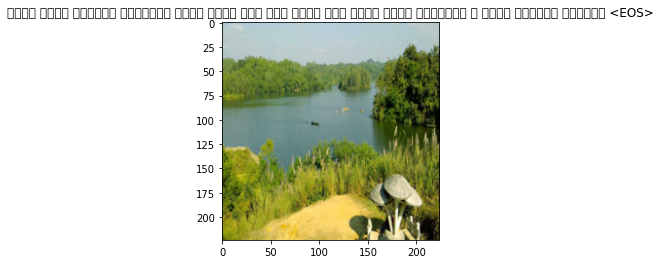

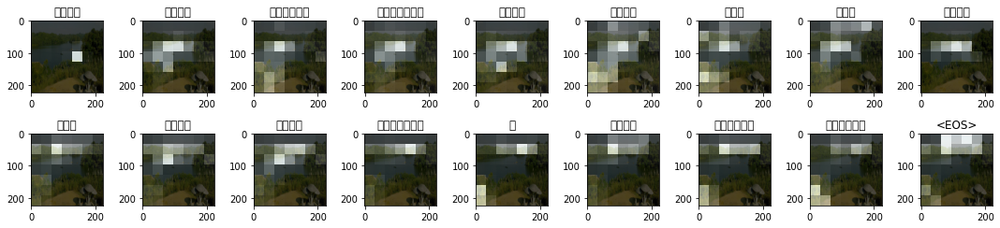

In [ ]:
#show any 1
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()
caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

Sat Jul 10 20:12:02 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   74C    P0    33W /  70W |   2604MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import numpy as np

print(np.random.seed(42))

None
